In [4]:
!pip install imutils

  Preparing metadata (setup.py) ... done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25861 sha256=86641f0cb7c75b7bcd0e24e6863c74b2e10f5de3424d7ae80913da0c7d0355ca
  Stored in directory: /root/.cache/pip/wheels/35/e4/69/cb99d996d14a2971b79b990d68b05a17d58ce530ff96090dfc
Successfully built imutils


In [5]:
import sys
sys.path.append('../input/imutils-054/imutils-0.5.4')

In [6]:
import imutils
import os
import cv2
import datetime
import numpy as np

import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.models import load_model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dropout
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelBinarizer

import pickle

In [7]:
#Initialize variables
data = []
labels = []
bboxes = []
imagePaths = []

In [8]:
classes = ["airplane", "bird", "drone", "helicopter"]

In [9]:

import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np
csv_metadata_paths = os.listdir("/kaggle/input/samplepes/TDL_new_dataset/Training_Dataset_csv")
video_data_paths = os.listdir("/kaggle/input/samplepes/TDL_new_dataset/Training_Dataset_videos")
video_data_folder = "/kaggle/input/samplepes/TDL_new_dataset/Training_Dataset_videos"
csv_data_folder = "/kaggle/input/samplepes/TDL_new_dataset/Training_Dataset_csv"

os.mkdir("/kaggle/working/training_images_from_videos")
images_drop_folder = "/kaggle/working/training_images_from_videos"

i=0

length = len(video_data_paths)
not_done=[]
while i<length:
    try:
        #1 . get video

        video = cv2.VideoCapture(f"{video_data_folder}/{video_data_paths[i]}")

        #create folder for images to be dropped into 

        drop_images_in_subfolder = f"/kaggle/working/training_images_from_videos/{video_data_paths[i][:-4]}"
        os.mkdir(drop_images_in_subfolder)
        # 2. get fps
        fps = video.get(cv2.CAP_PROP_FPS)

        # 3. get images times
        df = pd.read_csv(f"{csv_data_folder}/{str(csv_metadata_paths[i])}")
        times=list(df.iloc[:,0])
        length = len(times)
        j=0
        while j<length:
            element = times[j]
            times[j] = element[1:-5]
            times[j] = float(times[j])
            j = j+1

        # frame ids of the required times are:
        frameids = []

        for element in times:

            frame_id = int(fps*element)
            frameids.append(frame_id)

        frameids = np.unique(frameids)
        # extracting the frame from the video

        for frame in frameids:
            video.set(cv2.CAP_PROP_POS_FRAMES, frame)
            ret, required_frame = video.read()
            cv2.imwrite(f'{drop_images_in_subfolder}/{frame}.png', required_frame)

        i=i+1
    except:
        not_done.append(i)
        i=i+1

In [106]:
import os
import shutil
import csv

class_dictionary = {'airplane':0, 'bird':1, 'drone':2, 'helicopter':3}
allimagefiles = os.listdir("/kaggle/working/training_images_from_videos")

os.mkdir("bird")
os.mkdir("airplane")
os.mkdir("drone")
os.mkdir("helicopter")
open('res_bird.txt', 'w')
open('res_airplane.txt', 'w')
open('res_drone.txt', 'w')
open('res_helicopter.txt', 'w')

i=-1
airplane_iter = 1
bird_iter = 1
drone_iter = 1
helicopter_iter = 1
for element in allimagefiles:
    i=i+1
    file = f"/kaggle/working/training_images_from_videos/{element}"
    images = os.listdir(file)
    csv_file = csv_file = "/kaggle/input/samplepes/TDL_new_dataset/Training_Dataset_csv/"+element+"_LABELS.csv"
    with open(csv_file) as file_obj:
        reader_obj = csv.reader(file_obj)
        curr = 0

        if "BIRD" in element  :
            ind = -1
            for row in reader_obj:
                ind+=1
                if(ind<len(images)):
                    shutil.copy(f"/kaggle/working/training_images_from_videos/{element}/{images[ind]}",f"bird/{str(bird_iter).zfill(5)}.png")
                    objs = row[2].split(";")
                    for obj in objs:
#                         print(obj)
                        obj = obj.strip("[]").split(",")
                        if(len(obj)==4):
                            obj = [float(x.strip()) for x in obj]
                            obj[-2] = obj[-2]+obj[0]
                            obj[-1] = obj[-1]+obj[1]
                            obj.insert(0,f"annotation_{str(bird_iter).zfill(5)}.mat")
                            bird_iter+=1
                            file1 = open("/kaggle/working/res_bird.txt", "a") 
                            one, two, three, four, five = obj
                            file1.write(f"{one},{two},{three},{four},{five}\n")
                            file1.close()


        if "AIRPLANE" in element:

            ind = -1
            for row in reader_obj:
                ind+=1
                if(ind<len(images)):
                    shutil.copy(f"/kaggle/working/training_images_from_videos/{element}/{images[ind]}",f"airplane/{str(airplane_iter).zfill(5)}.png")
                    objs = row[1].split(";")
                    for obj in objs:
#                         print(obj)
                        obj = obj.strip("[]").split(",")
                        if(len(obj)==4):
                            obj = [float(x.strip()) for x in obj]
                            obj[-2] = obj[-2]+obj[0]
                            obj[-1] = obj[-1]+obj[1]
                            obj.insert(0,f"annotation_{str(airplane_iter).zfill(5)}.mat")
                            airplane_iter+=1
                            file1 = open("/kaggle/working/res_airplane.txt", "a") 
                            one, two, three, four, five = obj
                            file1.write(f"{one},{two},{three},{four},{five}\n")
                            file1.close()



        if "DRONE" in element:

            ind = 1
            for row in reader_obj:
                ind+=1
                if(ind<len(images)):
                    shutil.copy(f"/kaggle/working/training_images_from_videos/{element}/{images[ind]}",f"drone/{str(drone_iter).zfill(5)}.png")
                    objs = row[3].split(";")
                    for obj in objs:
#                         print(obj)
                        obj = obj.strip("[]").split(",")
                        obj = [float(x.strip()) for x in obj]
                        if(len(obj)==4):
                            obj[-2] = obj[-2]+obj[0]
                            obj[-1] = obj[-1]+obj[1]
                            obj.insert(0,f"annotation_{str(drone_iter).zfill(5)}.mat")
                            drone_iter+=1
                            file1 = open("/kaggle/working/res_drone.txt", "a") 
                            one, two, three, four, five = obj
                            file1.write(f"{one},{two},{three},{four},{five}\n")
                            file1.close()



        if "HELI" in element:
            ind = -1
            for row in reader_obj:
                ind+=1
                if(ind<len(images)):
                    shutil.copy(f"/kaggle/working/training_images_from_videos/{element}/{images[ind]}",f"helicopter/{str(helicopter_iter).zfill(5)}.png")
                    objs = row[4].split(";")
                    for obj in objs:
#                         print(obj)
                        obj = obj.strip("[]").split(",")
                        if(len(obj)==4):
                            obj = [float(x.strip()) for x in obj]
                            obj[-2] = obj[-2]+obj[0]
                            obj[-1] = obj[-1]+obj[1]
                            obj.insert(0,f"annotation_{str(helicopter_iter).zfill(5)}.mat")
                            helicopter_iter+=1
                            file1 = open("/kaggle/working/res_helicopter.txt", "a") 
                            one, two, three, four, five = obj
                            file1.write(f"{one},{two},{three},{four},{five}\n")
                            file1.close()

In [39]:
from PIL import ImageOps
from PIL import Image

# Function to Display Image
def display_image(image,file):
    fig = plt.figure(figsize=(15, 10))
    plt.grid(False)
    plt.imshow(image)
    plt.title(file, fontsize=20)

    
# Function to Resize Image
def resize_image(img_path, new_width=300, new_height=300,display=False):
    pil_image = Image.open(img_path)
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
    pil_image_rgb = pil_image.convert("RGB")
    if display:
        display_image(pil_image, img_path)

In [ ]:
resize_image("/kaggle/working/airplane/4036.png",600,400,True)

In [105]:
# shutil.rmtree("/kaggle/working/airplane")
# shutil.rmtree("/kaggle/working/bird")
# shutil.rmtree("/kaggle/working/drone")
# shutil.rmtree("/kaggle/working/helicopter")
# os.remove("/kaggle/working/res_airplane.txt")
# os.remove("/kaggle/working/res_bird.txt")
# os.remove("/kaggle/working/res_drone.txt")
# os.remove("/kaggle/working/res_helicopter.txt")

In [112]:
sorted(os.listdir("/kaggle/working/airplane"))[-1]

'02467.png'

In [113]:
# with open('/kaggle/working/res_airplane.txt') as f:
#     lines = f.readlines()
# for line in lines:
#     print(line)

In [115]:
ann_path = "/kaggle/working/res_"
images_path = "/kaggle/working"

In [116]:
classes = ["airplane", "bird", "drone", "helicopter"]

In [125]:
for cl in classes:
    ann_path_new = ann_path + cl + ".txt"
    print(ann_path_new)
    rows = open(ann_path_new).read().strip().split("\n")
    
    # loop over the rows
    for idx, row in enumerate(rows):
        
        # break the row into the 
        # filename and bounding box coordinates
        row = row.split(",")
        
        filename = row[0]
        filename = filename.split(".")[0]
        filename = filename.split("_")[-1]
        filename = filename + ".png"
        print(filename)
        
        coords = row[1:]
        coords = [float(c) for c in coords]
        
        label = cl
        
        image_path = os.path.sep.join([images_path, cl, filename])
        
        if image:
            image = cv2.imread(image_path)
            (h, w) = image.shape[:2]

            Xmin = coords[0] / w
            Ymin = coords[1] / h
            Xmax = coords[2] / w
            Ymax = coords[3] / h


            # load the image
            image = load_img(image_path, target_size=(224, 224))
            image = img_to_array(image)

            data.append(image)
            labels.append(label)
            bboxes.append((Xmin, Ymin, Xmax, Ymax))
            imagePaths.append(image_path)

/kaggle/working/res_airplane.txt
00001.png
00002.png
00003.png
00004.png
00005.png
00006.png
00007.png
00008.png
00009.png
00010.png
00011.png
00012.png
00013.png
00014.png
00015.png
00016.png
00017.png
00018.png
00019.png
00020.png
00021.png
00022.png
00023.png
00024.png
00025.png
00026.png
00027.png
00028.png
00029.png
00030.png
00031.png
00032.png
00033.png
00034.png
00035.png
00036.png
00037.png
00038.png
00039.png
00040.png
00041.png
00042.png
00043.png
00044.png
00045.png
00046.png
00047.png
00048.png
00049.png
00050.png
00051.png
00052.png
00053.png
00054.png
00055.png
00056.png
00057.png
00058.png
00059.png
00060.png
00061.png
00062.png
00063.png
00064.png
00065.png
00066.png
00067.png
00068.png
00069.png
00070.png
00071.png
00072.png
00073.png
00074.png
00075.png
00076.png
00077.png
00078.png
00079.png
00080.png
00081.png
00082.png
00083.png
00084.png
00085.png
00086.png
00087.png
00088.png
00089.png
00090.png
00091.png
00092.png
00093.png
00094.png
00095.png
00096.png
00097.p

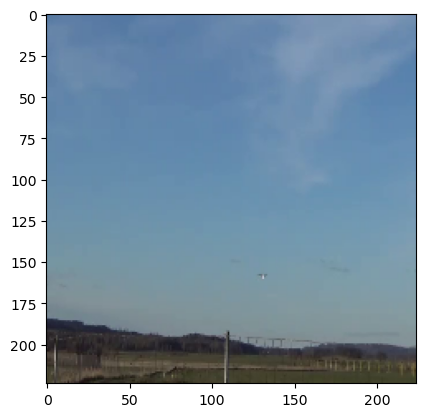

In [126]:
# show the output image
image = load_img("/kaggle/working/airplane/00001.png", target_size=(224, 224))
image = img_to_array(image)
imgplot = plt.imshow(image.astype('uint8'))
plt.show()

In [127]:
#Data Preparation
# convert from the range [0, 255] to [0, 1]
data = np.array(data, dtype="float32") / 255.0

# convert to numpy array
labels = np.array(labels)
bboxes = np.array(bboxes, dtype="float32")
imagePaths = np.array(imagePaths)

In [128]:
# one-hot encoding on the labels
lb = LabelBinarizer()
labels = lb.fit_transform(labels)

In [129]:
if len(lb.classes_) == 2:
    print("two classes")
    labels = to_categorical(labels)

two classes


In [130]:
split = train_test_split(data,
                         labels,
                         bboxes,
                         imagePaths,
                         test_size=0.20,
                         random_state=42)

In [131]:
(trainImages, testImages) = split[:2]
(trainLabels, testLabels) = split[2:4]
(trainBBoxes, testBBoxes) = split[4:6]
(trainPaths, testPaths) = split[6:]

In [132]:
f = open("testing_multiclass.txt", "w")
f.write("\n".join(testPaths))
f.close()

In [133]:
#Neural Network Architecture
vgg = VGG16(weights="imagenet",
            include_top=False,
            input_tensor=Input(shape=(224, 224, 3)))

58889256/58889256 [==============================] - 2s 0us/step


In [134]:
vgg.trainable = False

In [135]:
flatten = vgg.output
flatten = Flatten()(flatten)

In [136]:
bboxHead = Dense(128, activation="relu")(flatten)
bboxHead = Dense(64, activation="relu")(bboxHead)
bboxHead = Dense(32, activation="relu")(bboxHead)
bboxHead = Dense(4, activation="sigmoid", name="bounding_box")(bboxHead)

In [137]:
softmaxHead = Dense(512, activation="relu")(flatten)
softmaxHead = Dropout(0.5)(softmaxHead)
softmaxHead = Dense(512, activation="relu")(softmaxHead)
softmaxHead = Dropout(0.5)(softmaxHead)
softmaxHead = Dense(len(lb.classes_), activation="softmax", name="class_label")(softmaxHead)

In [138]:
model = Model(
    inputs=vgg.input,
    outputs=(bboxHead, softmaxHead))

In [149]:
INIT_LR = 1e-4
NUM_EPOCHS = 5
BATCH_SIZE = 32

In [140]:
losses = {
    "class_label": "categorical_crossentropy",
    "bounding_box": "mean_squared_error",
}

In [142]:
lossWeights = {
    "class_label": 1.0,
    "bounding_box": 1.0
}

In [143]:
trainTargets = {
    "class_label": trainLabels,
    "bounding_box": trainBBoxes
}

In [144]:
testTargets = {
    "class_label": testLabels,
    "bounding_box": testBBoxes
}

In [145]:
opt = Adam(INIT_LR)

model.compile(loss=losses, 
              optimizer=opt, 
              metrics=["accuracy"], 
              loss_weights=lossWeights)

print(model.summary())

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 224, 224, 64  36928       ['block1_conv1[0][0]']           
                                )                                                             

In [150]:
#Training the neural network
H = model.fit(
    trainImages, trainTargets,
    validation_data=(testImages, testTargets),
    batch_size=BATCH_SIZE,
    epochs=NUM_EPOCHS,
    verbose=1)

Epoch 1/5
68/68 [==============================] - 712s 10s/step - loss: 0.0253 - bounding_box_loss: 0.0104 - class_label_loss: 0.0149 - bounding_box_accuracy: 0.7584 - class_label_accuracy: 0.9954 - val_loss: 0.0123 - val_bounding_box_loss: 0.0103 - val_class_label_loss: 0.0020 - val_bounding_box_accuracy: 0.7161 - val_class_label_accuracy: 1.0000
Epoch 2/5
68/68 [==============================] - 719s 11s/step - loss: 0.0160 - bounding_box_loss: 0.0096 - class_label_loss: 0.0064 - bounding_box_accuracy: 0.7737 - class_label_accuracy: 0.9986 - val_loss: 0.0101 - val_bounding_box_loss: 0.0094 - val_class_label_loss: 6.3919e-04 - val_bounding_box_accuracy: 0.7699 - val_class_label_accuracy: 1.0000
Epoch 3/5
68/68 [==============================] - 727s 11s/step - loss: 0.0120 - bounding_box_loss: 0.0099 - class_label_loss: 0.0021 - bounding_box_accuracy: 0.7495 - class_label_accuracy: 1.0000 - val_loss: 0.0099 - val_bounding_box_loss: 0.0096 - val_class_label_loss: 2.4735e-04 - val_boun

In [151]:
model.save("model_bbox_regression_and_classification", save_format="h5")

In [152]:
f = open("lb.pickle", "wb")
f.write(pickle.dumps(lb))
f.close()

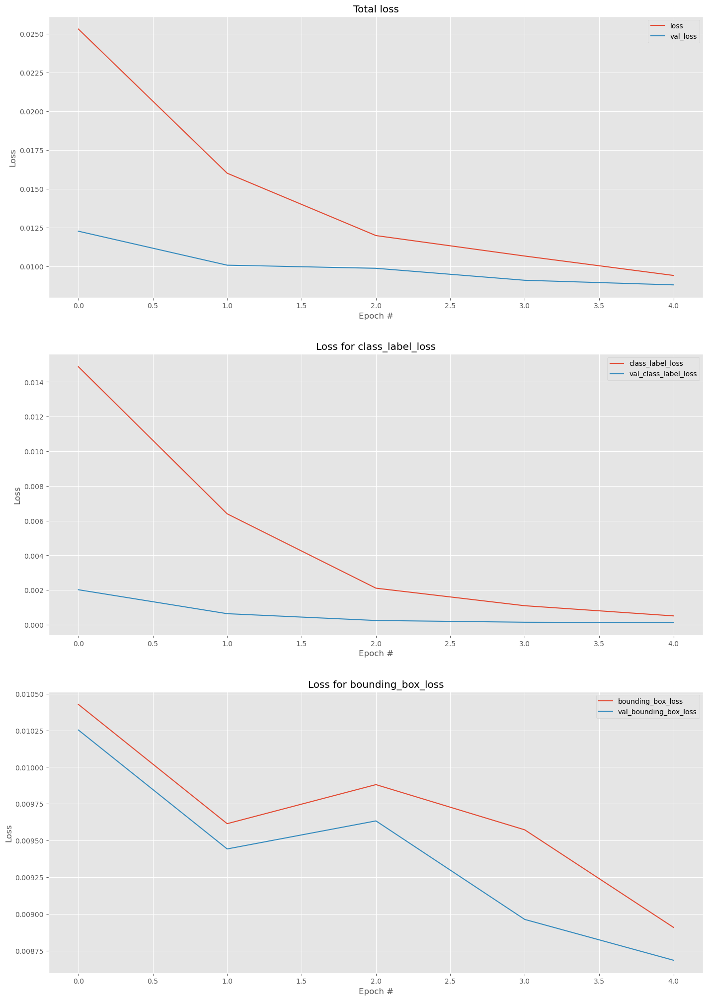

In [153]:
lossNames = ["loss", 
             "class_label_loss", 
             "bounding_box_loss"]

N = np.arange(0, NUM_EPOCHS)
plt.style.use("ggplot")
(fig, ax) = plt.subplots(3, 1, figsize=(17, 25))

# loop over the loss names
for (i, l) in enumerate(lossNames):
    # plot the loss for both the training and validation data
    title = "Loss for {}".format(l) if l != "loss" else "Total loss"
    ax[i].set_title(title)
    ax[i].set_xlabel("Epoch #")
    ax[i].set_ylabel("Loss")
    ax[i].plot(N, H.history[l], label=l)
    ax[i].plot(N, H.history["val_" + l], label="val_" + l)
    ax[i].legend()

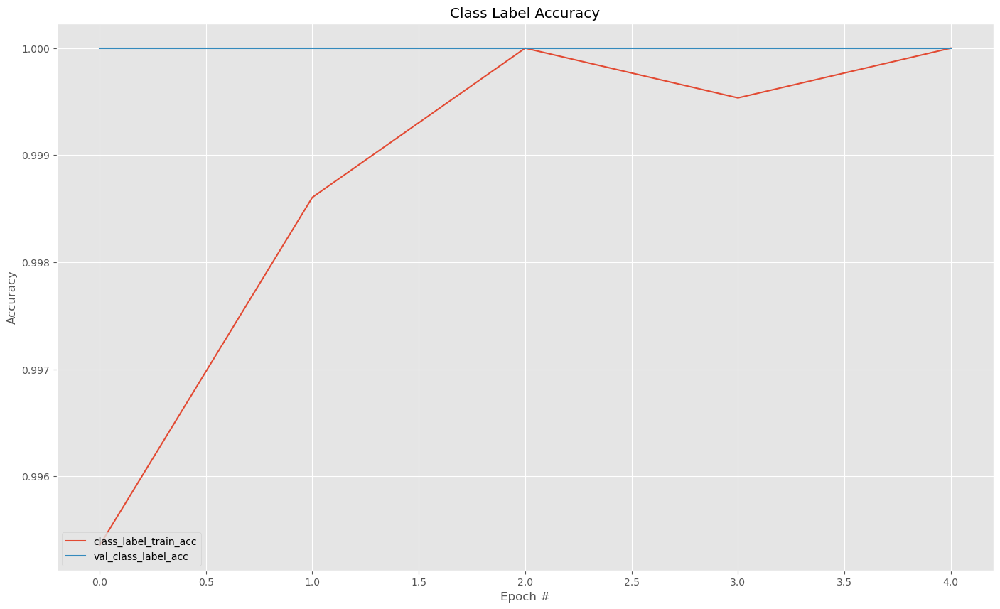

In [154]:
plt.style.use("ggplot")
plt.figure(figsize=(17, 10))

plt.plot(N, H.history["class_label_accuracy"],
         label="class_label_train_acc")
plt.plot(N, H.history["val_class_label_accuracy"],
         label="val_class_label_acc")

plt.title("Class Label Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Accuracy")
plt.legend(loc="lower left")

# save the accuracies plot
plotPath = os.path.sep.join(["accs.png"])
plt.savefig(plotPath)

In [155]:
path = "testing_multiclass.txt"
filenames = open(path).read().strip().split("\n")
imagePaths = []

for f in filenames:
    imagePaths.append(f)

In [156]:
model = load_model("./model_bbox_regression_and_classification")

In [157]:
lb = pickle.loads(open("./lb.pickle", "rb").read())

1/1 [==============================] - 1s 545ms/step


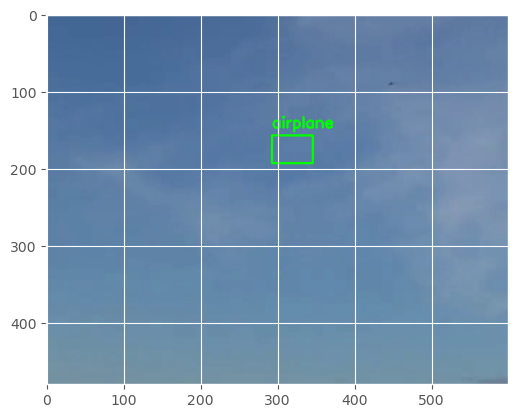

1/1 [==============================] - 0s 285ms/step


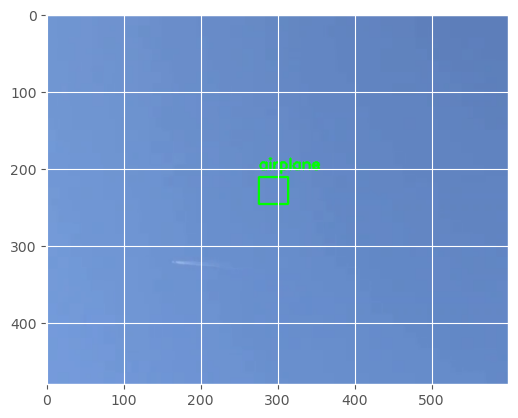

1/1 [==============================] - 0s 296ms/step


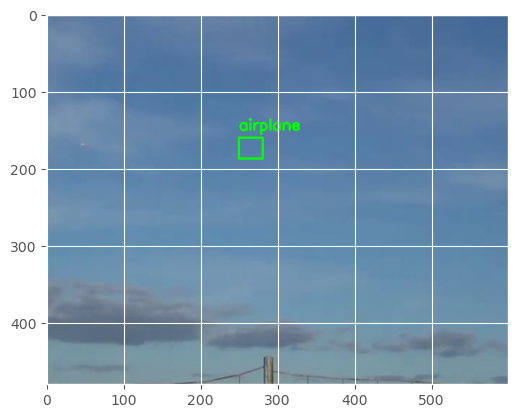

1/1 [==============================] - 0s 286ms/step


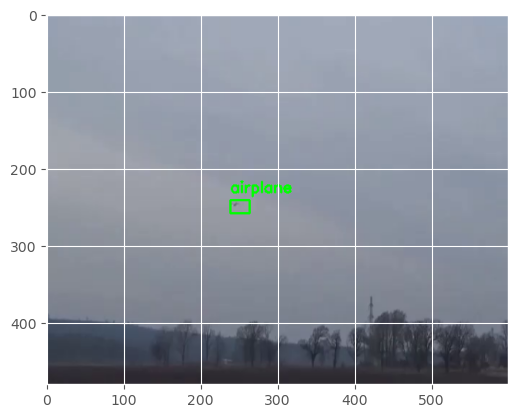

1/1 [==============================] - 0s 287ms/step


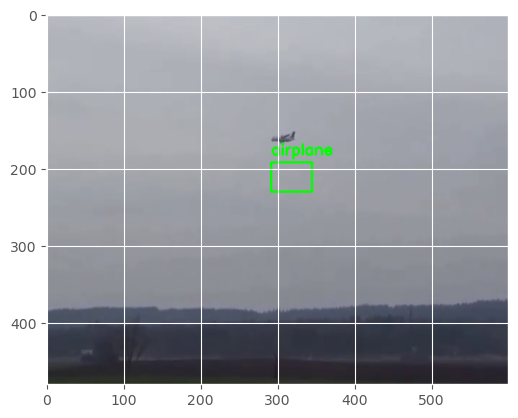

1/1 [==============================] - 0s 283ms/step


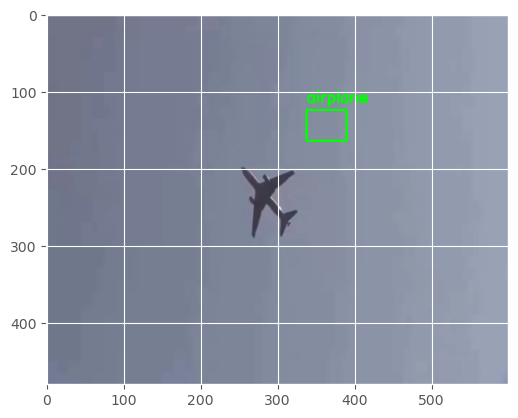

1/1 [==============================] - 0s 287ms/step


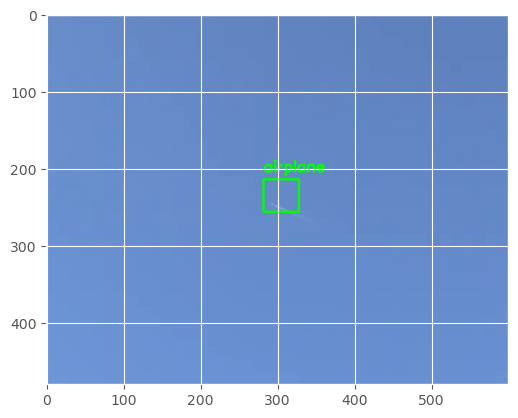

1/1 [==============================] - 0s 290ms/step


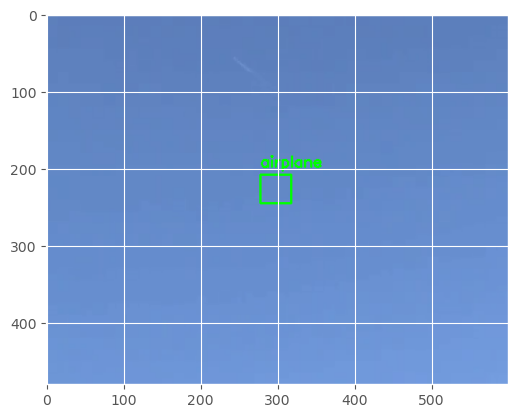

1/1 [==============================] - 0s 286ms/step


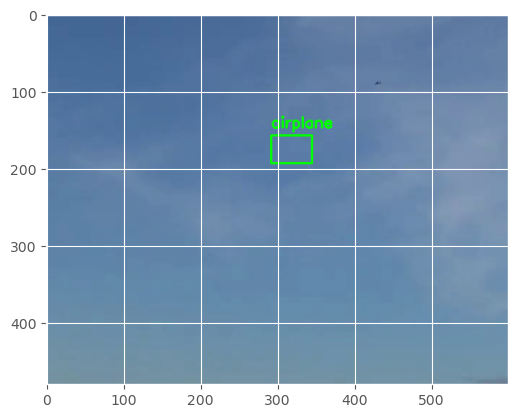

1/1 [==============================] - 0s 281ms/step


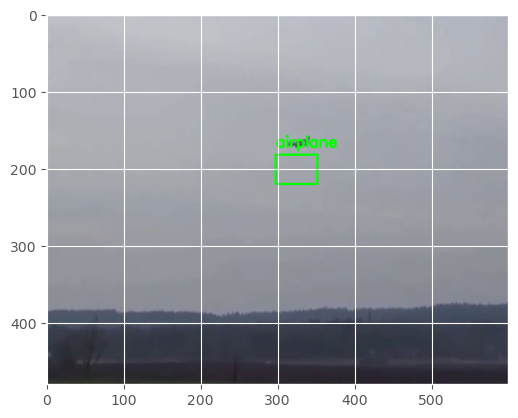

1/1 [==============================] - 0s 286ms/step


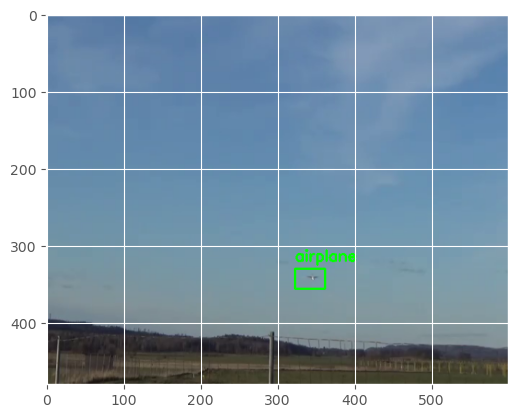

1/1 [==============================] - 0s 283ms/step


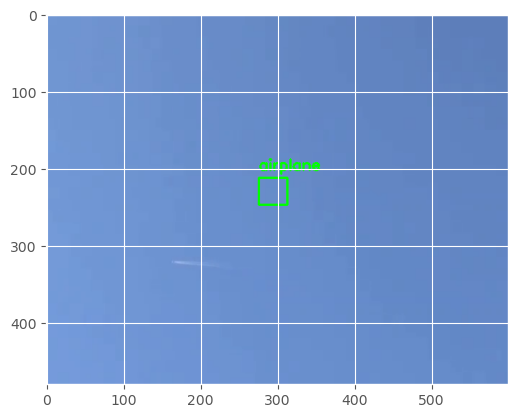

1/1 [==============================] - 0s 377ms/step


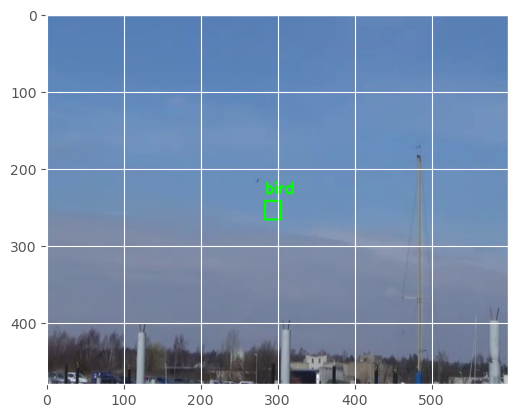

1/1 [==============================] - 0s 306ms/step


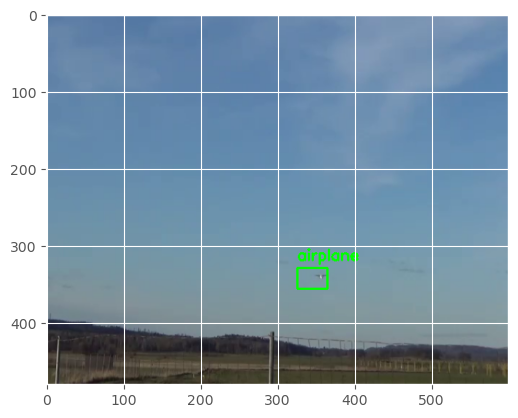

1/1 [==============================] - 0s 284ms/step


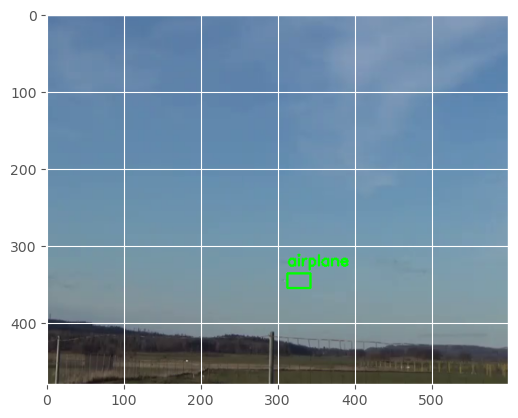

1/1 [==============================] - 0s 284ms/step


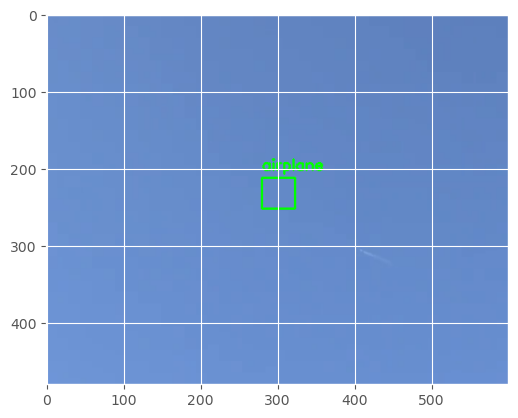

1/1 [==============================] - 0s 288ms/step


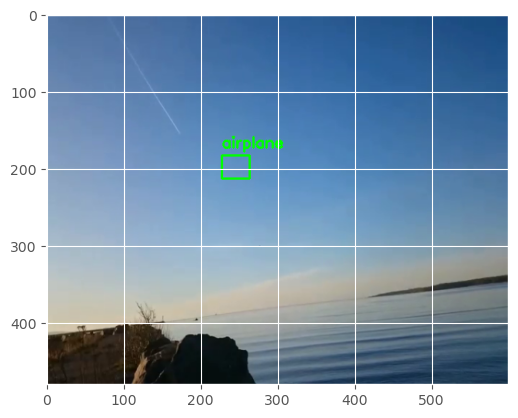

1/1 [==============================] - 0s 333ms/step


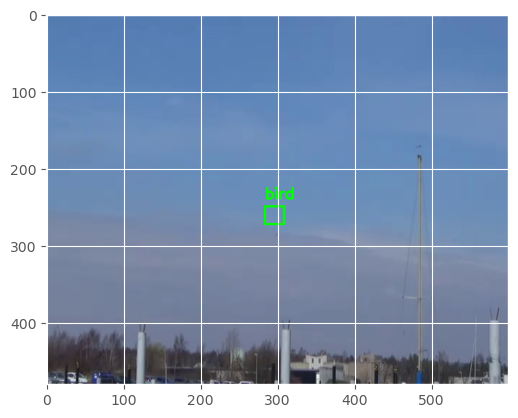

1/1 [==============================] - 0s 296ms/step


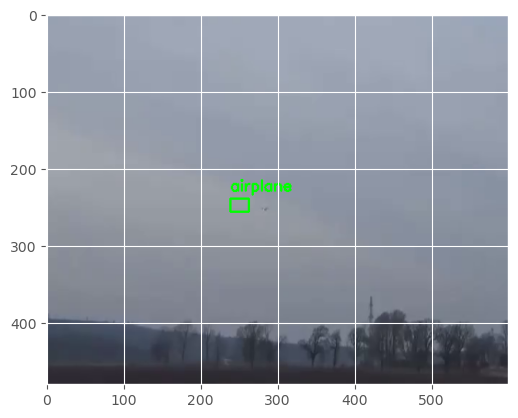

1/1 [==============================] - 0s 289ms/step


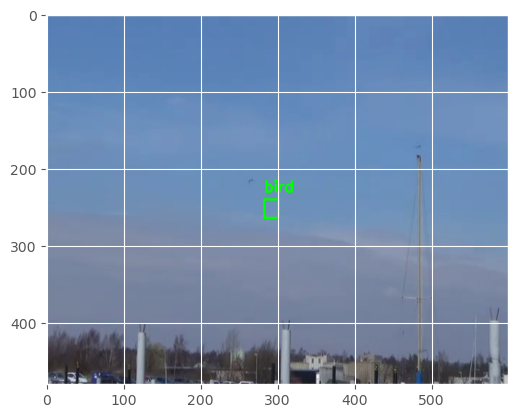

1/1 [==============================] - 0s 284ms/step


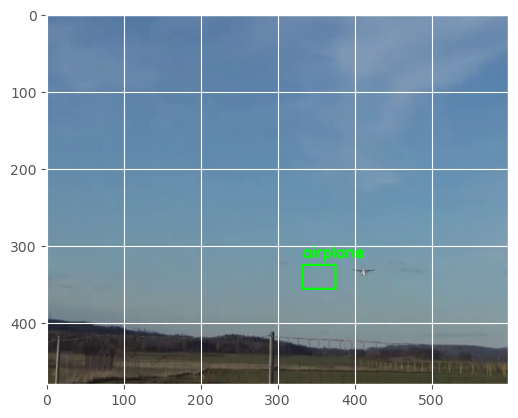

1/1 [==============================] - 0s 284ms/step


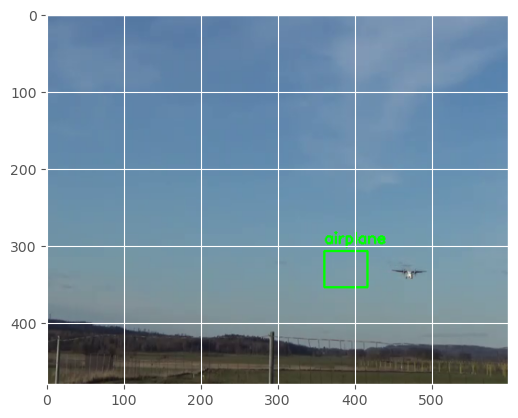

1/1 [==============================] - 0s 283ms/step


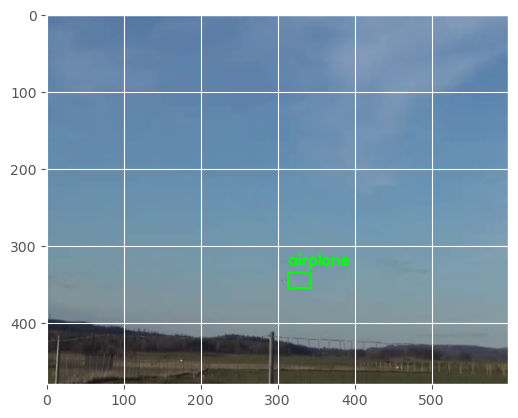

1/1 [==============================] - 0s 293ms/step


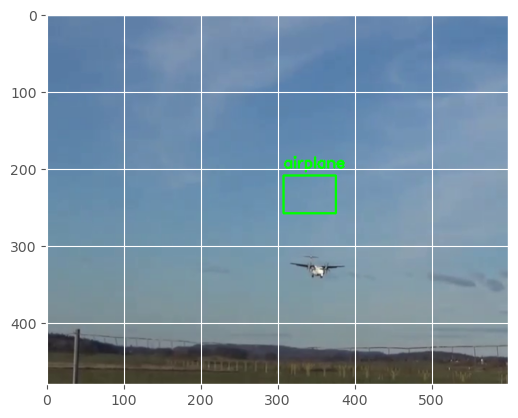

1/1 [==============================] - 0s 292ms/step


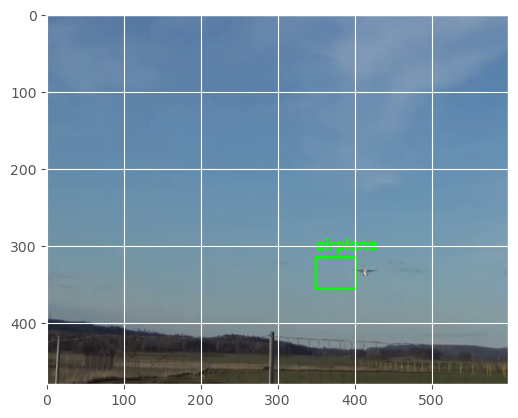

1/1 [==============================] - 0s 280ms/step


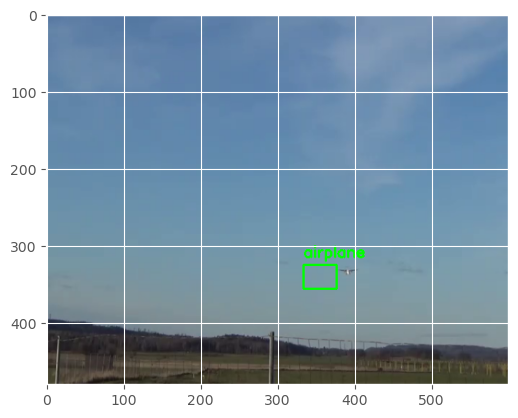

1/1 [==============================] - 0s 286ms/step


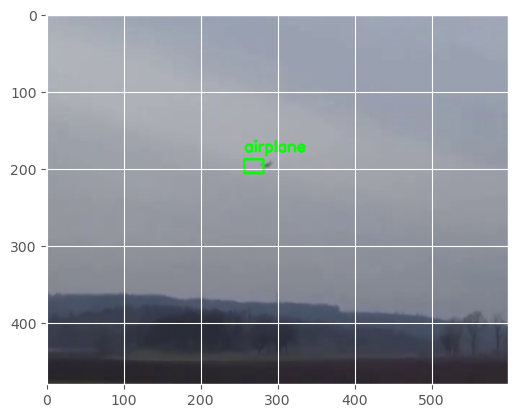

1/1 [==============================] - 0s 282ms/step


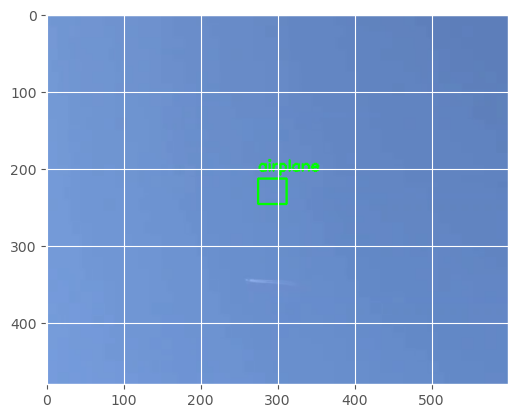

1/1 [==============================] - 0s 282ms/step


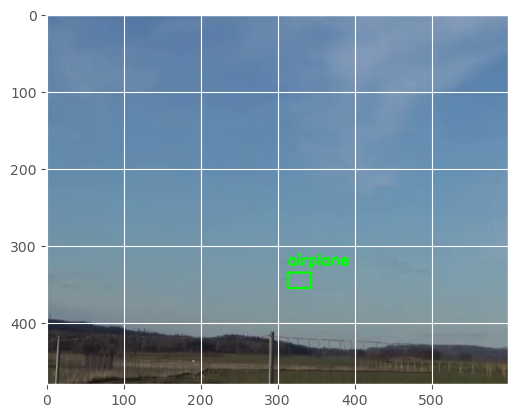

1/1 [==============================] - 0s 283ms/step


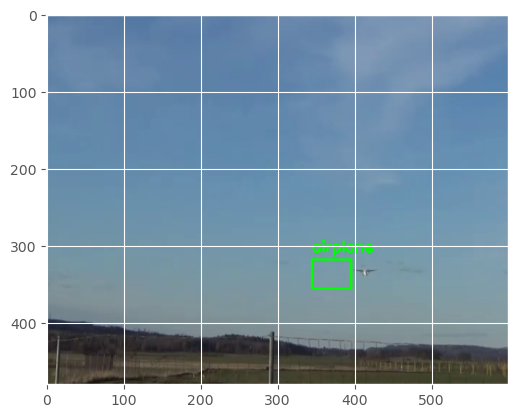

1/1 [==============================] - 0s 286ms/step


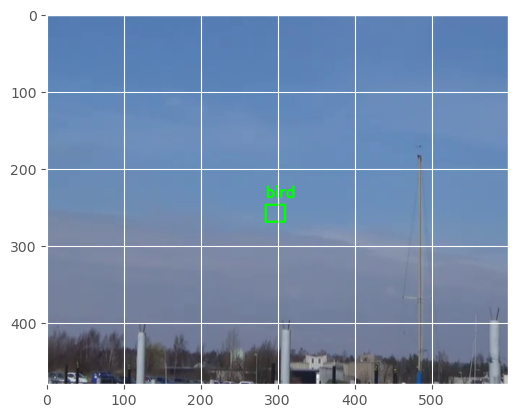

1/1 [==============================] - 0s 285ms/step


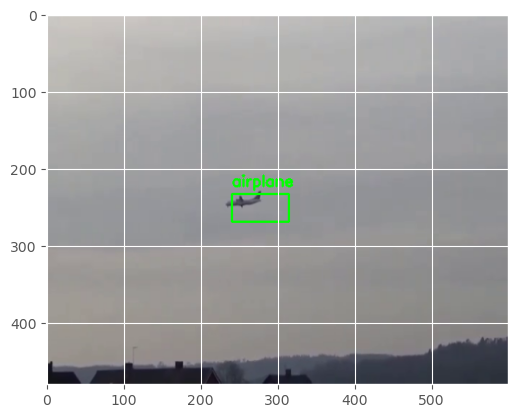

1/1 [==============================] - 0s 283ms/step


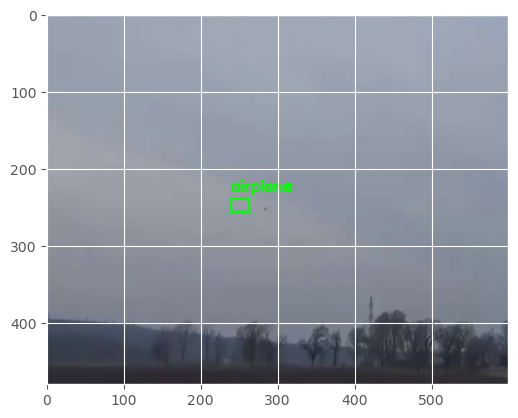

1/1 [==============================] - 0s 288ms/step


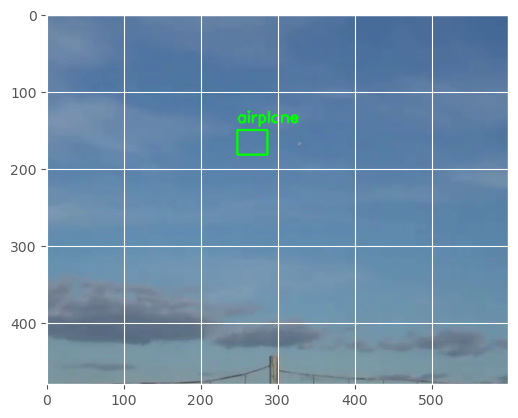

1/1 [==============================] - 0s 284ms/step


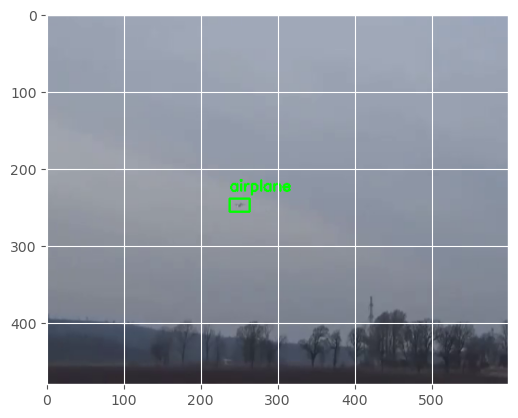

1/1 [==============================] - 0s 294ms/step


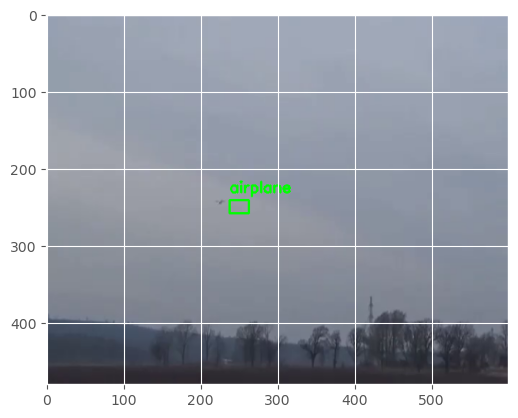

1/1 [==============================] - 0s 285ms/step


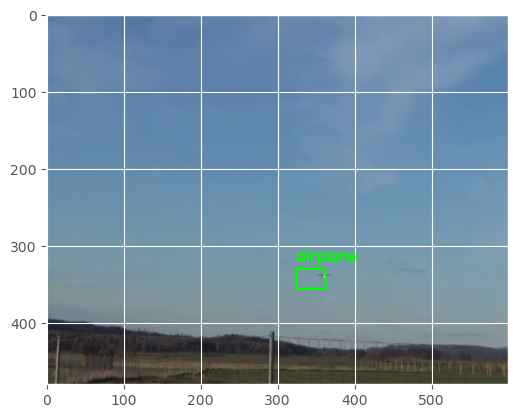

1/1 [==============================] - 0s 290ms/step


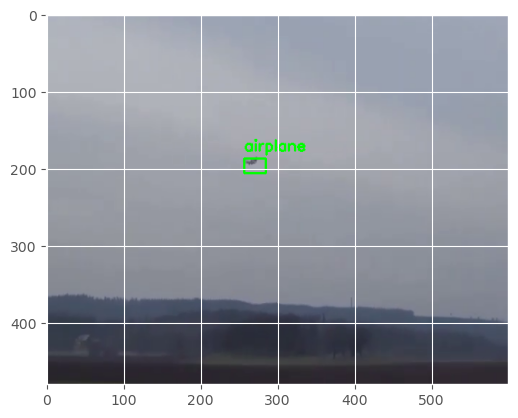

1/1 [==============================] - 0s 284ms/step


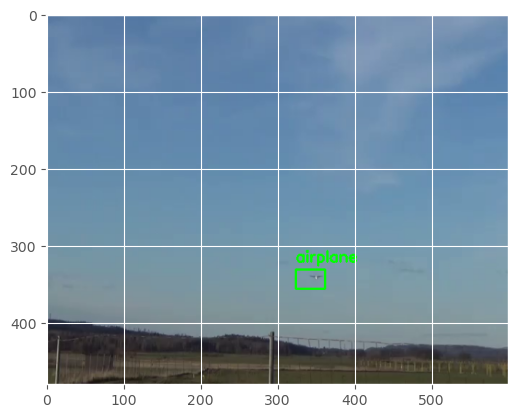

1/1 [==============================] - 0s 286ms/step


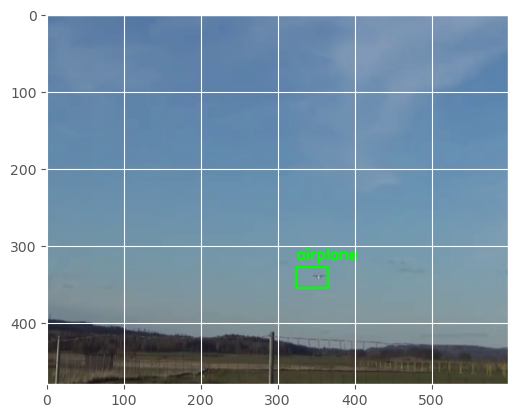

1/1 [==============================] - 0s 287ms/step


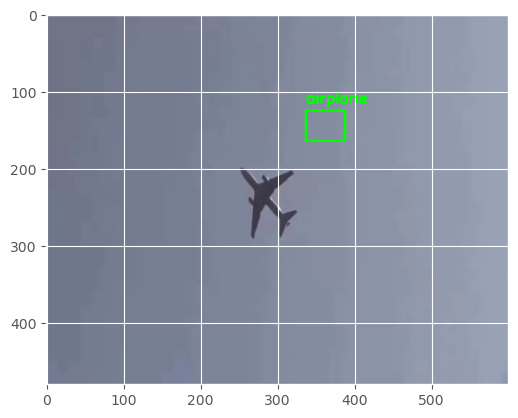

1/1 [==============================] - 0s 280ms/step


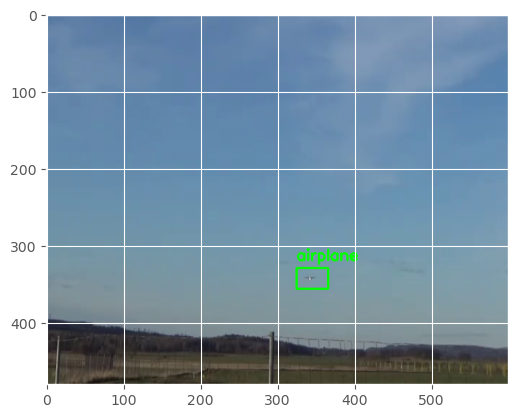

1/1 [==============================] - 0s 278ms/step


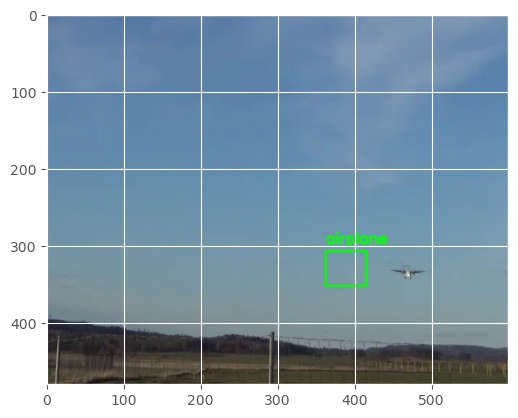

1/1 [==============================] - 0s 280ms/step


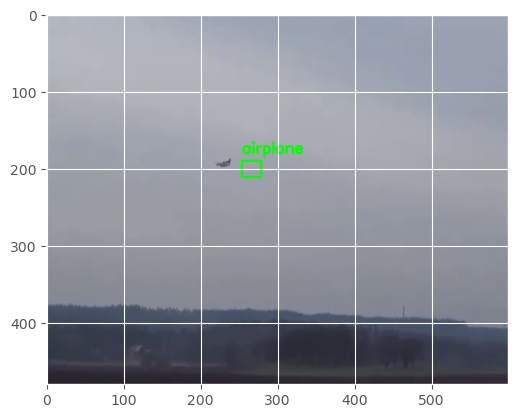

1/1 [==============================] - 0s 283ms/step


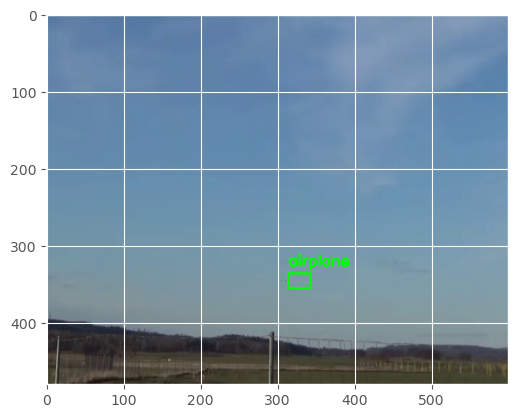

1/1 [==============================] - 0s 285ms/step


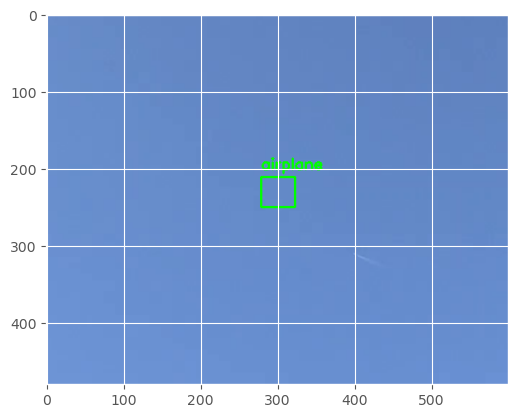

1/1 [==============================] - 0s 289ms/step


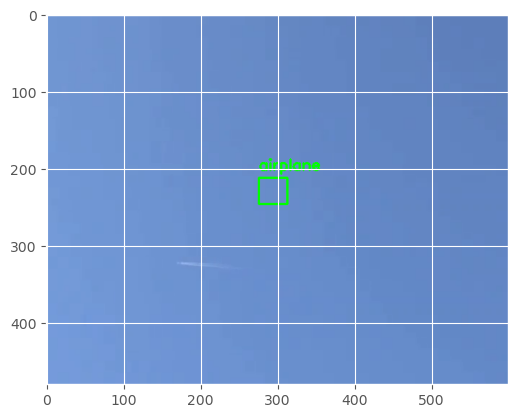

1/1 [==============================] - 0s 283ms/step


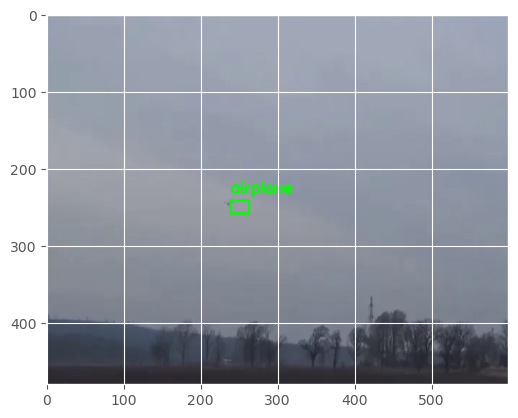

1/1 [==============================] - 0s 274ms/step


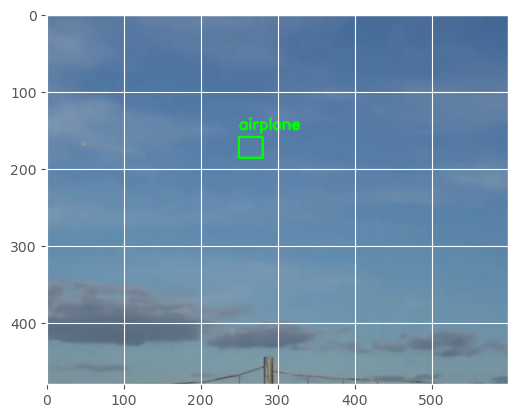

1/1 [==============================] - 0s 295ms/step


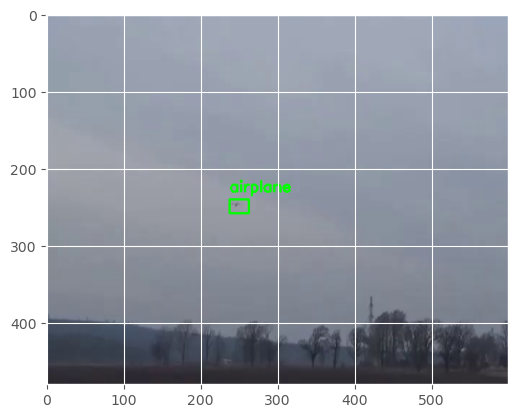

1/1 [==============================] - 0s 287ms/step


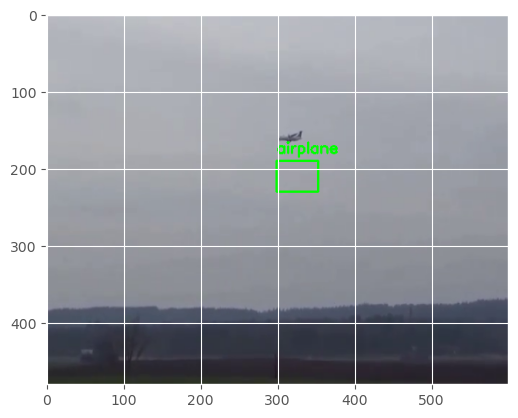

1/1 [==============================] - 0s 288ms/step


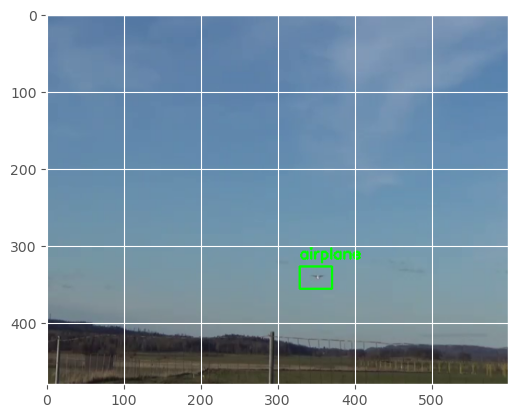

1/1 [==============================] - 0s 291ms/step


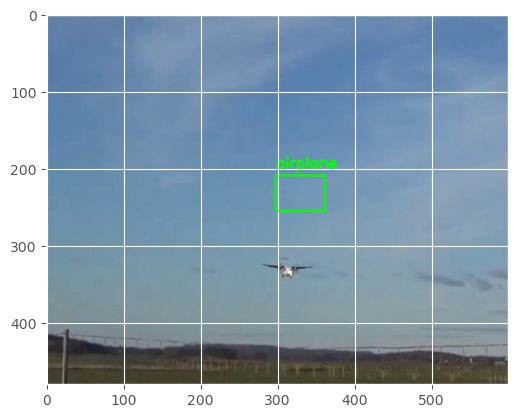

1/1 [==============================] - 0s 288ms/step


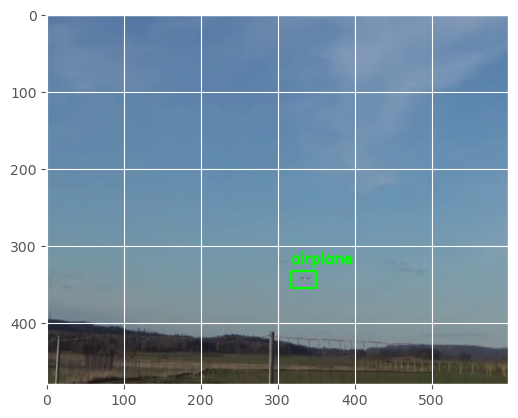

1/1 [==============================] - 0s 286ms/step


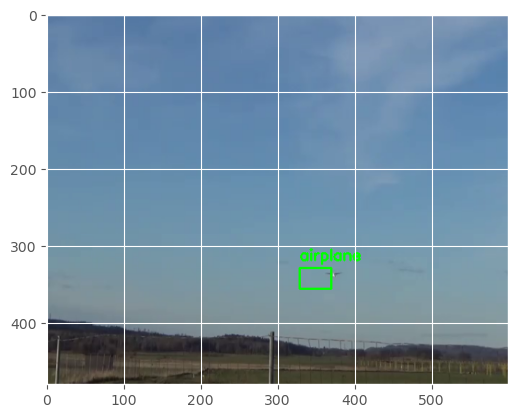

1/1 [==============================] - 0s 289ms/step


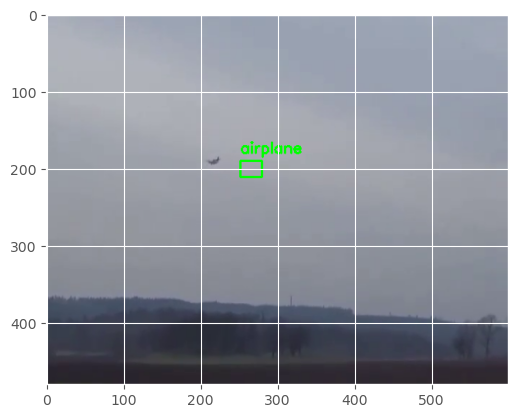

1/1 [==============================] - 0s 294ms/step


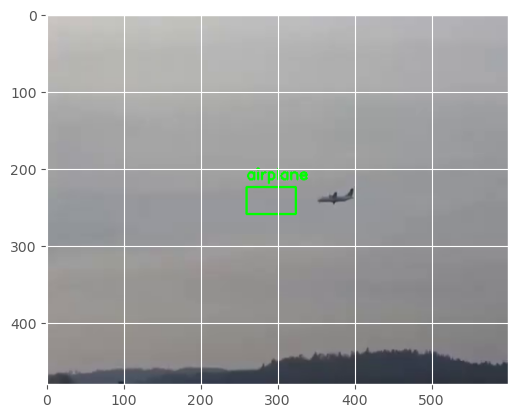

1/1 [==============================] - 0s 289ms/step


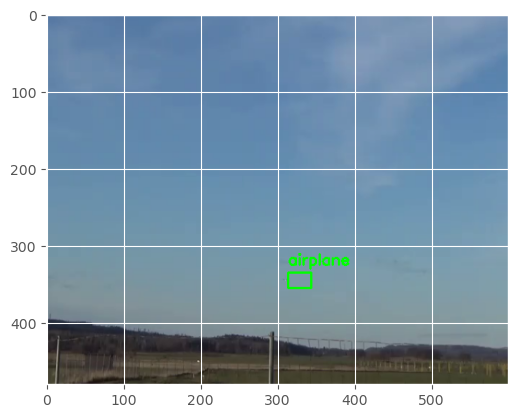

1/1 [==============================] - 0s 287ms/step


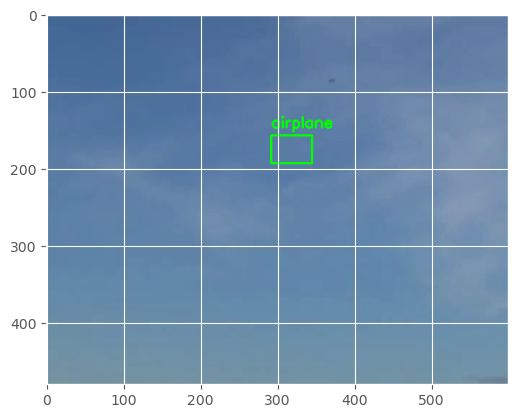

1/1 [==============================] - 0s 286ms/step


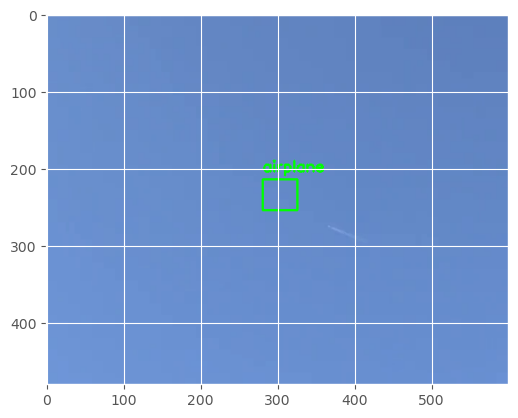

1/1 [==============================] - 0s 292ms/step


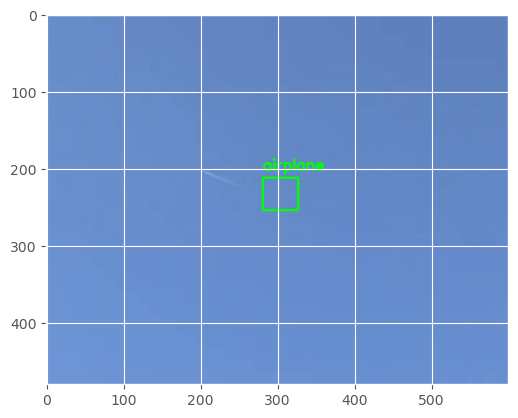

1/1 [==============================] - 0s 388ms/step


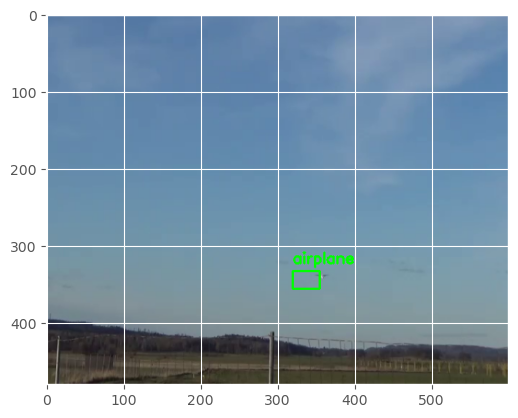

1/1 [==============================] - 0s 372ms/step


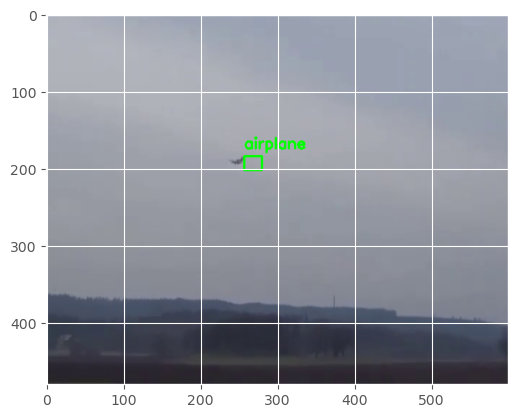

1/1 [==============================] - 0s 285ms/step


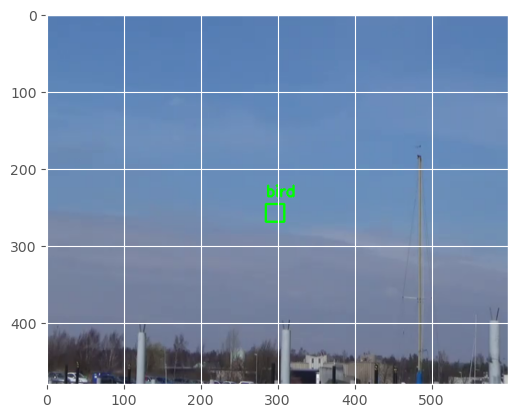

1/1 [==============================] - 0s 292ms/step


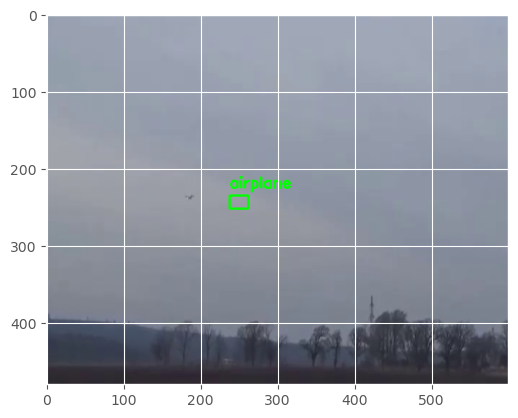

1/1 [==============================] - 0s 280ms/step


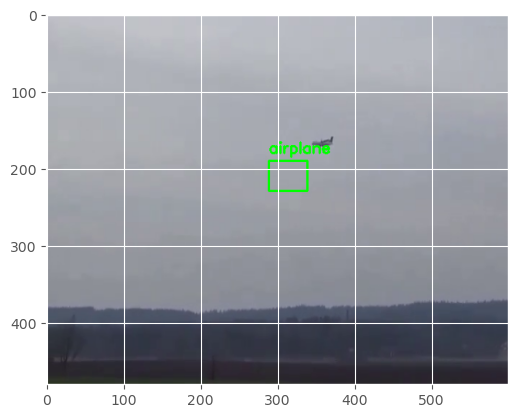

1/1 [==============================] - 0s 284ms/step


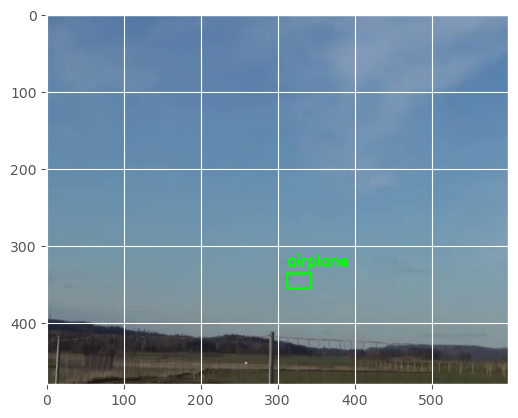

1/1 [==============================] - 0s 285ms/step


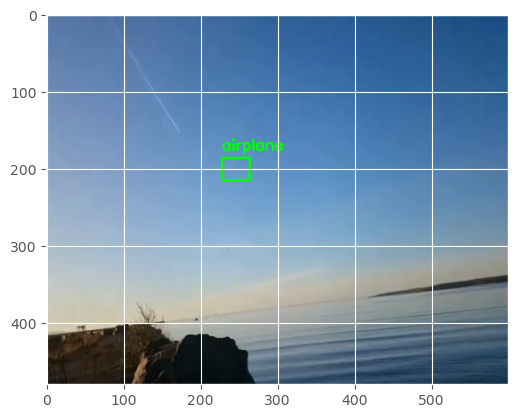

1/1 [==============================] - 0s 288ms/step


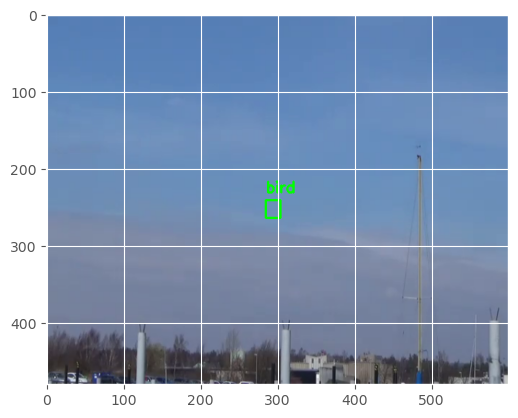

1/1 [==============================] - 0s 316ms/step


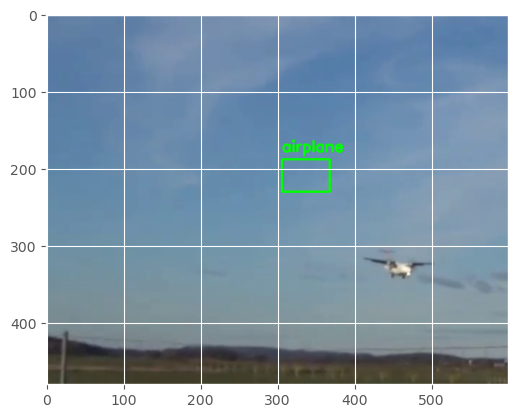

1/1 [==============================] - 0s 284ms/step


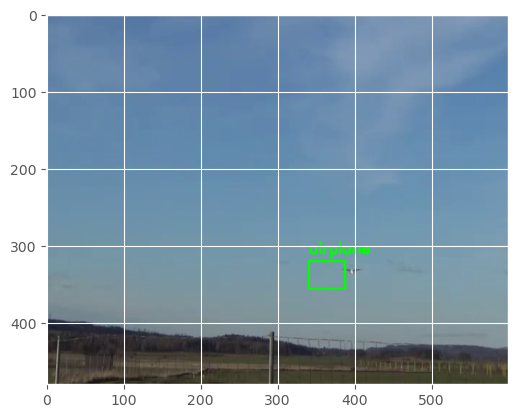

1/1 [==============================] - 0s 284ms/step


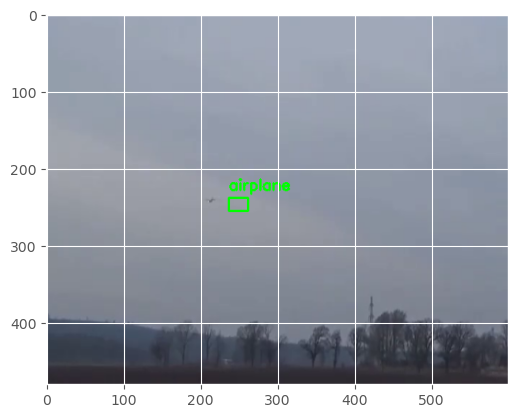

1/1 [==============================] - 0s 283ms/step


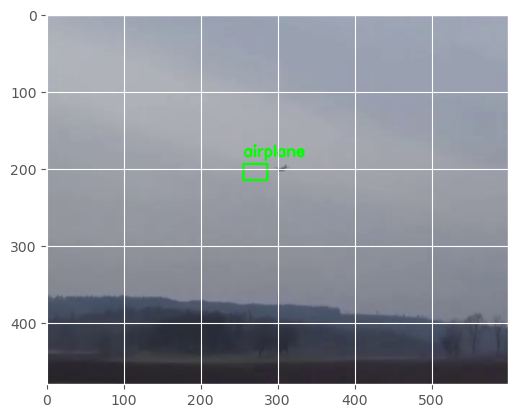

1/1 [==============================] - 0s 287ms/step


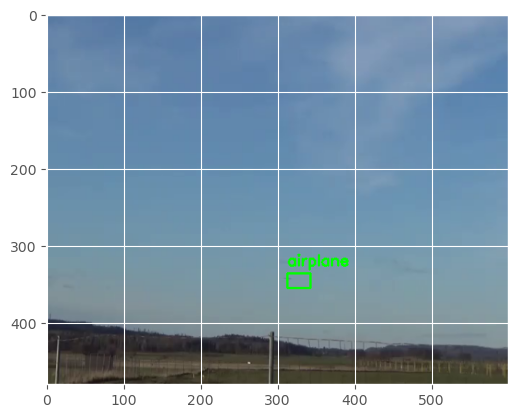

1/1 [==============================] - 0s 284ms/step


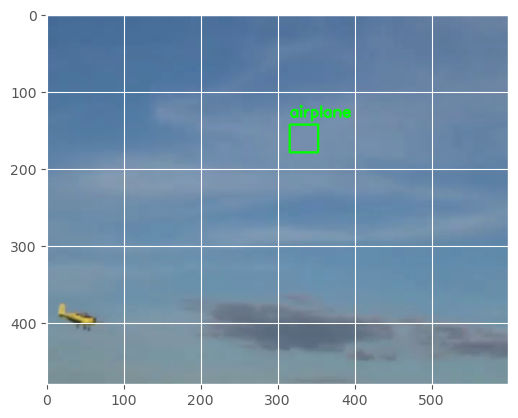

1/1 [==============================] - 0s 283ms/step


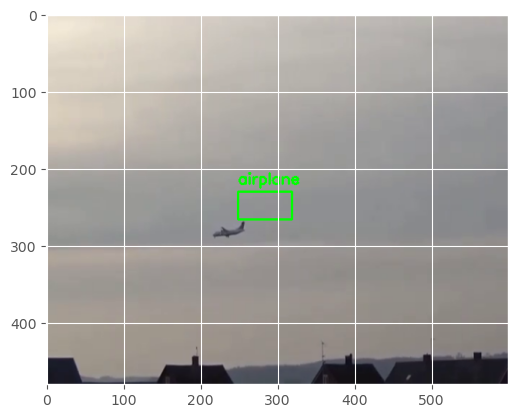

1/1 [==============================] - 0s 287ms/step


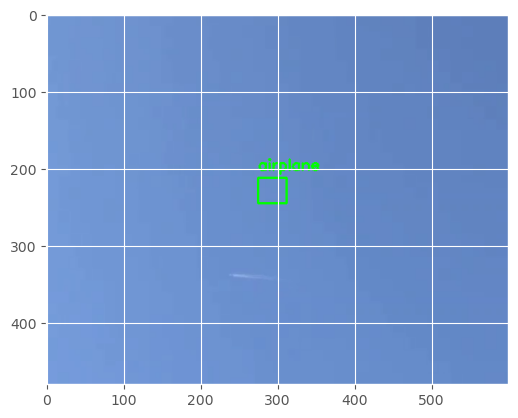

1/1 [==============================] - 0s 282ms/step


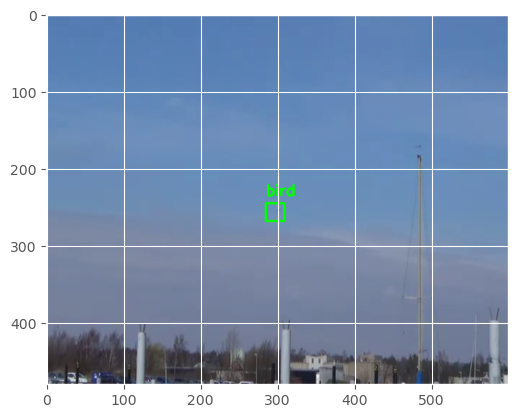

1/1 [==============================] - 0s 289ms/step


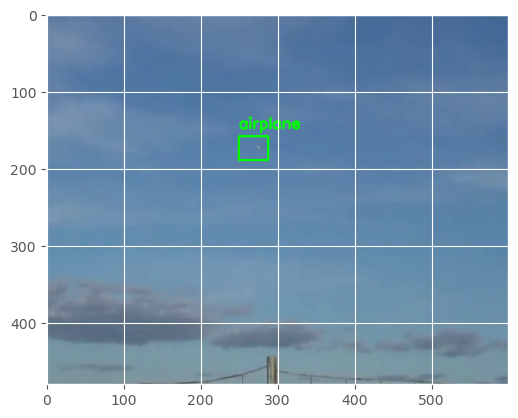

1/1 [==============================] - 0s 287ms/step


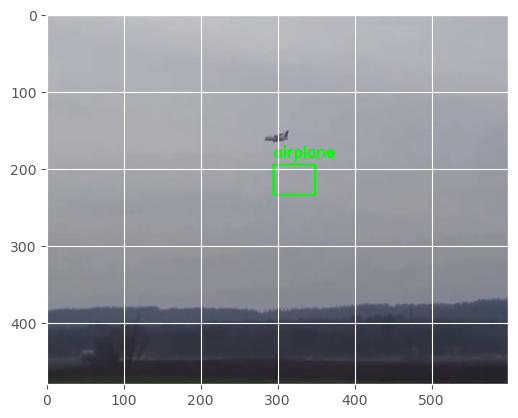

1/1 [==============================] - 0s 285ms/step


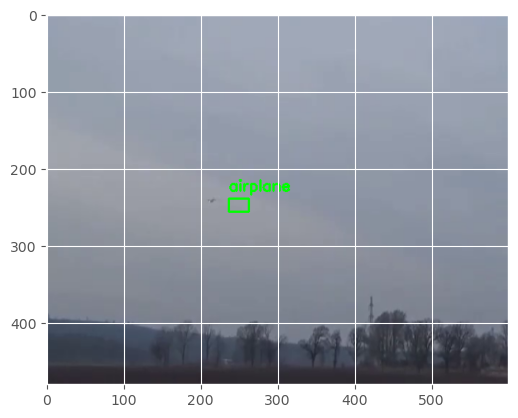

1/1 [==============================] - 0s 291ms/step


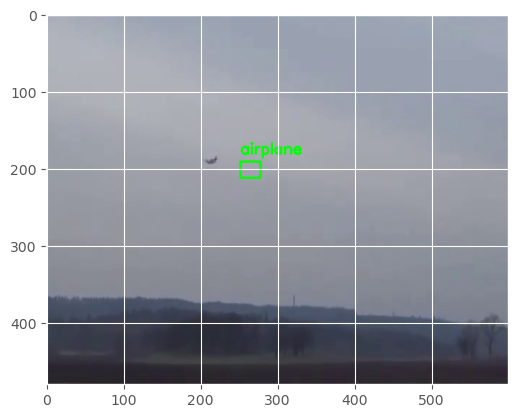

1/1 [==============================] - 0s 289ms/step


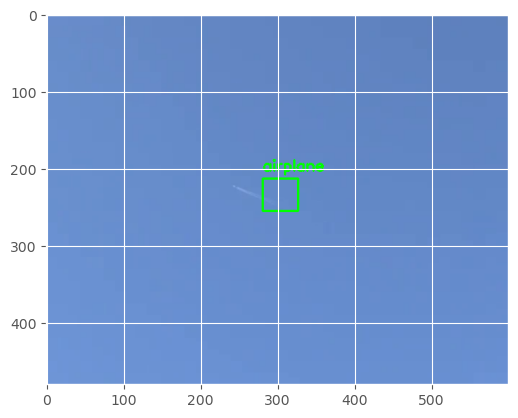

1/1 [==============================] - 0s 299ms/step


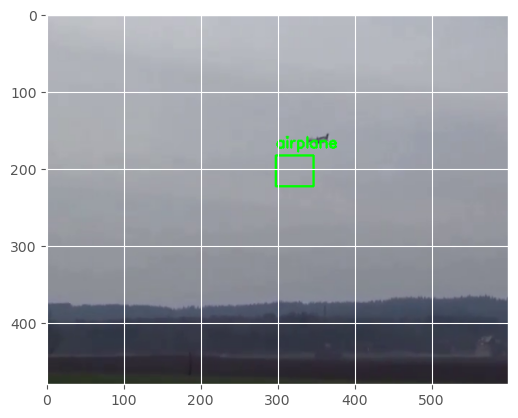

1/1 [==============================] - 0s 286ms/step


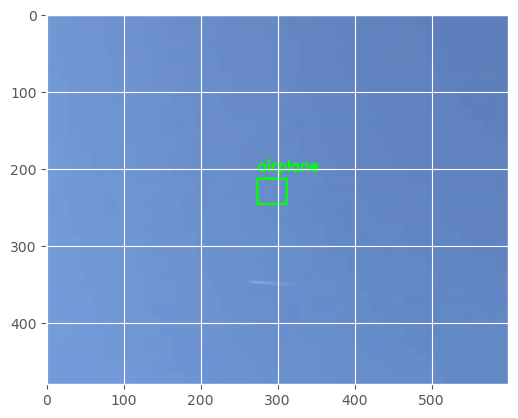

1/1 [==============================] - 0s 287ms/step


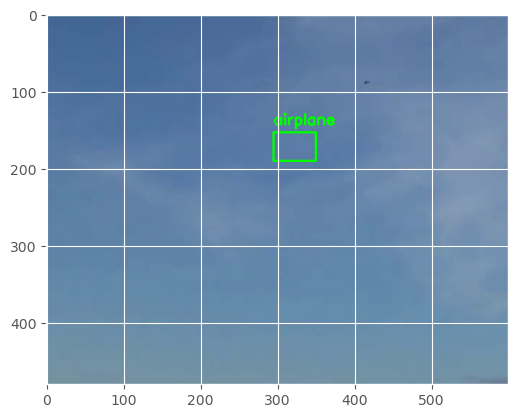

1/1 [==============================] - 0s 286ms/step


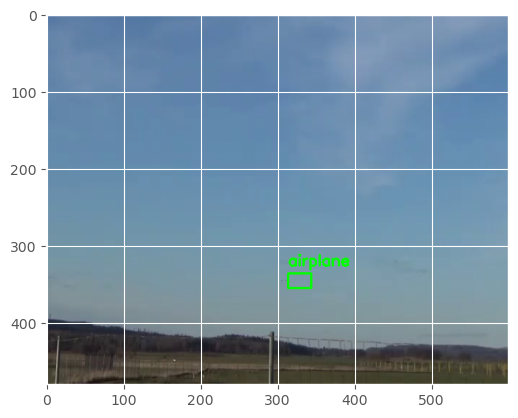

1/1 [==============================] - 0s 287ms/step


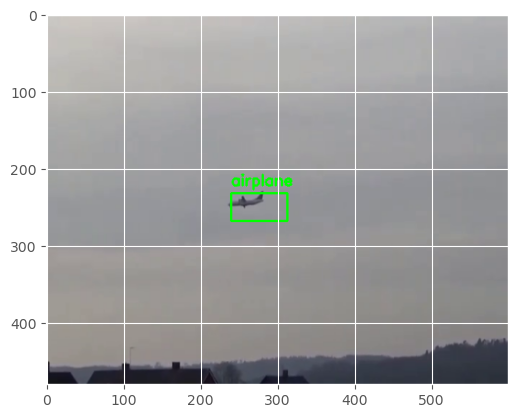

1/1 [==============================] - 0s 286ms/step


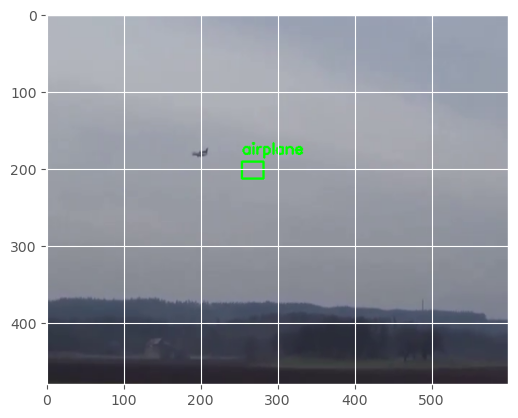

1/1 [==============================] - 0s 288ms/step


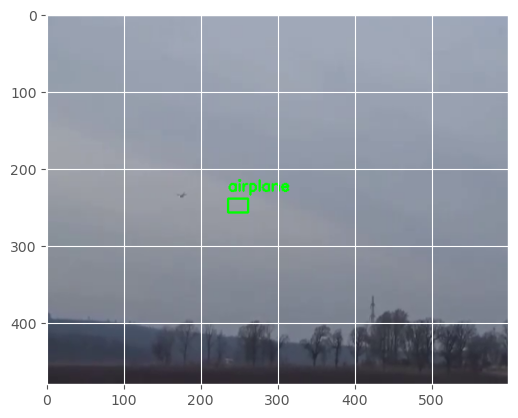

1/1 [==============================] - 0s 284ms/step


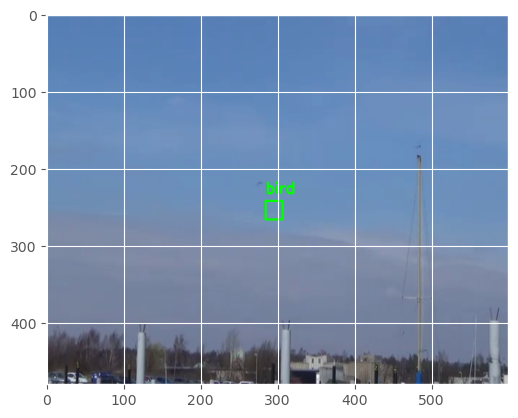

1/1 [==============================] - 0s 285ms/step


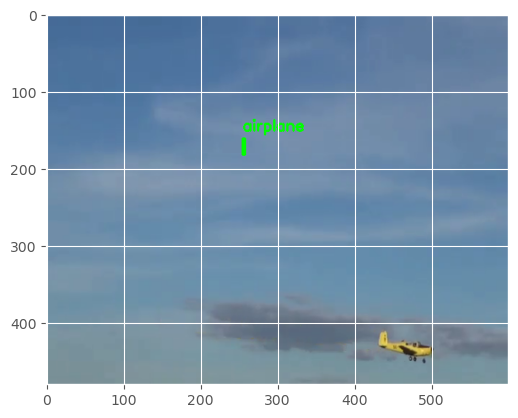

1/1 [==============================] - 0s 285ms/step


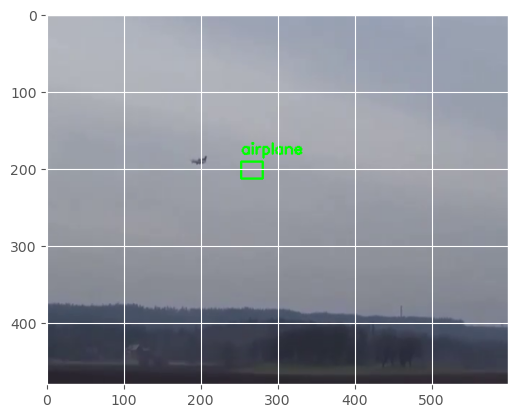

1/1 [==============================] - 0s 288ms/step


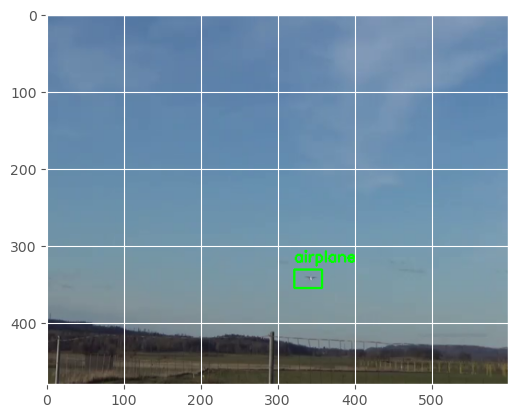

1/1 [==============================] - 0s 295ms/step


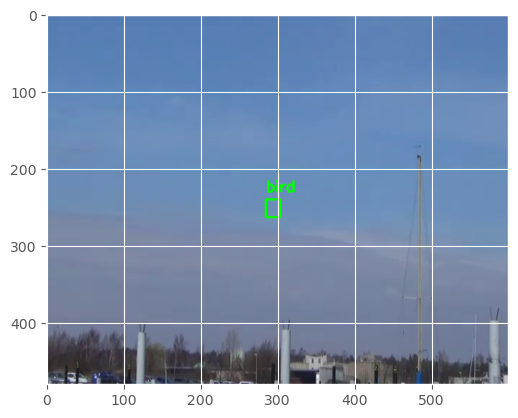

1/1 [==============================] - 0s 289ms/step


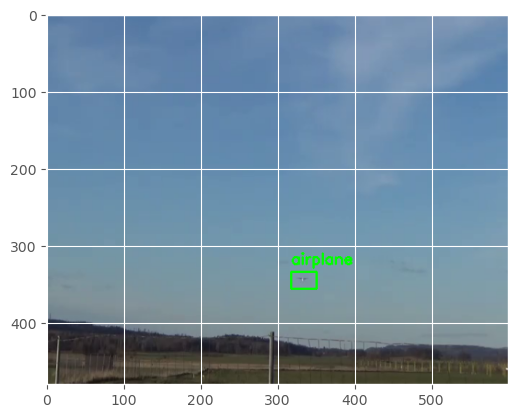

1/1 [==============================] - 0s 283ms/step


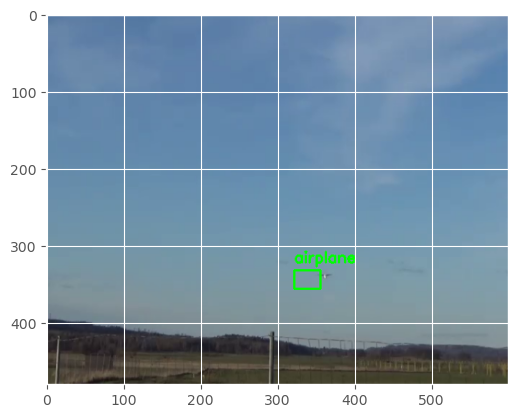

1/1 [==============================] - 0s 287ms/step


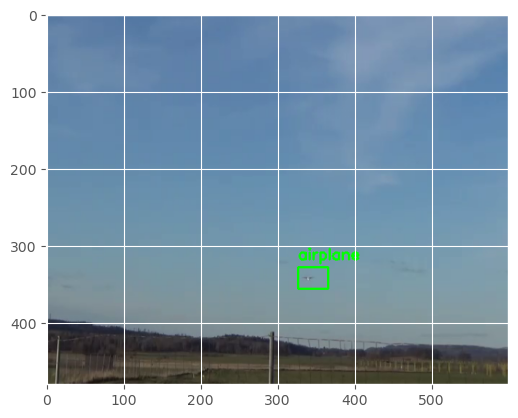

1/1 [==============================] - 0s 288ms/step


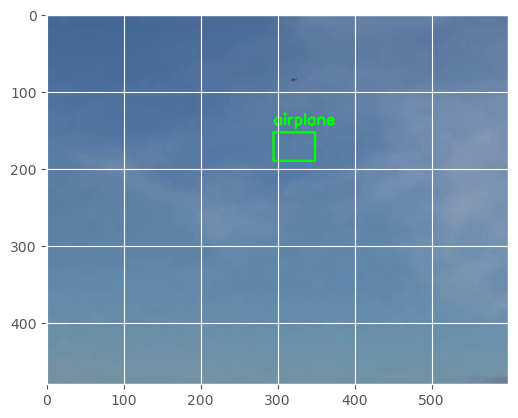

1/1 [==============================] - 0s 278ms/step


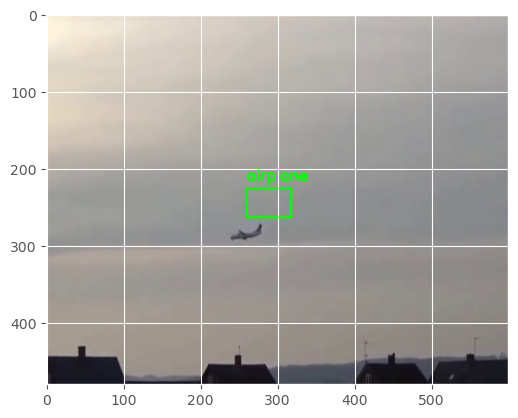

1/1 [==============================] - 0s 276ms/step


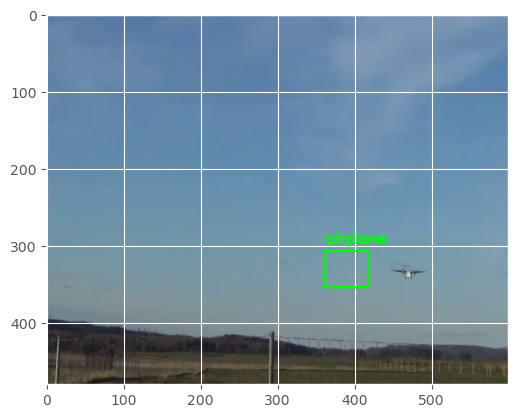

1/1 [==============================] - 0s 281ms/step


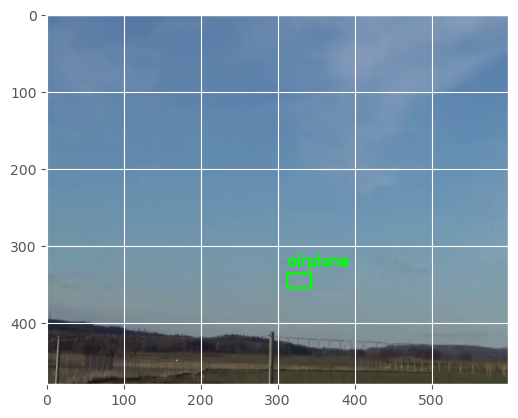

1/1 [==============================] - 0s 286ms/step


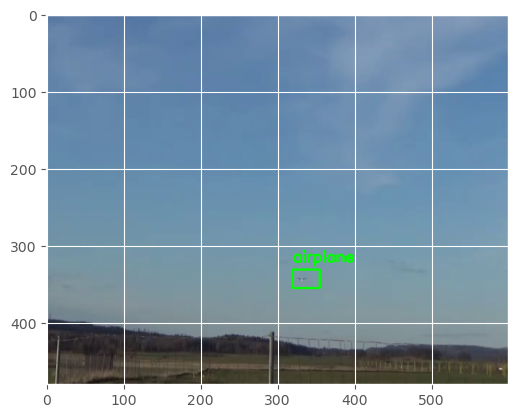

1/1 [==============================] - 0s 299ms/step


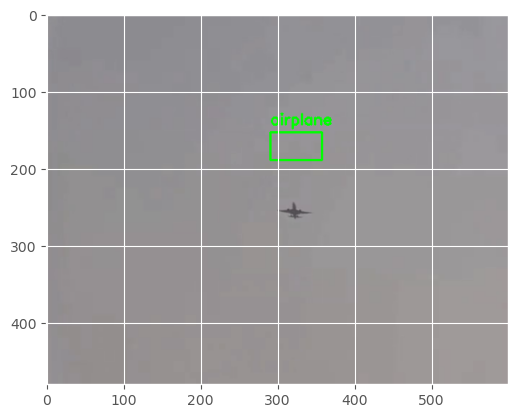

1/1 [==============================] - 0s 295ms/step


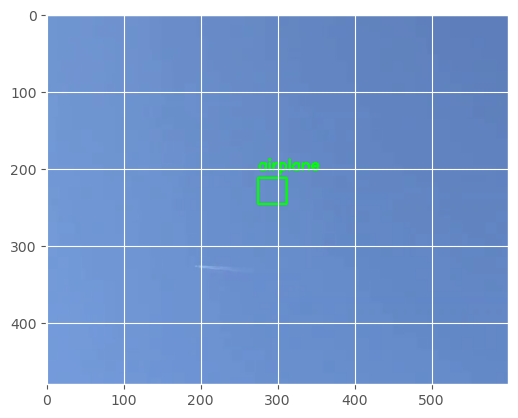

1/1 [==============================] - 0s 301ms/step


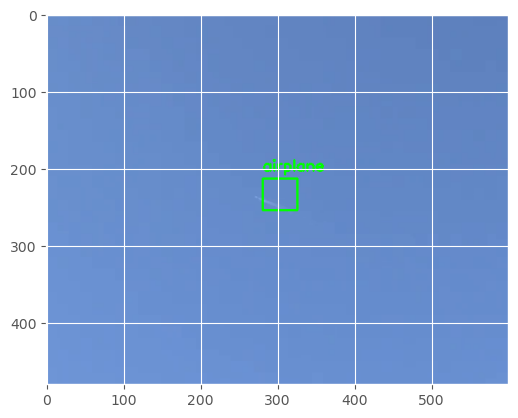

1/1 [==============================] - 0s 291ms/step


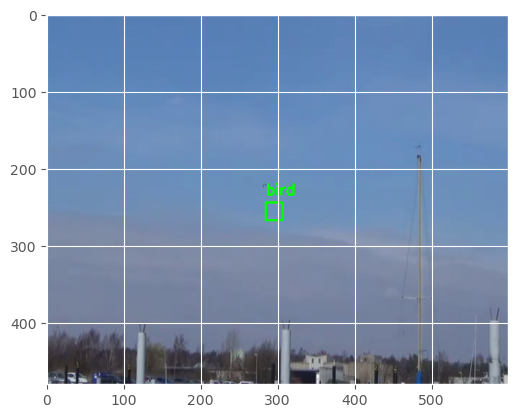

1/1 [==============================] - 0s 290ms/step


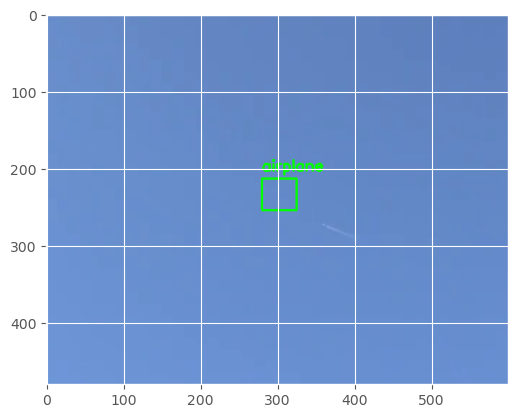

1/1 [==============================] - 0s 289ms/step


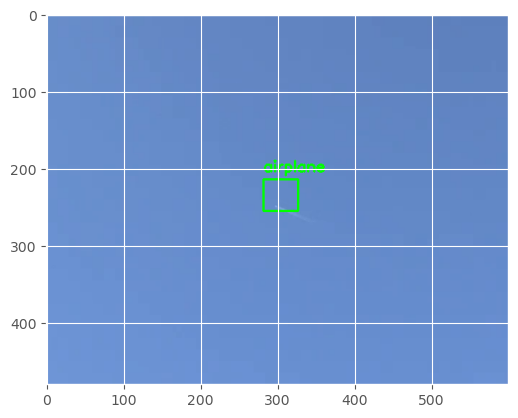

1/1 [==============================] - 0s 290ms/step


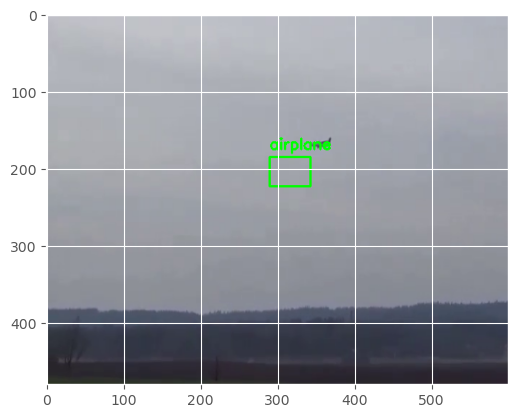

1/1 [==============================] - 0s 288ms/step


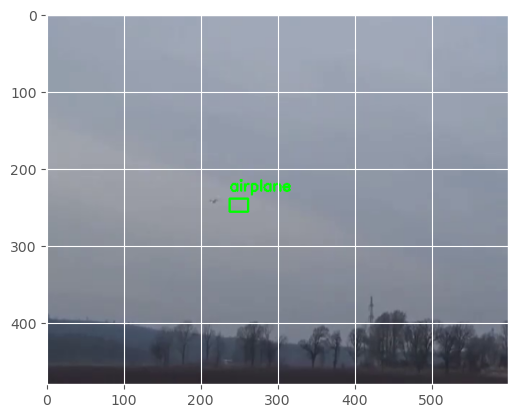

1/1 [==============================] - 0s 345ms/step


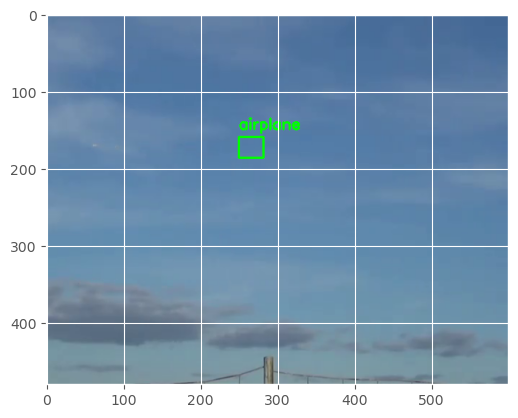

1/1 [==============================] - 0s 365ms/step


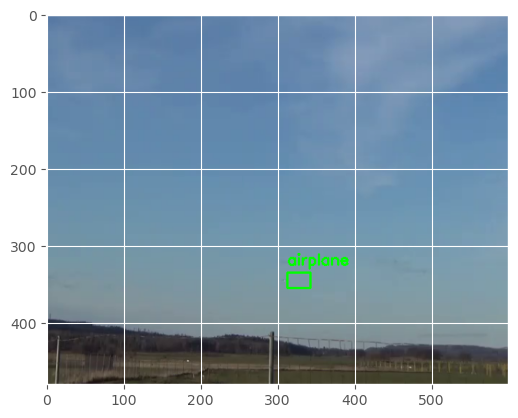

1/1 [==============================] - 0s 279ms/step


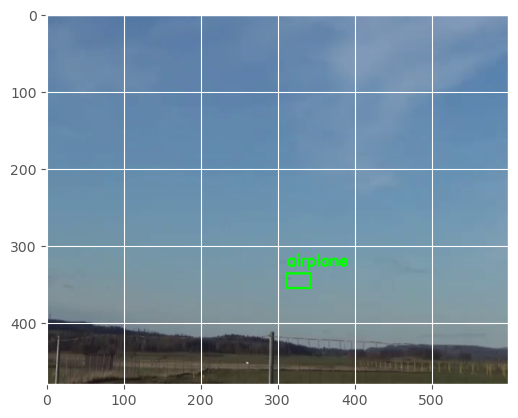

1/1 [==============================] - 0s 287ms/step


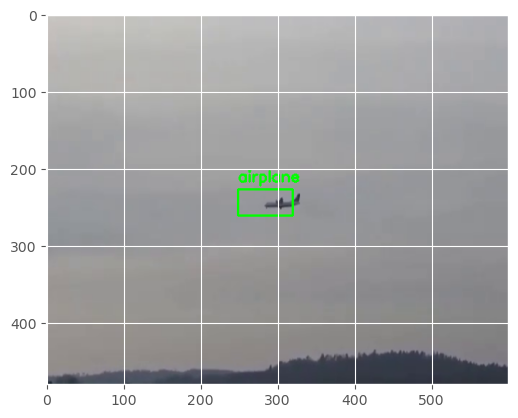

1/1 [==============================] - 0s 283ms/step


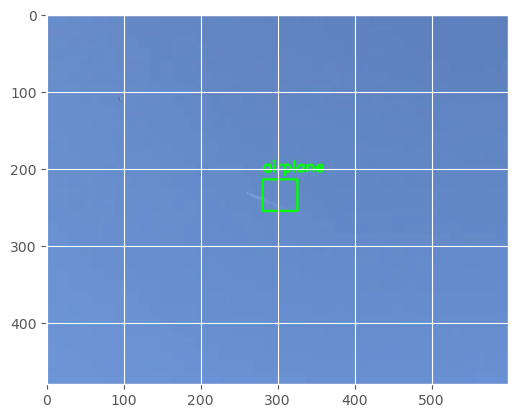

1/1 [==============================] - 0s 281ms/step


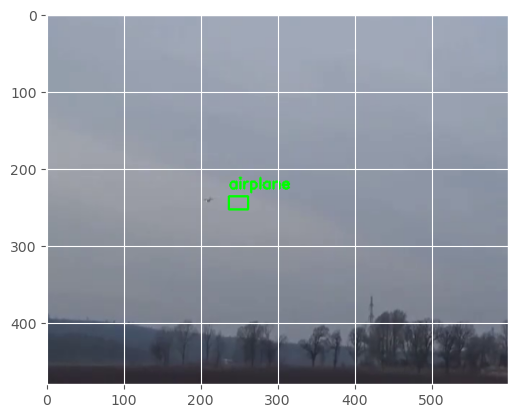

1/1 [==============================] - 0s 286ms/step


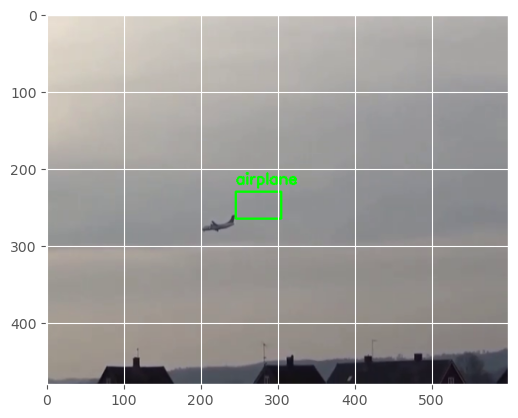

1/1 [==============================] - 0s 288ms/step


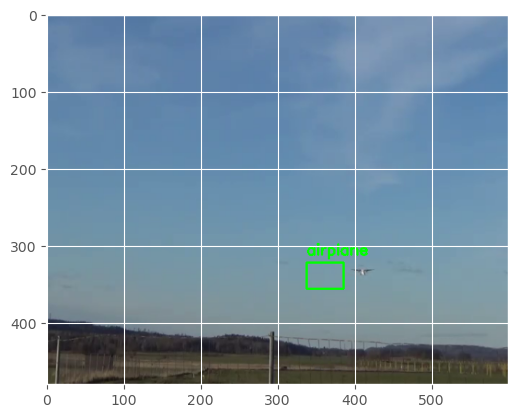

1/1 [==============================] - 0s 297ms/step


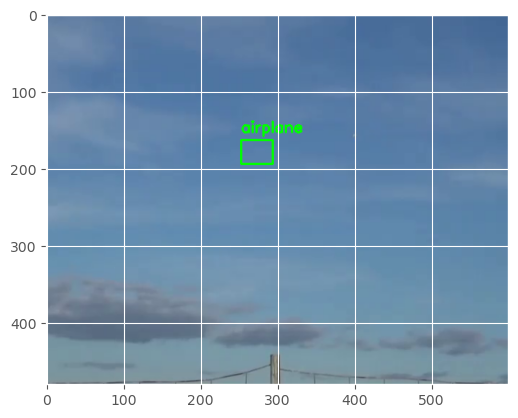

1/1 [==============================] - 0s 291ms/step


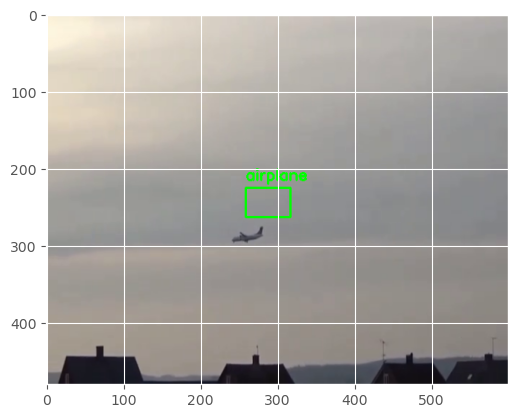

1/1 [==============================] - 0s 289ms/step


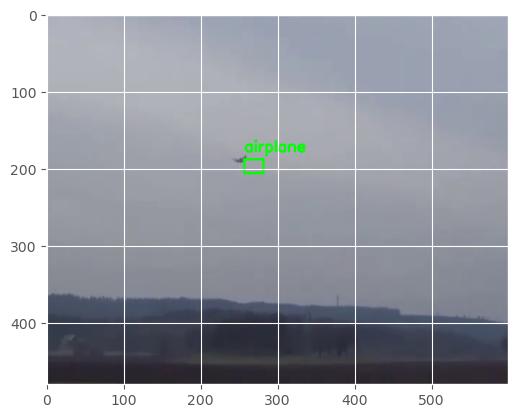

1/1 [==============================] - 0s 293ms/step


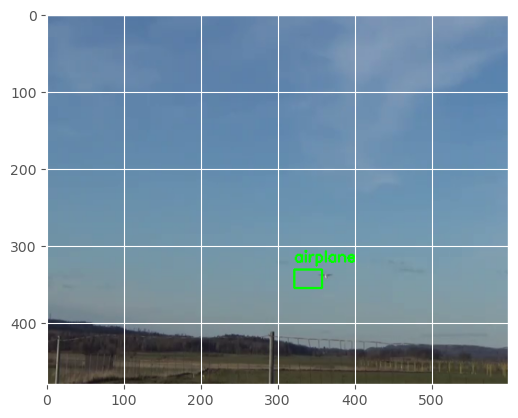

1/1 [==============================] - 0s 289ms/step


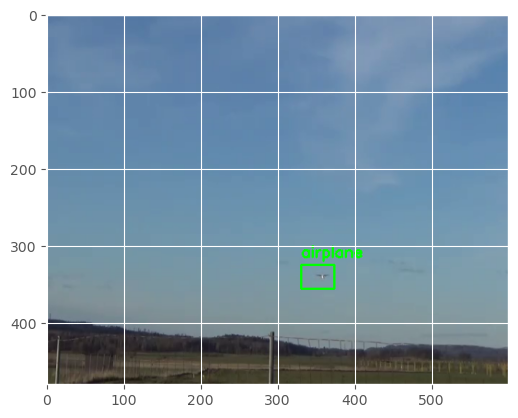

1/1 [==============================] - 0s 287ms/step


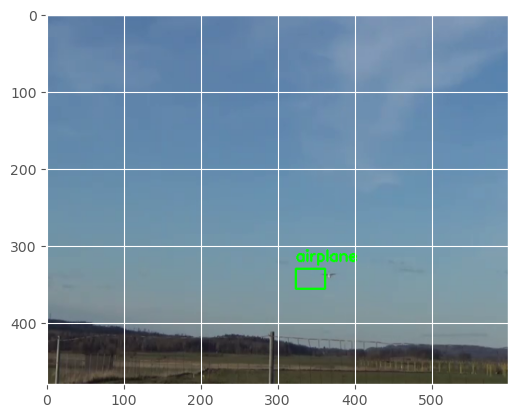

1/1 [==============================] - 0s 281ms/step


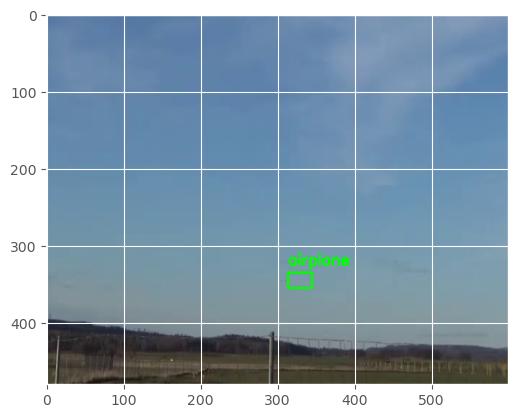

1/1 [==============================] - 0s 286ms/step


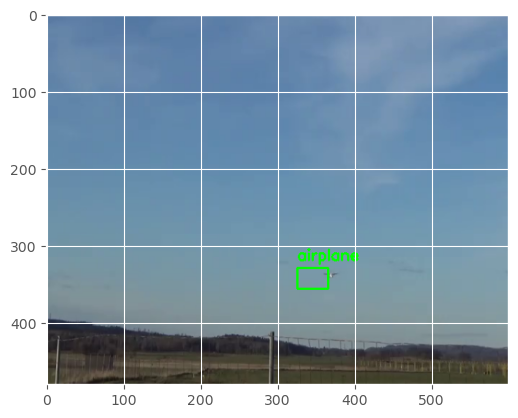

1/1 [==============================] - 0s 286ms/step


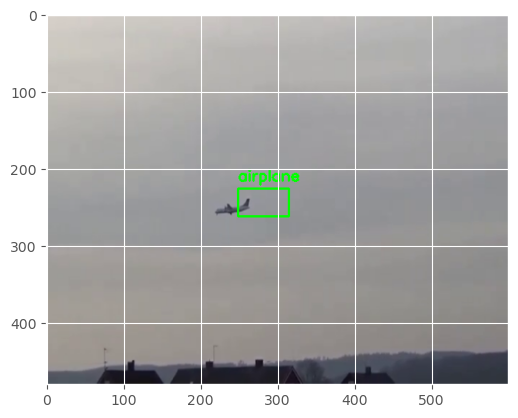

1/1 [==============================] - 0s 279ms/step


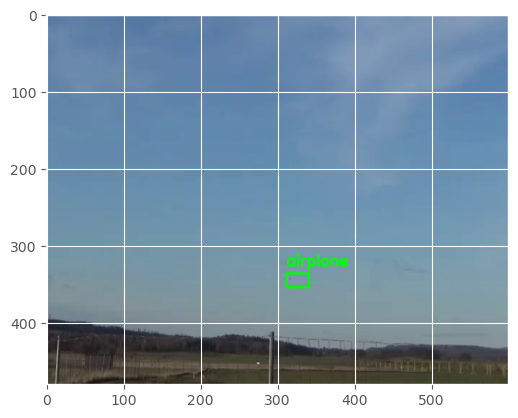

1/1 [==============================] - 0s 283ms/step


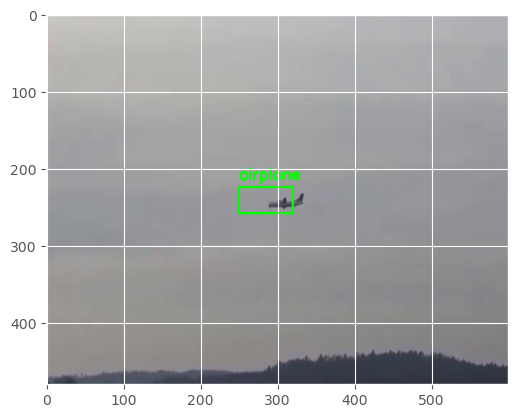

1/1 [==============================] - 0s 290ms/step


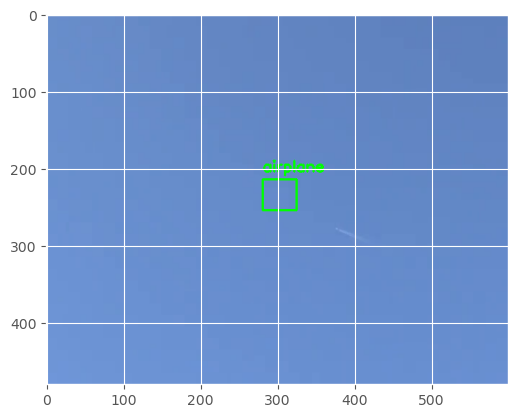

1/1 [==============================] - 0s 286ms/step


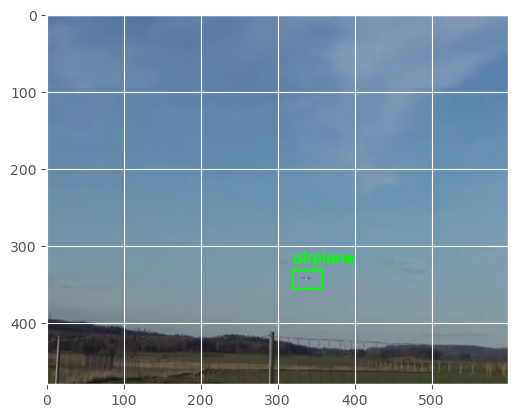

1/1 [==============================] - 0s 283ms/step


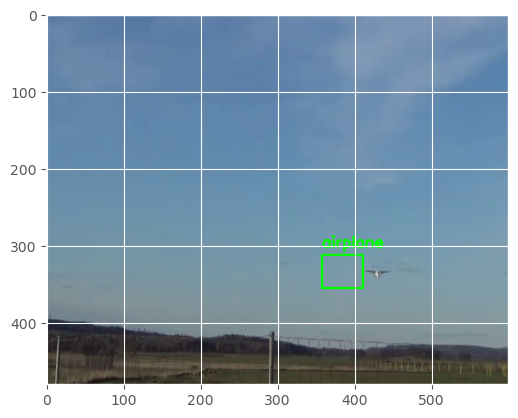

1/1 [==============================] - 0s 288ms/step


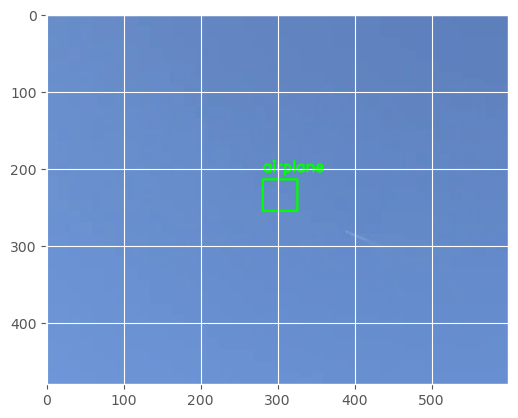

1/1 [==============================] - 0s 286ms/step


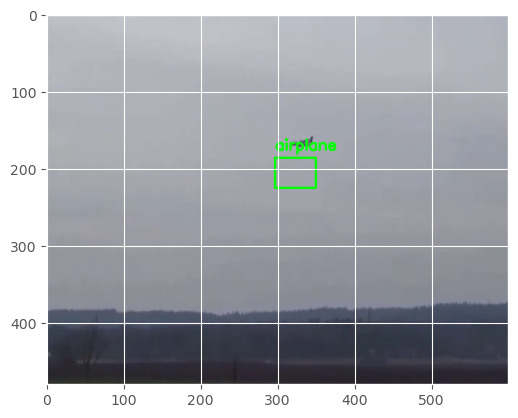

1/1 [==============================] - 0s 296ms/step


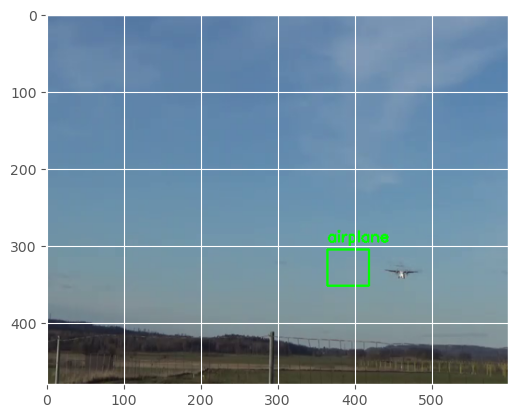

1/1 [==============================] - 0s 280ms/step


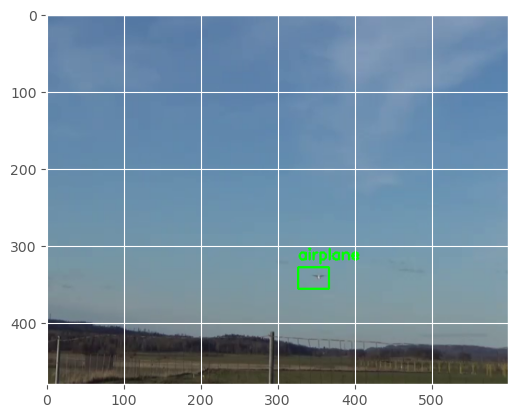

1/1 [==============================] - 0s 278ms/step


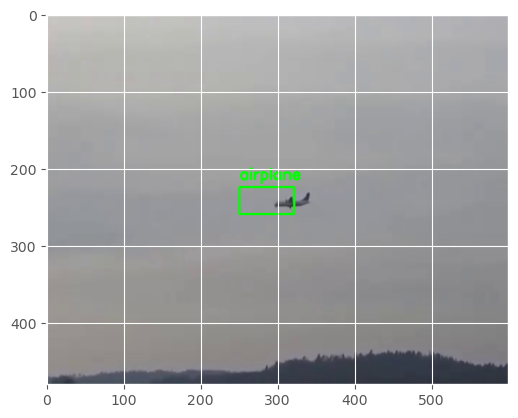

1/1 [==============================] - 0s 282ms/step


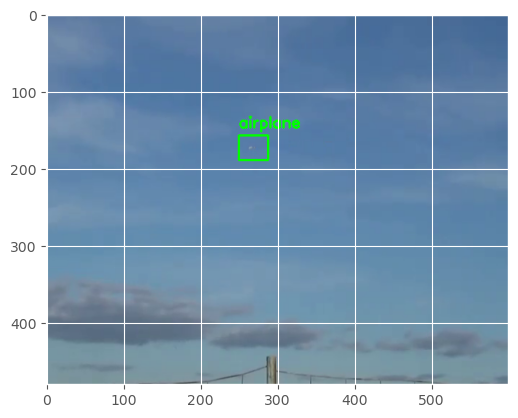

1/1 [==============================] - 0s 291ms/step


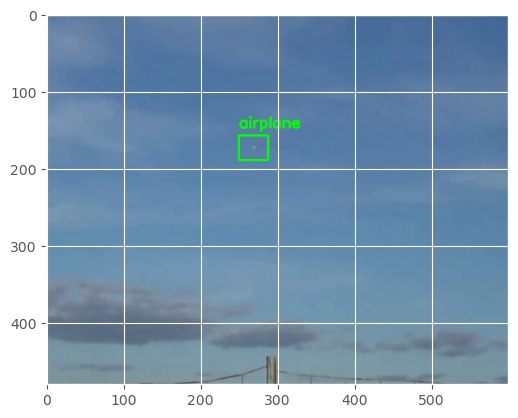

1/1 [==============================] - 0s 287ms/step


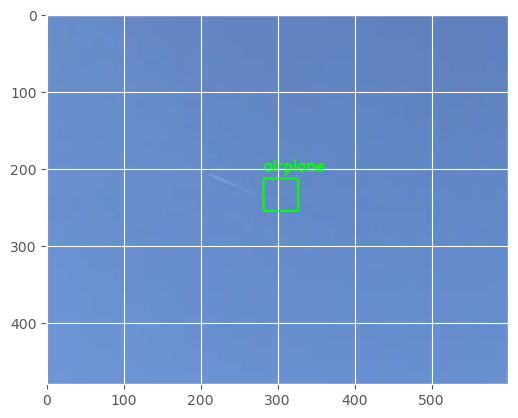

1/1 [==============================] - 0s 285ms/step


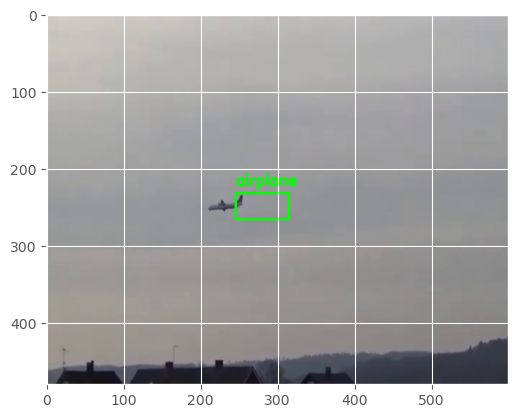

1/1 [==============================] - 0s 287ms/step


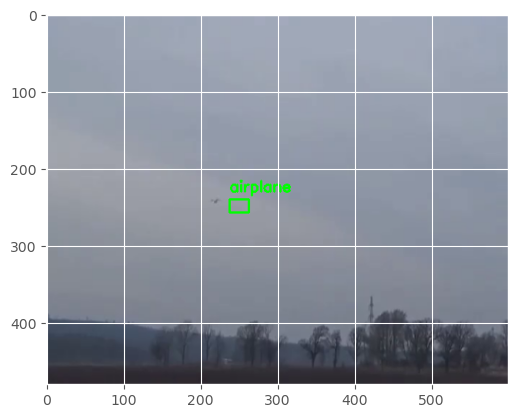

1/1 [==============================] - 0s 284ms/step


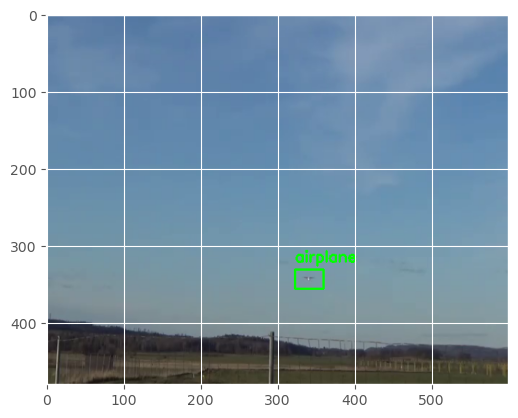

1/1 [==============================] - 0s 284ms/step


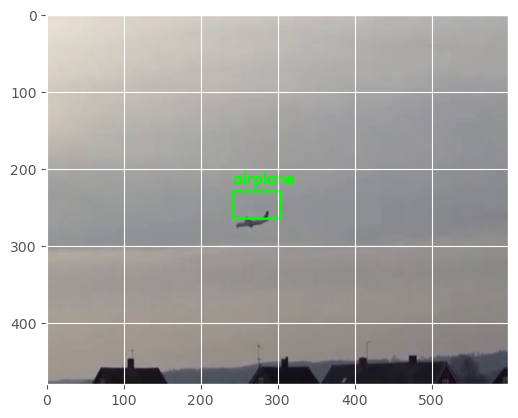

1/1 [==============================] - 0s 280ms/step


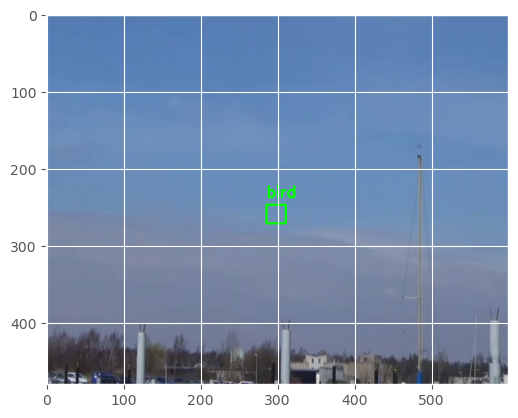

1/1 [==============================] - 0s 295ms/step


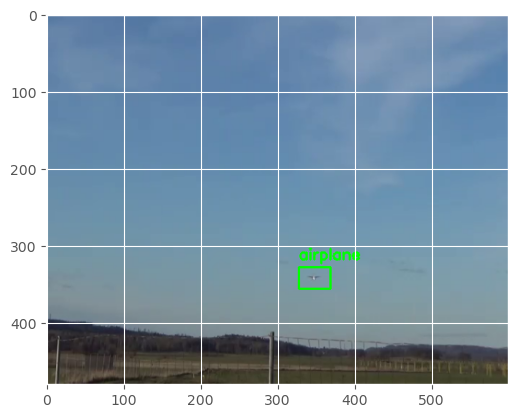

1/1 [==============================] - 0s 287ms/step


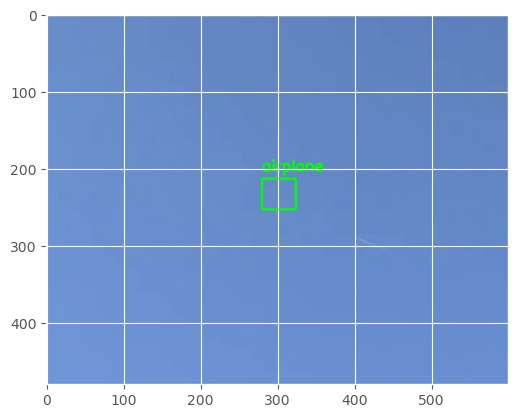

1/1 [==============================] - 0s 283ms/step


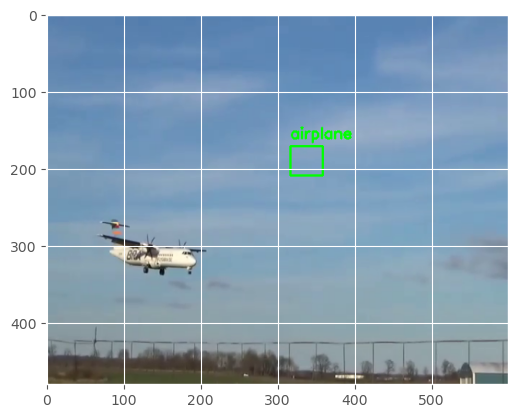

1/1 [==============================] - 0s 291ms/step


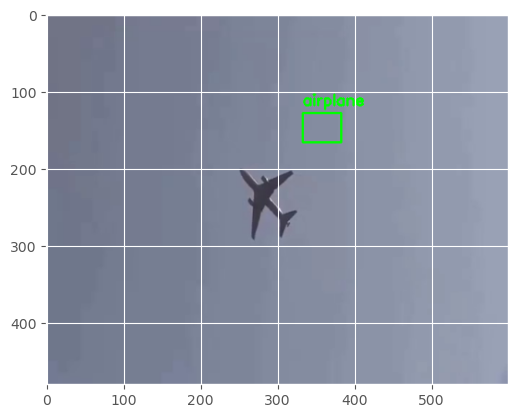

1/1 [==============================] - 0s 291ms/step


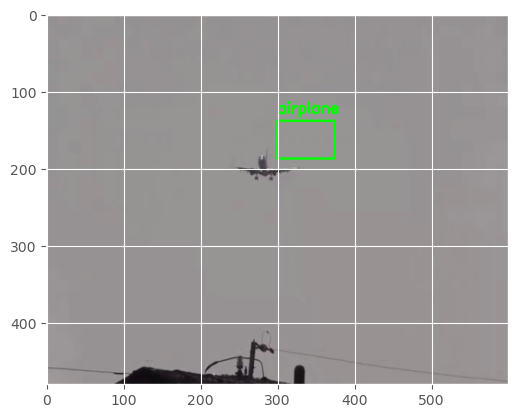

1/1 [==============================] - 0s 277ms/step


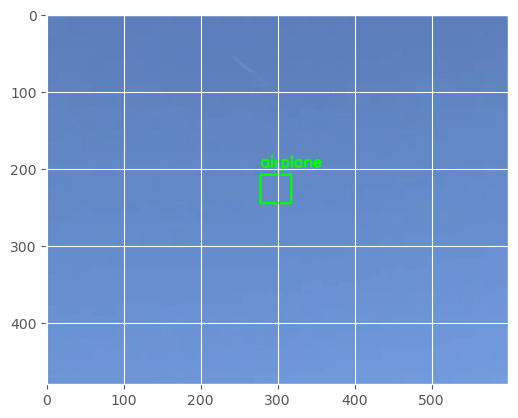

1/1 [==============================] - 0s 281ms/step


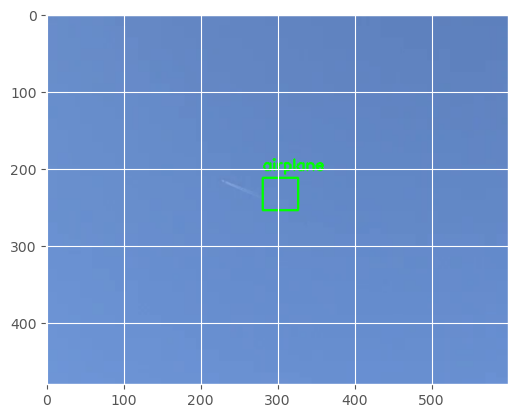

1/1 [==============================] - 0s 277ms/step


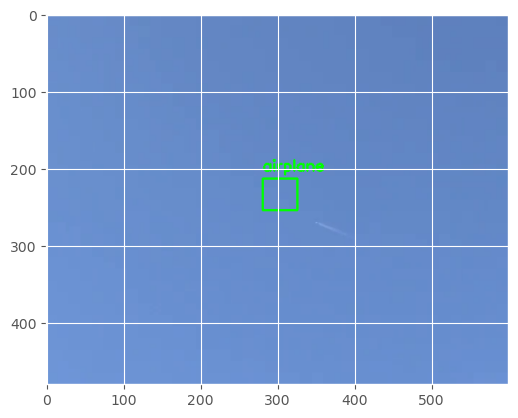

1/1 [==============================] - 0s 288ms/step


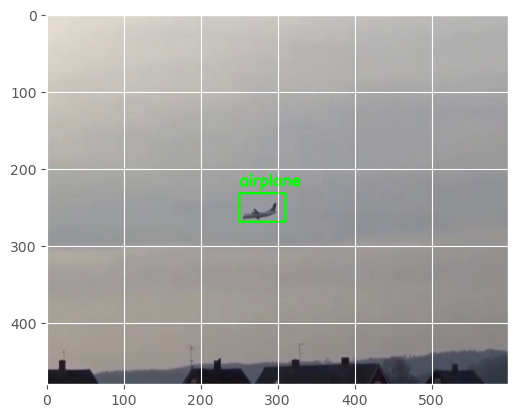

1/1 [==============================] - 0s 283ms/step


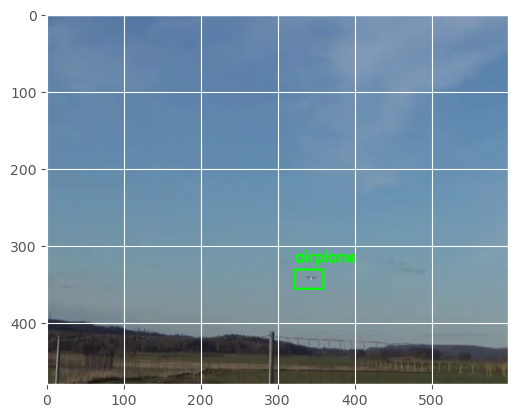

1/1 [==============================] - 0s 284ms/step


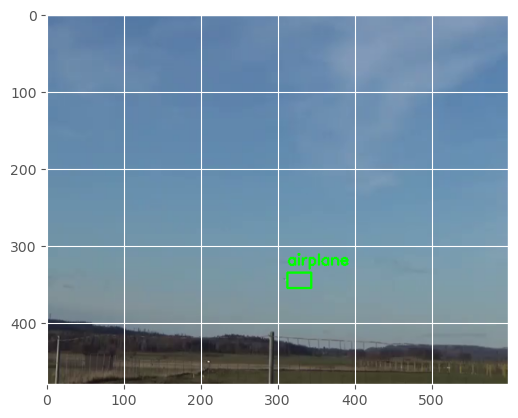

1/1 [==============================] - 0s 303ms/step


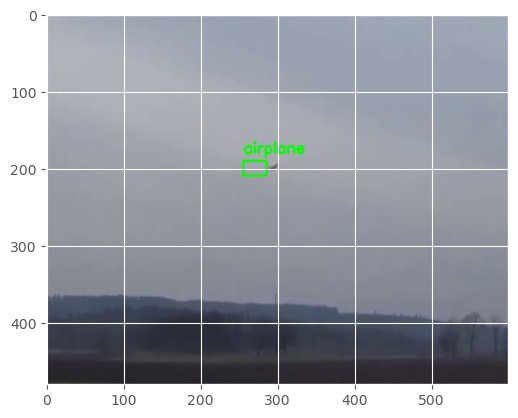

1/1 [==============================] - 0s 292ms/step


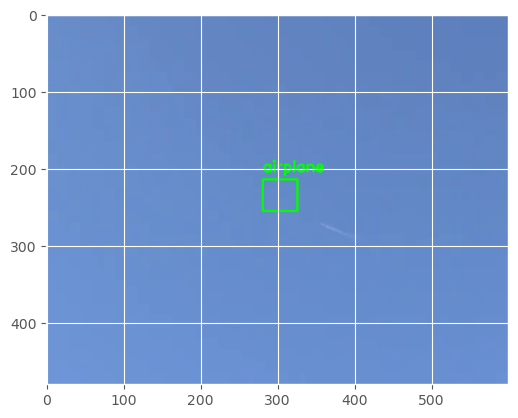

1/1 [==============================] - 0s 284ms/step


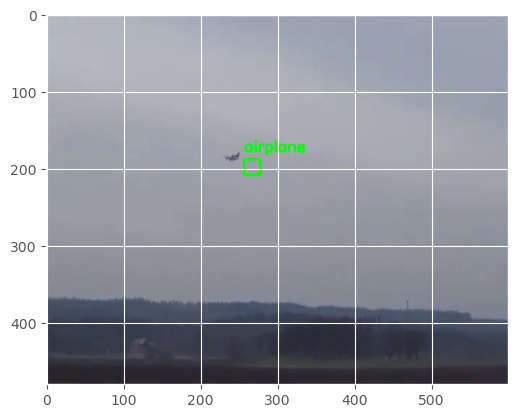

1/1 [==============================] - 0s 280ms/step


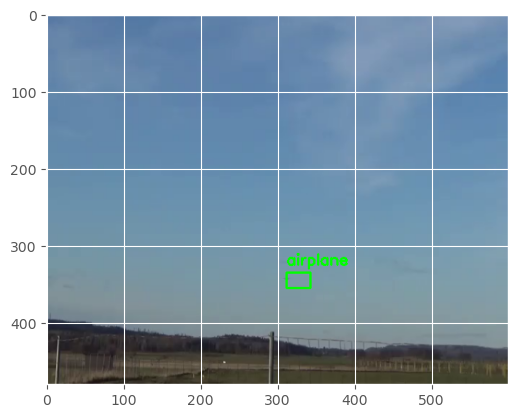

1/1 [==============================] - 0s 278ms/step


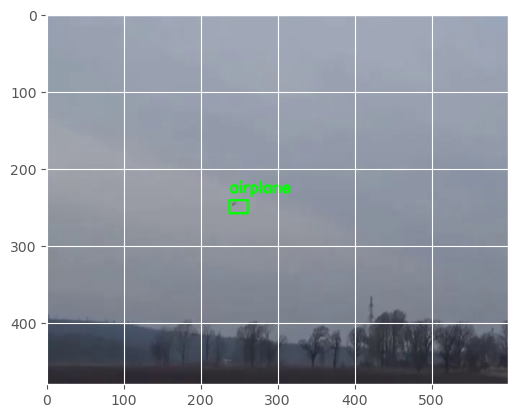

1/1 [==============================] - 0s 383ms/step


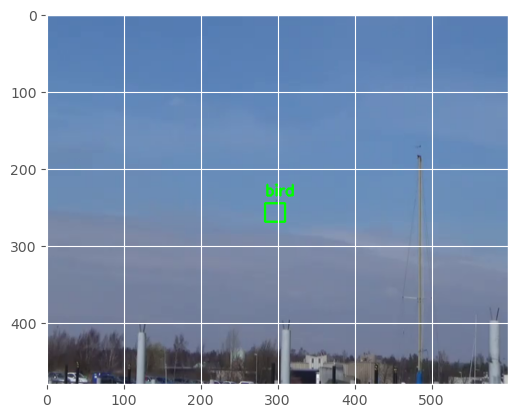

1/1 [==============================] - 0s 365ms/step


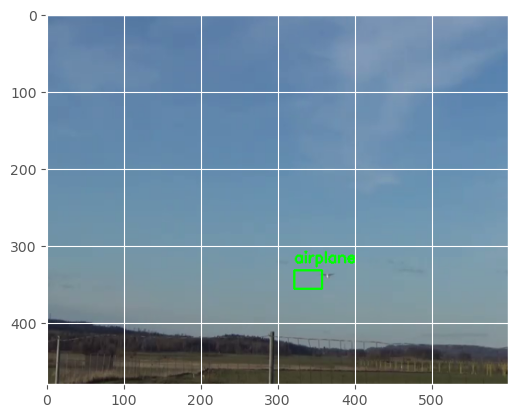

1/1 [==============================] - 0s 287ms/step


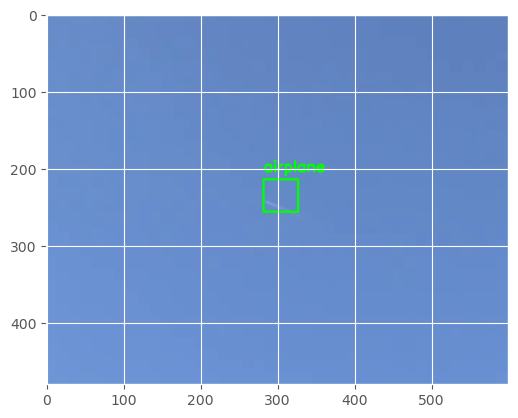

1/1 [==============================] - 0s 282ms/step


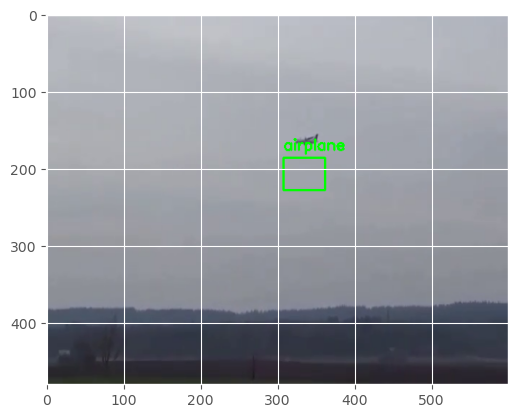

1/1 [==============================] - 0s 285ms/step


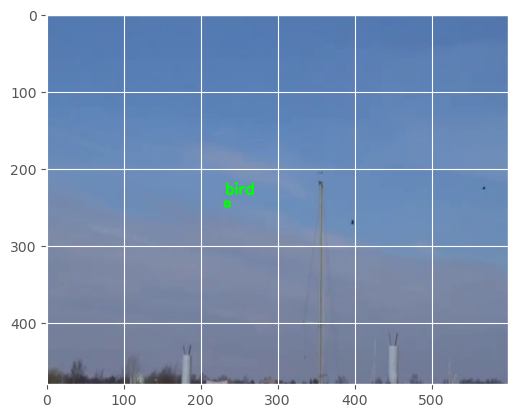

1/1 [==============================] - 0s 274ms/step


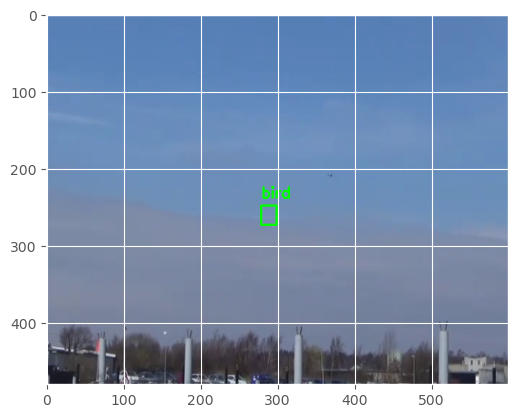

1/1 [==============================] - 0s 274ms/step


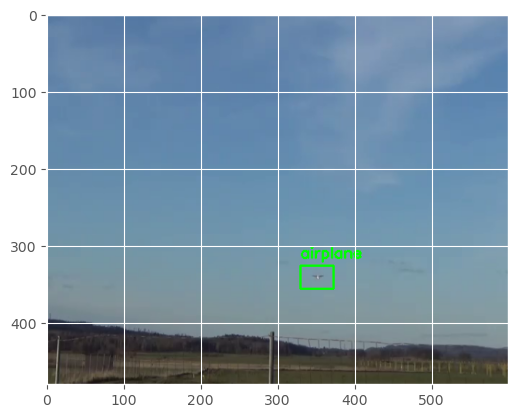

1/1 [==============================] - 0s 275ms/step


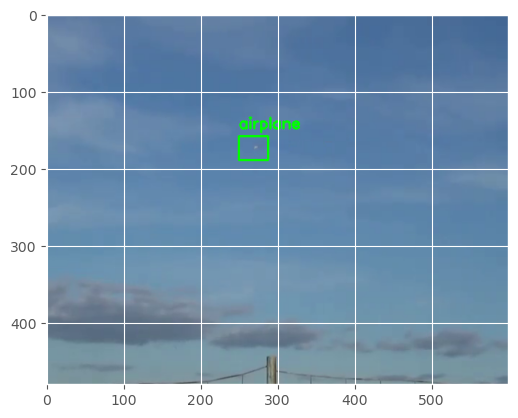

1/1 [==============================] - 0s 284ms/step


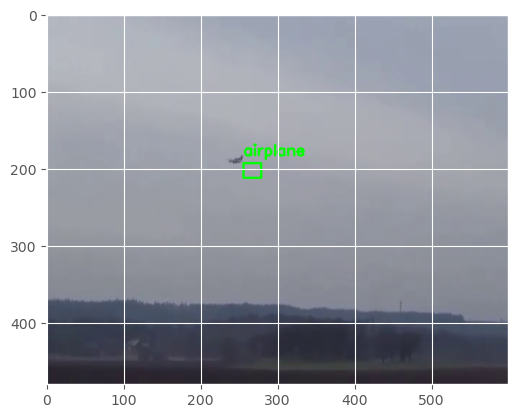

1/1 [==============================] - 0s 280ms/step


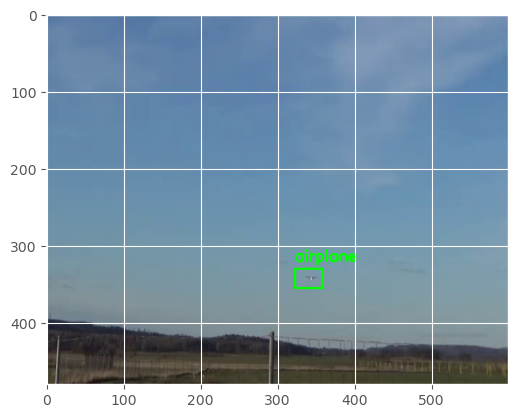

1/1 [==============================] - 0s 279ms/step


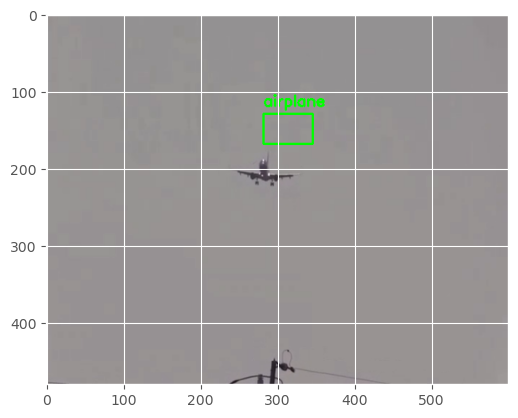

1/1 [==============================] - 0s 279ms/step


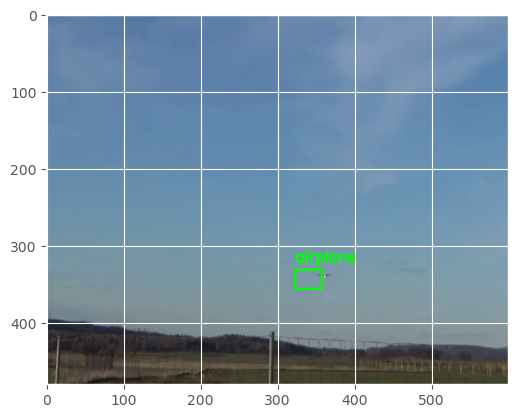

1/1 [==============================] - 0s 283ms/step


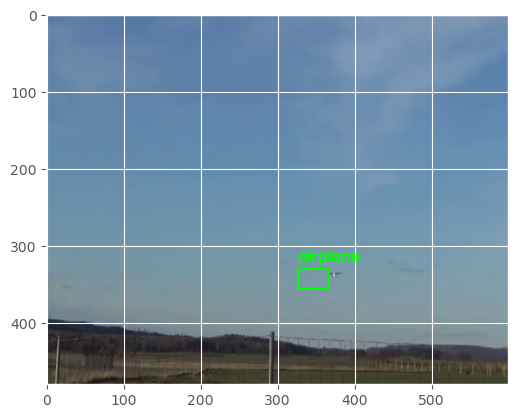

1/1 [==============================] - 0s 316ms/step


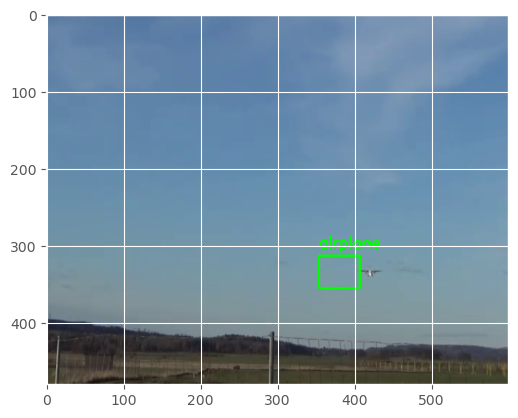

1/1 [==============================] - 0s 277ms/step


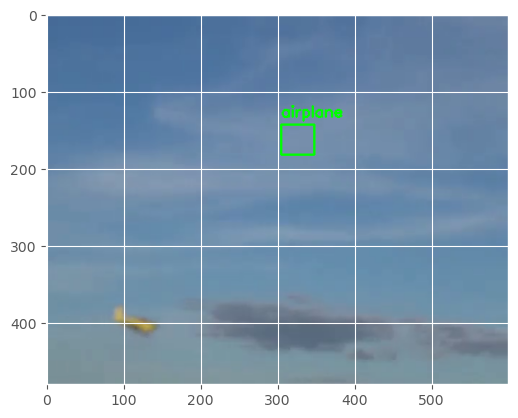

1/1 [==============================] - 0s 276ms/step


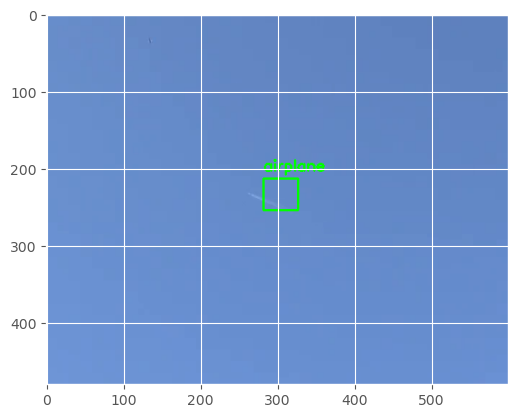

1/1 [==============================] - 0s 285ms/step


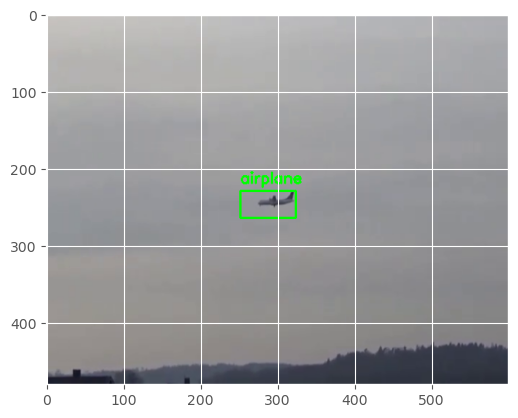

1/1 [==============================] - 0s 281ms/step


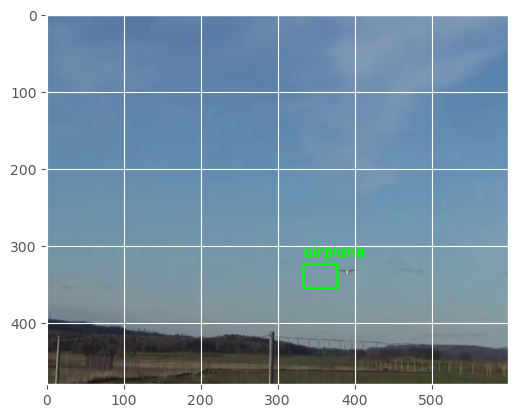

1/1 [==============================] - 0s 281ms/step


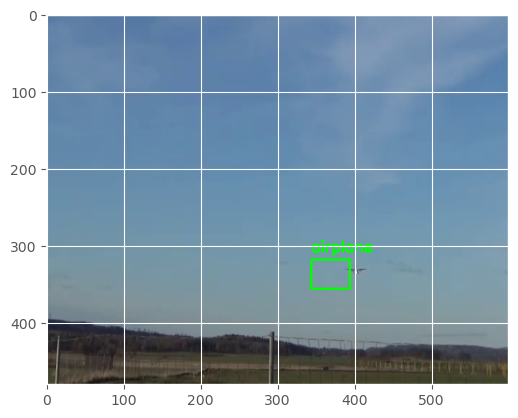

1/1 [==============================] - 0s 280ms/step


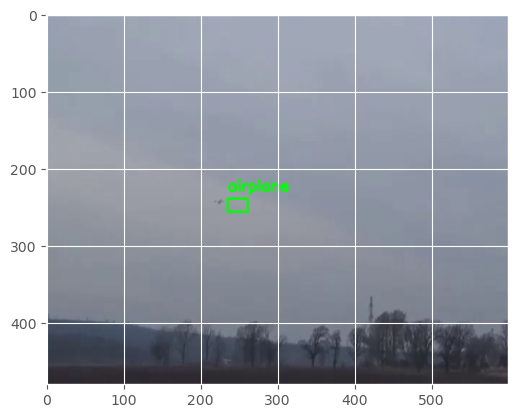

1/1 [==============================] - 0s 280ms/step


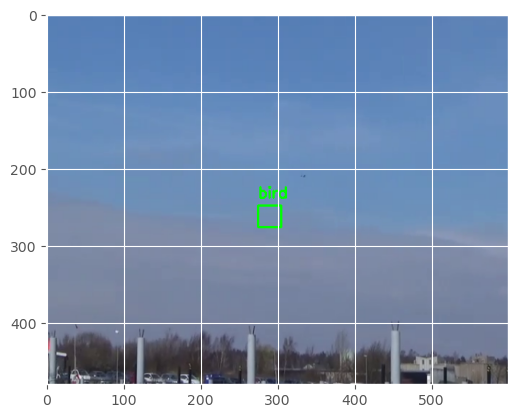

1/1 [==============================] - 0s 279ms/step


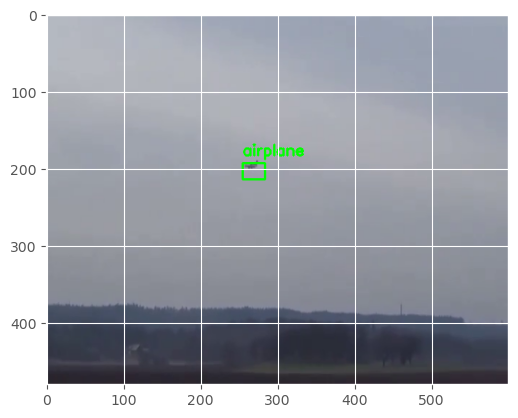

1/1 [==============================] - 0s 288ms/step


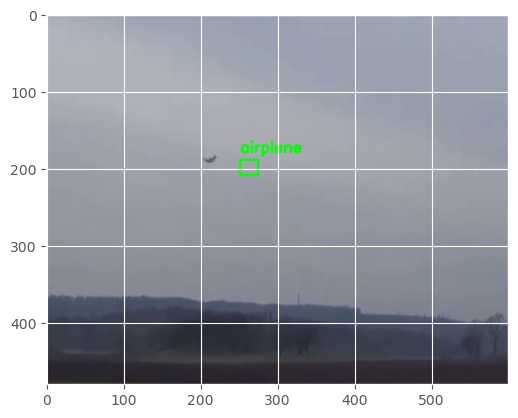

1/1 [==============================] - 0s 279ms/step


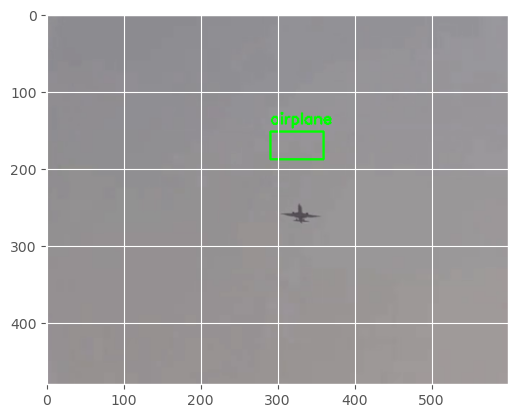

1/1 [==============================] - 0s 276ms/step


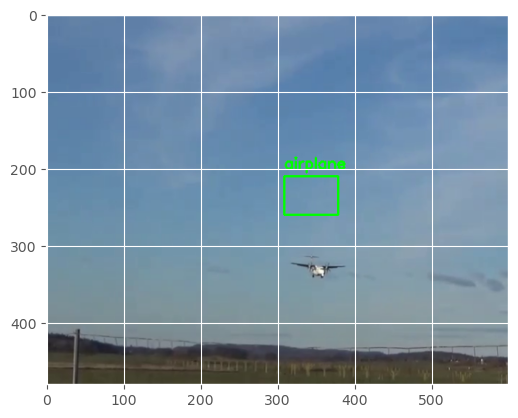

1/1 [==============================] - 0s 278ms/step


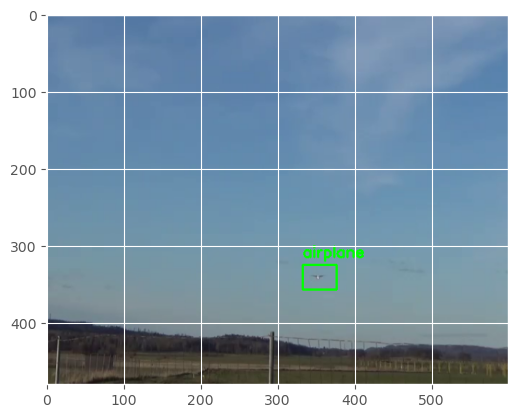

1/1 [==============================] - 0s 279ms/step


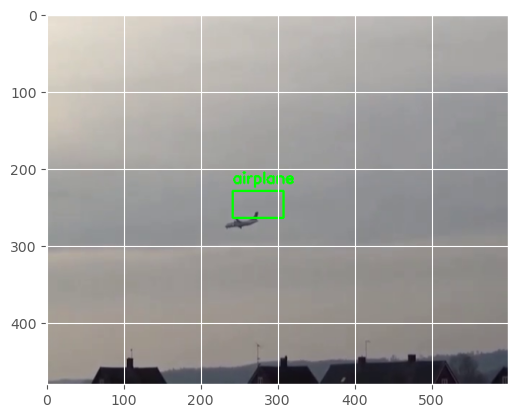

1/1 [==============================] - 0s 284ms/step


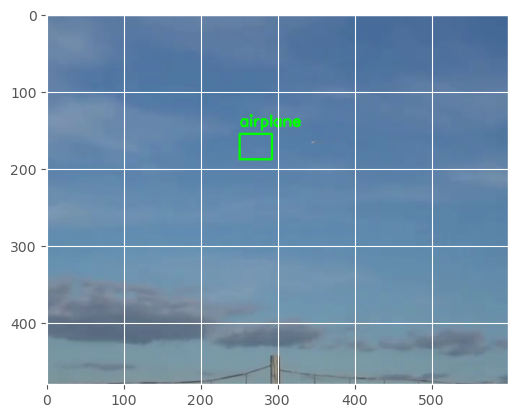

1/1 [==============================] - 0s 281ms/step


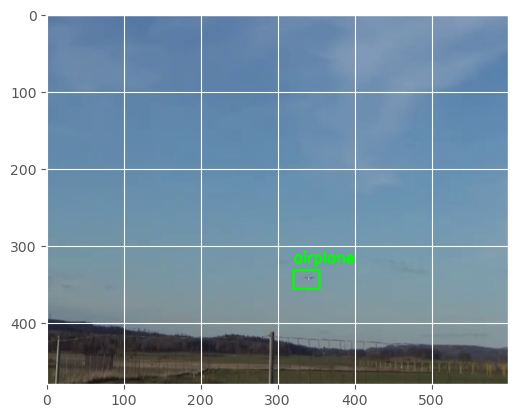

1/1 [==============================] - 0s 286ms/step


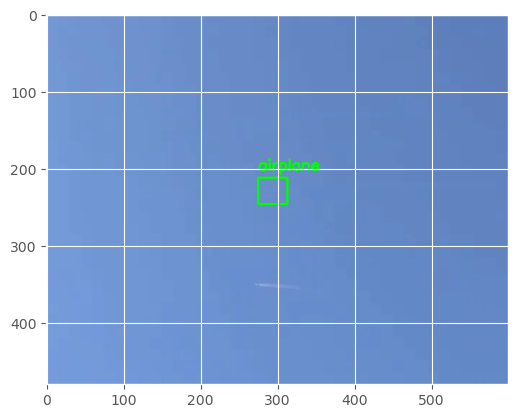

1/1 [==============================] - 0s 330ms/step


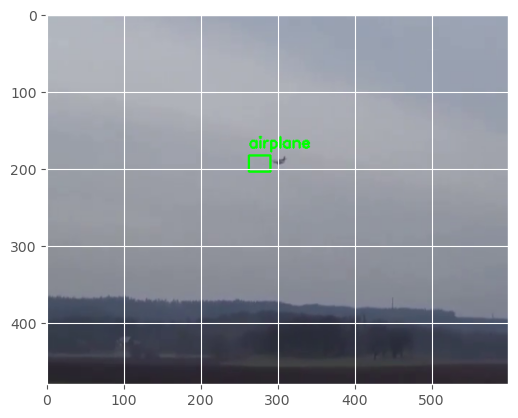

1/1 [==============================] - 0s 294ms/step


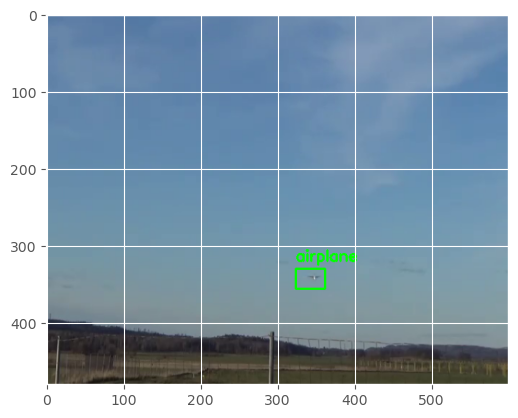

1/1 [==============================] - 0s 282ms/step


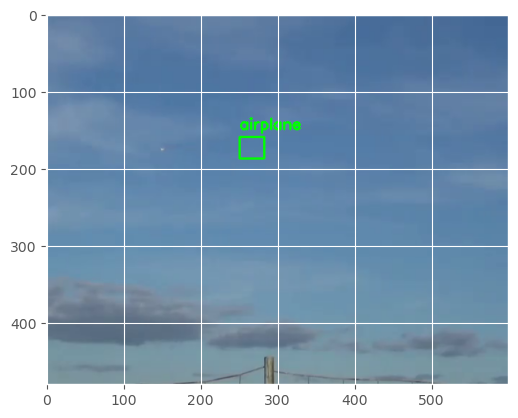

1/1 [==============================] - 0s 278ms/step


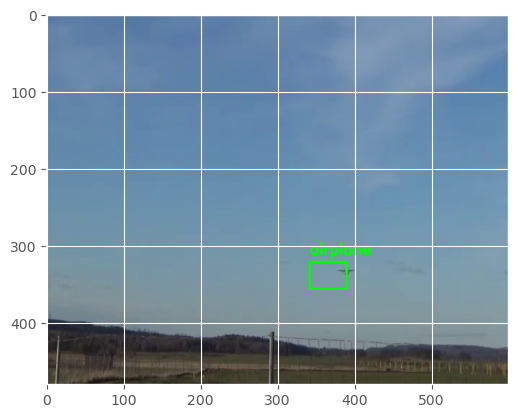

1/1 [==============================] - 0s 282ms/step


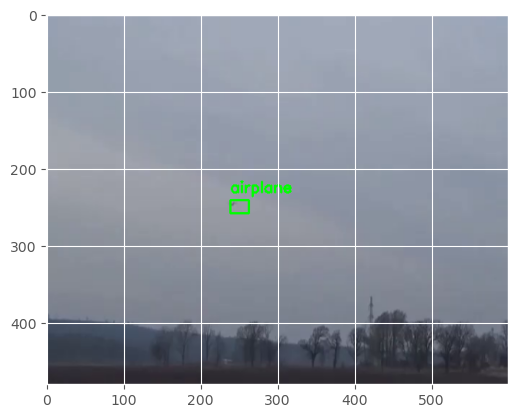

1/1 [==============================] - 0s 279ms/step


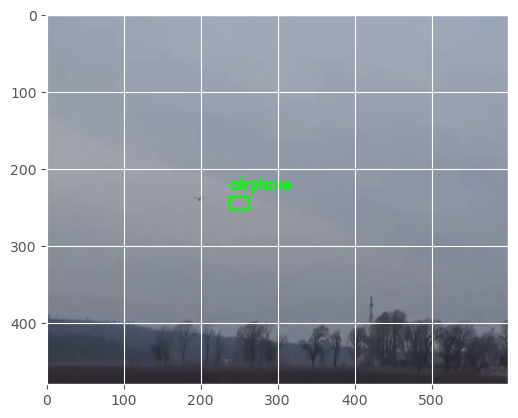

1/1 [==============================] - 0s 283ms/step


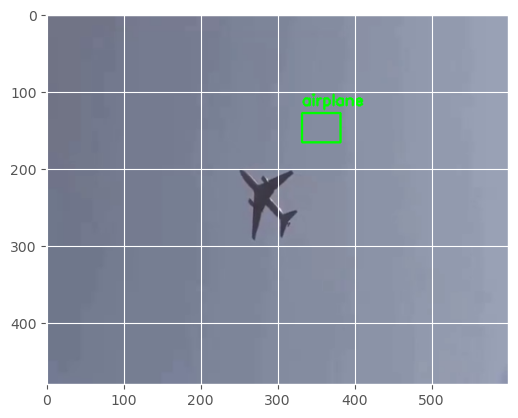

1/1 [==============================] - 0s 284ms/step


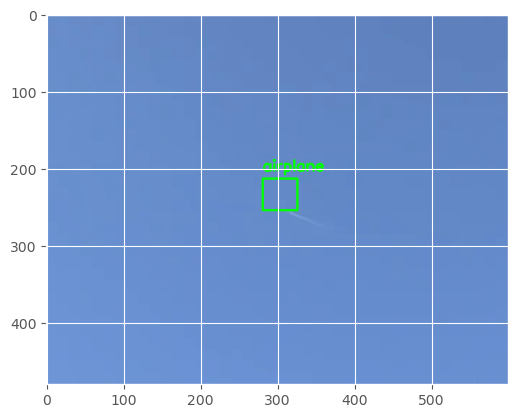

1/1 [==============================] - 0s 292ms/step


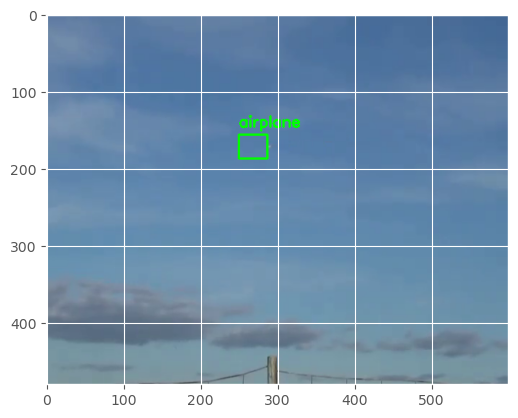

1/1 [==============================] - 0s 287ms/step


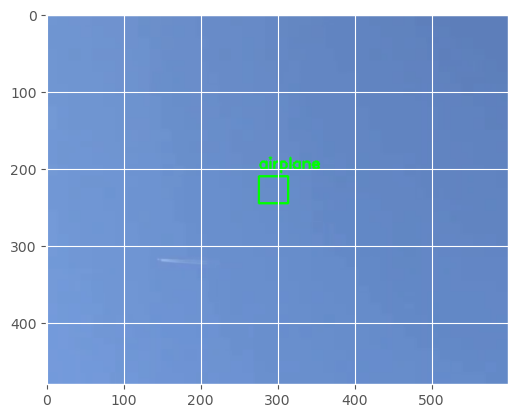

1/1 [==============================] - 0s 279ms/step


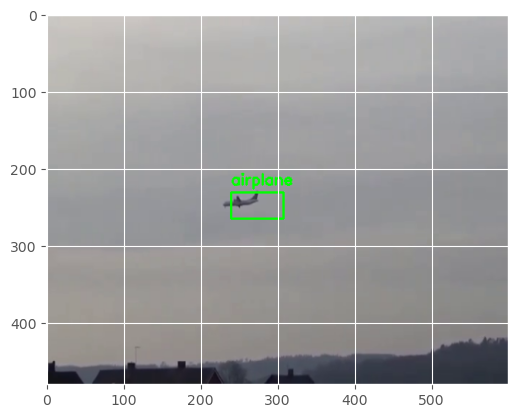

1/1 [==============================] - 0s 271ms/step


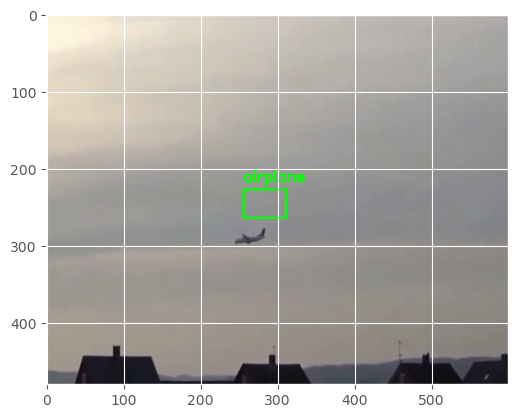

1/1 [==============================] - 0s 279ms/step


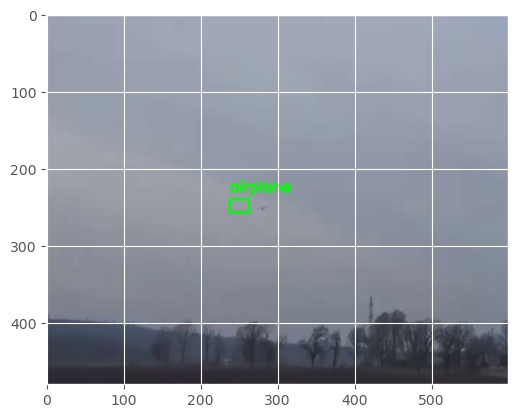

1/1 [==============================] - 0s 279ms/step


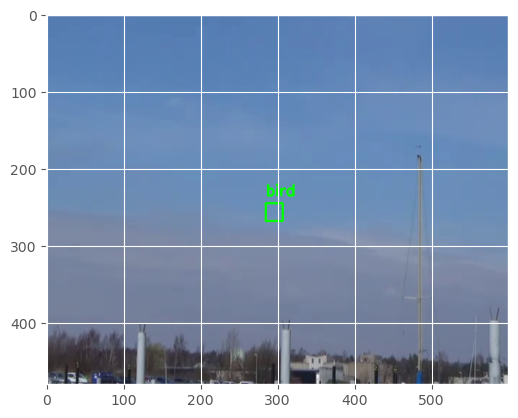

1/1 [==============================] - 0s 282ms/step


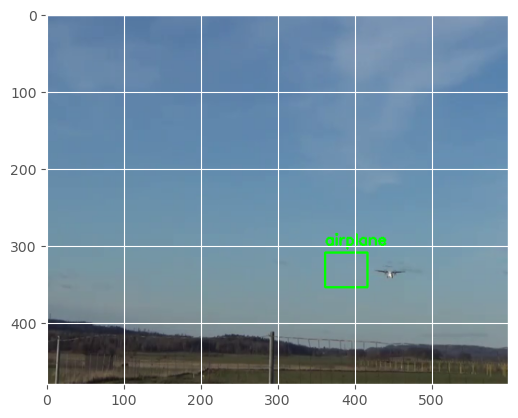

1/1 [==============================] - 0s 277ms/step


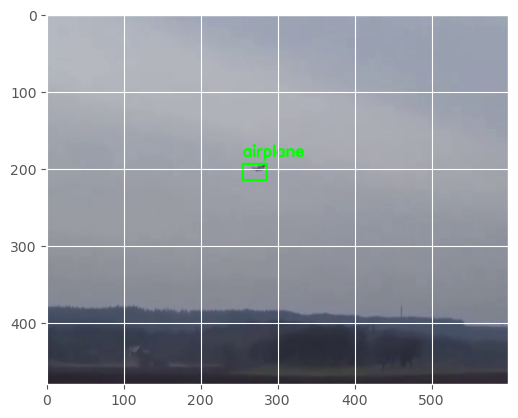

1/1 [==============================] - 0s 289ms/step


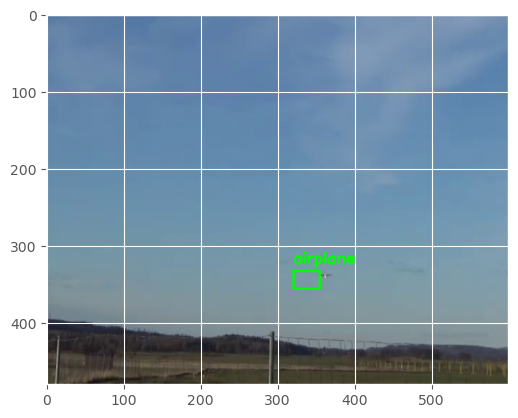

1/1 [==============================] - 0s 278ms/step


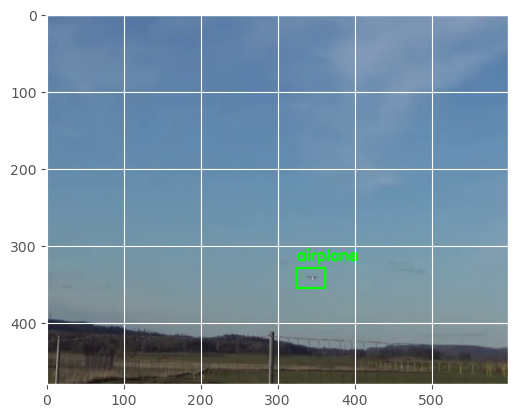

1/1 [==============================] - 0s 316ms/step


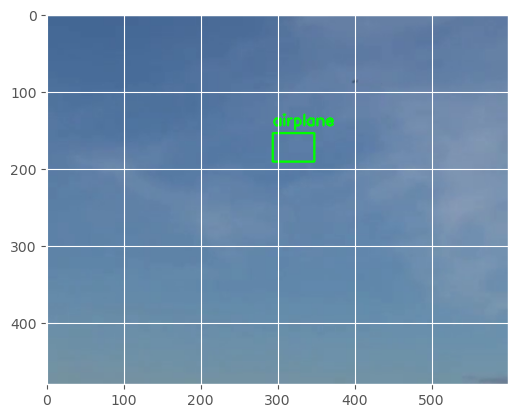

1/1 [==============================] - 0s 271ms/step


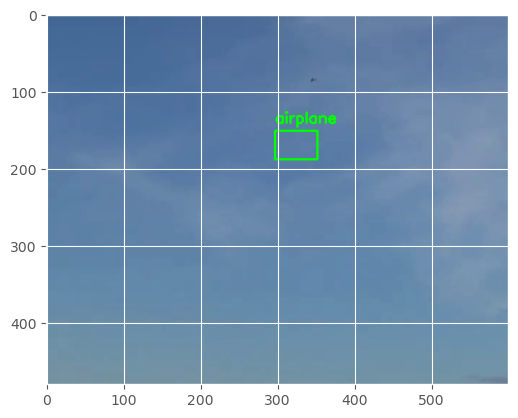

1/1 [==============================] - 0s 322ms/step


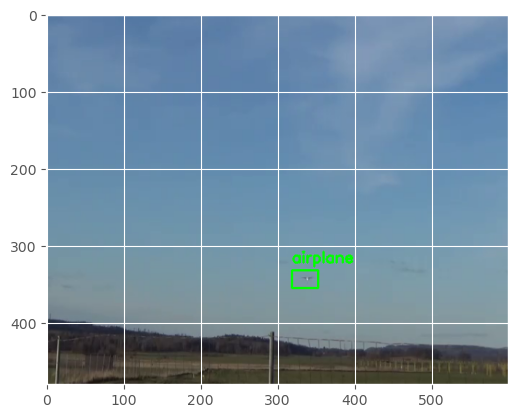

1/1 [==============================] - 0s 368ms/step


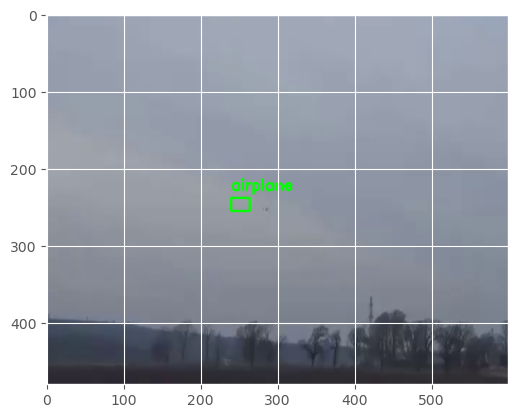

1/1 [==============================] - 0s 286ms/step


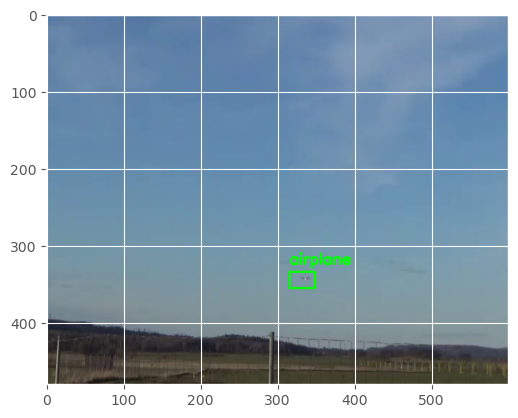

1/1 [==============================] - 0s 278ms/step


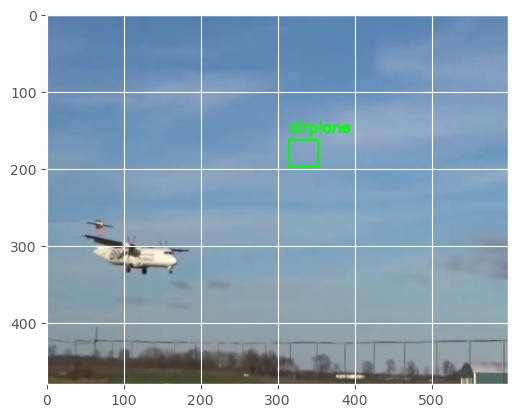

1/1 [==============================] - 0s 280ms/step


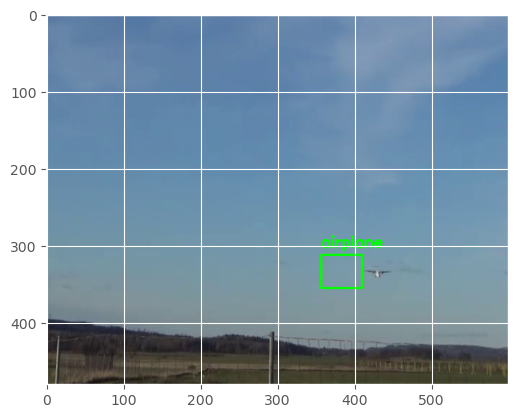

1/1 [==============================] - 0s 270ms/step


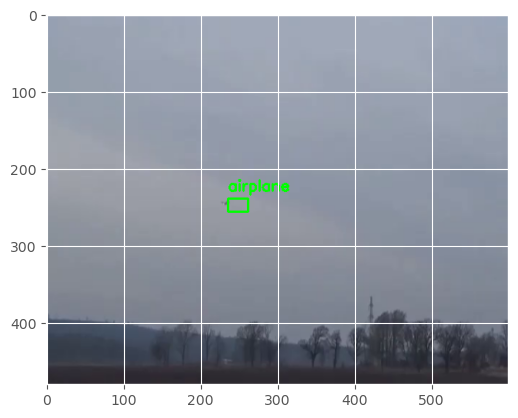

1/1 [==============================] - 0s 283ms/step


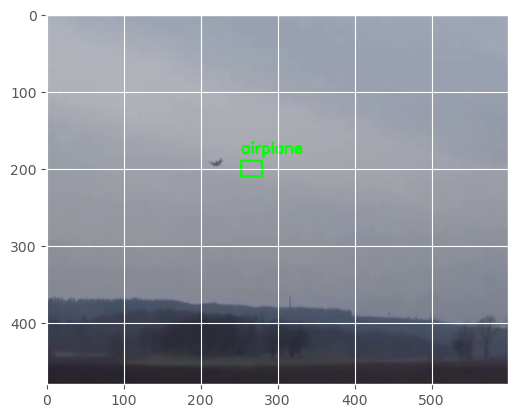

1/1 [==============================] - 0s 274ms/step


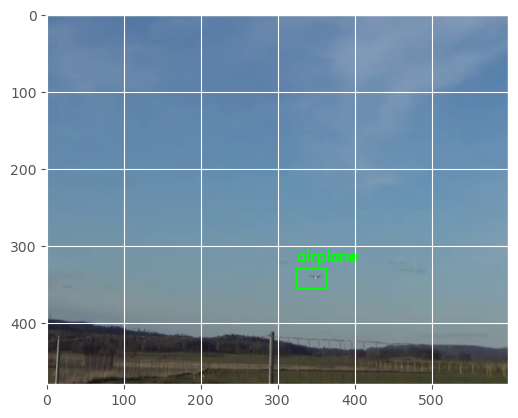

1/1 [==============================] - 0s 271ms/step


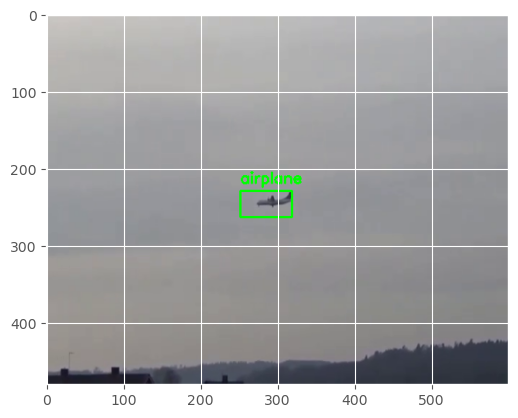

1/1 [==============================] - 0s 282ms/step


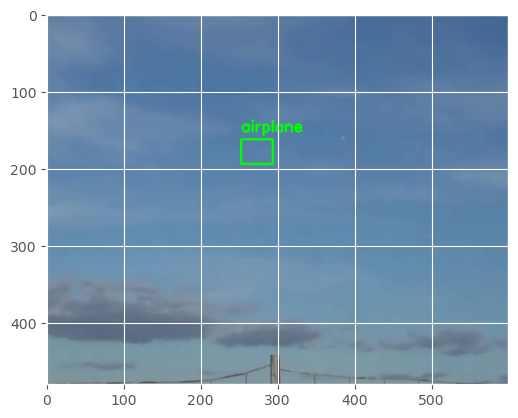

1/1 [==============================] - 0s 288ms/step


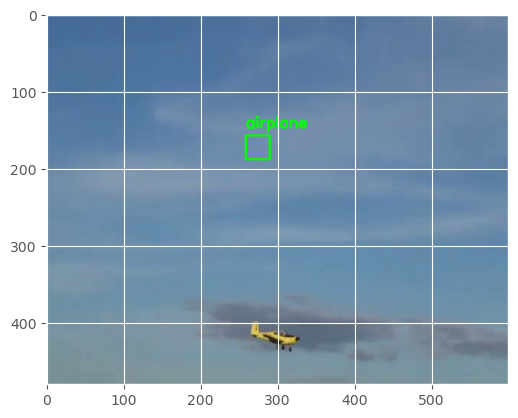

1/1 [==============================] - 0s 291ms/step


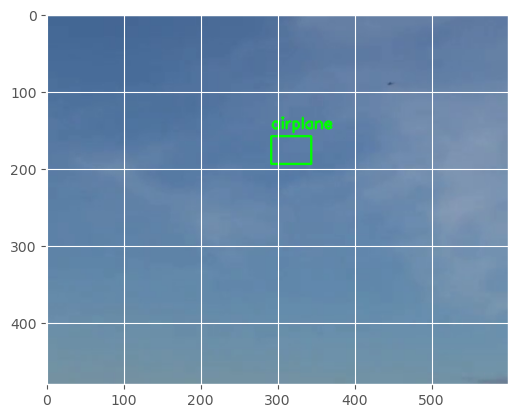

1/1 [==============================] - 0s 281ms/step


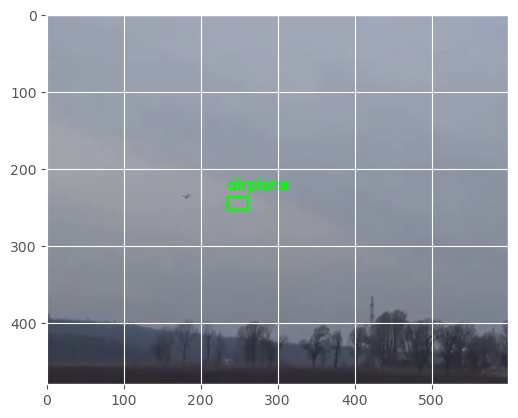

1/1 [==============================] - 0s 274ms/step


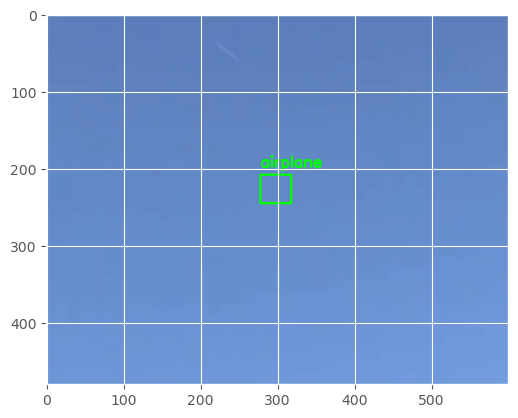

1/1 [==============================] - 0s 284ms/step


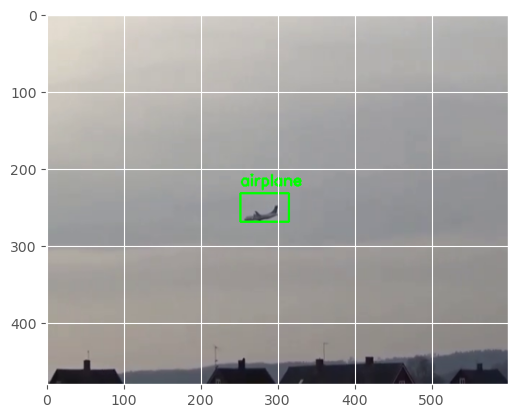

1/1 [==============================] - 0s 279ms/step


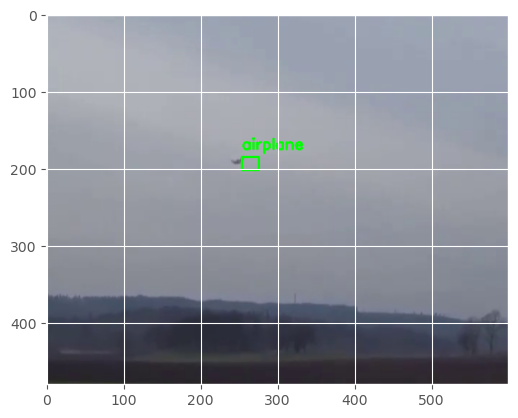

1/1 [==============================] - 0s 269ms/step


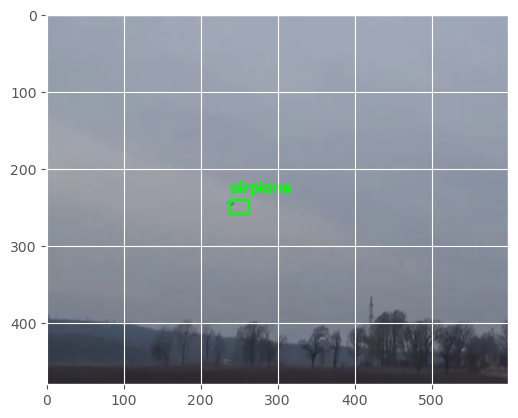

1/1 [==============================] - 0s 287ms/step


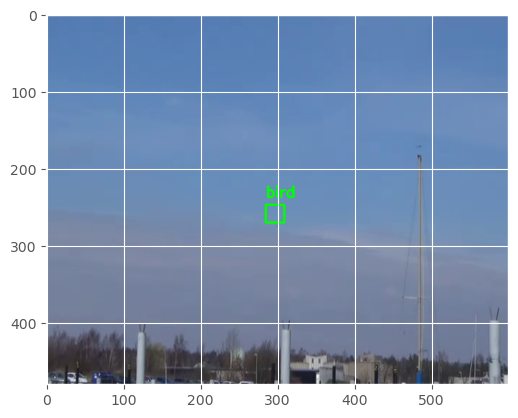

1/1 [==============================] - 0s 269ms/step


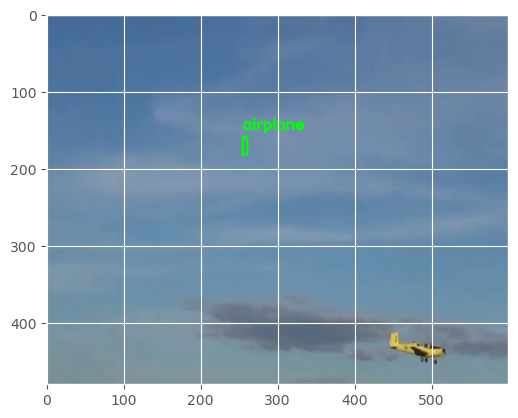

1/1 [==============================] - 0s 285ms/step


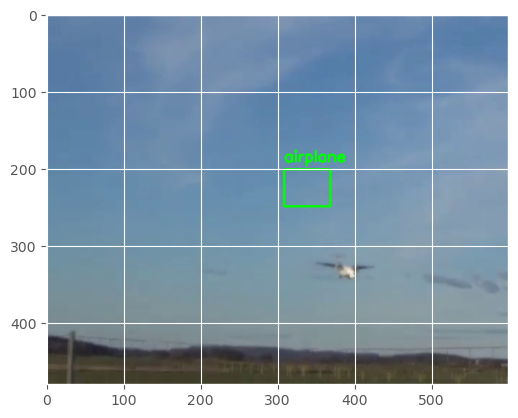

1/1 [==============================] - 0s 282ms/step


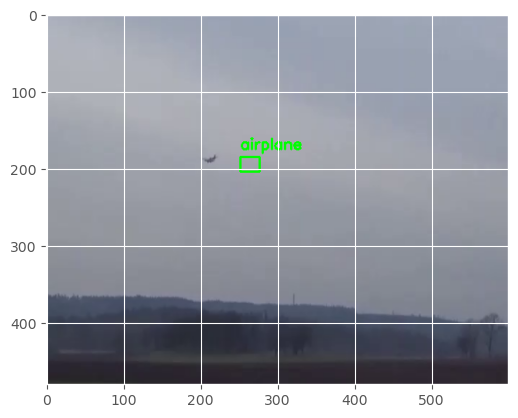

1/1 [==============================] - 0s 275ms/step


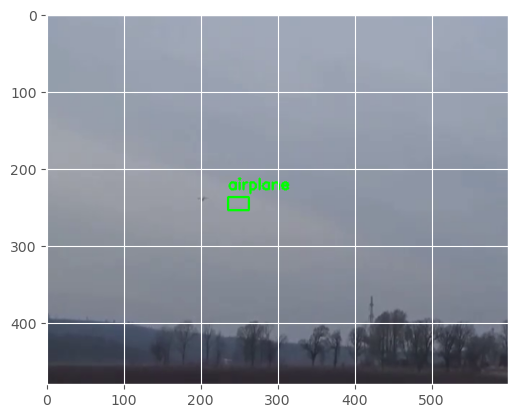

1/1 [==============================] - 0s 285ms/step


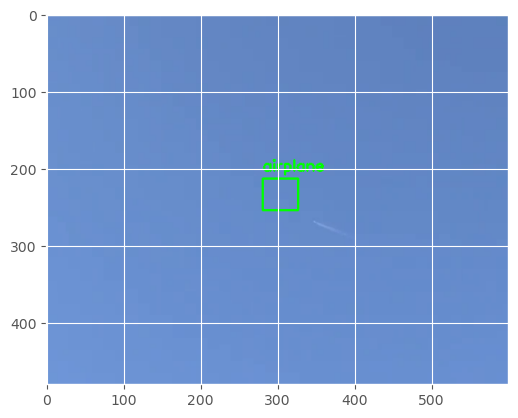

1/1 [==============================] - 0s 284ms/step


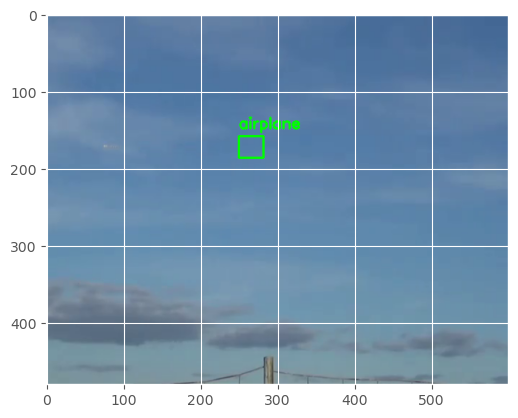

1/1 [==============================] - 0s 277ms/step


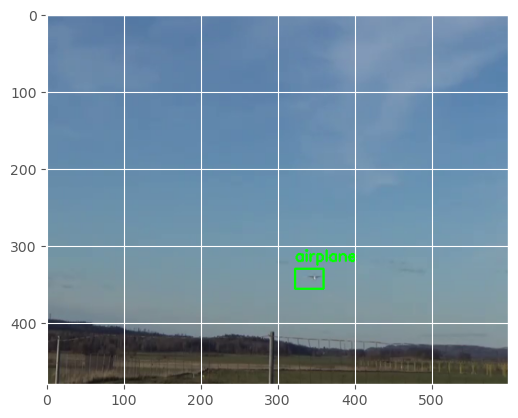

1/1 [==============================] - 0s 288ms/step


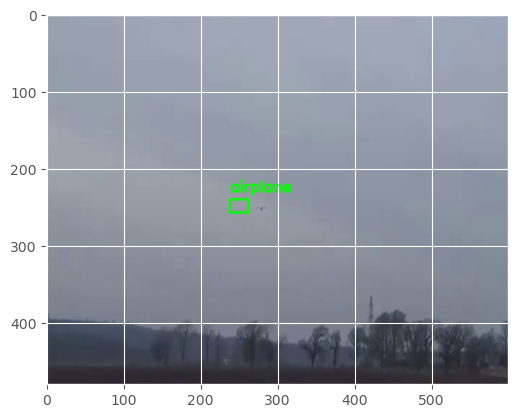

1/1 [==============================] - 0s 277ms/step


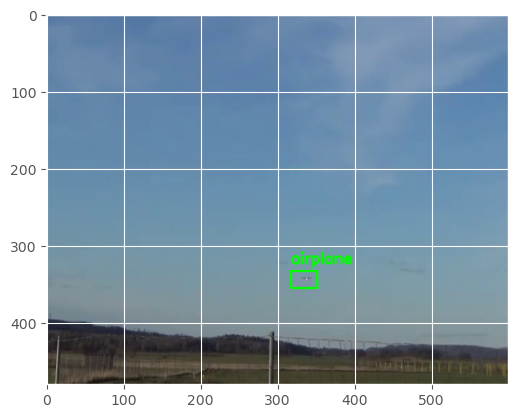

1/1 [==============================] - 0s 278ms/step


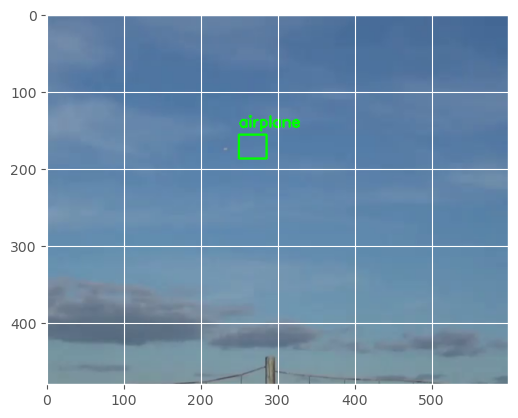

1/1 [==============================] - 0s 277ms/step


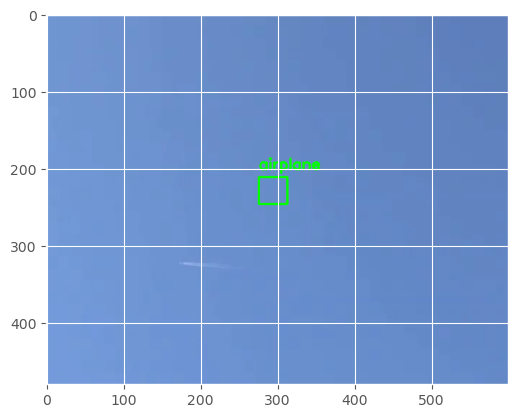

1/1 [==============================] - 0s 283ms/step


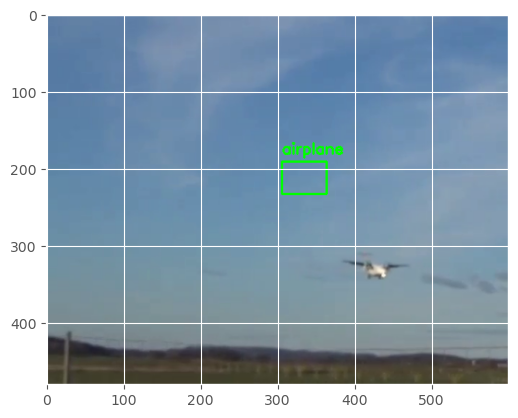

1/1 [==============================] - 0s 280ms/step


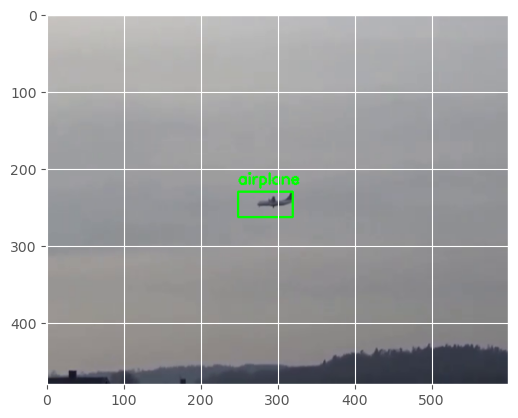

1/1 [==============================] - 0s 274ms/step


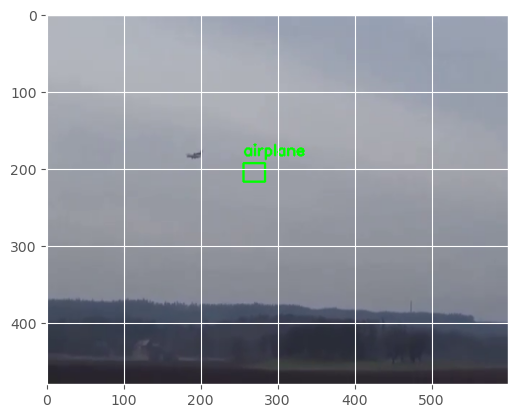

1/1 [==============================] - 0s 275ms/step


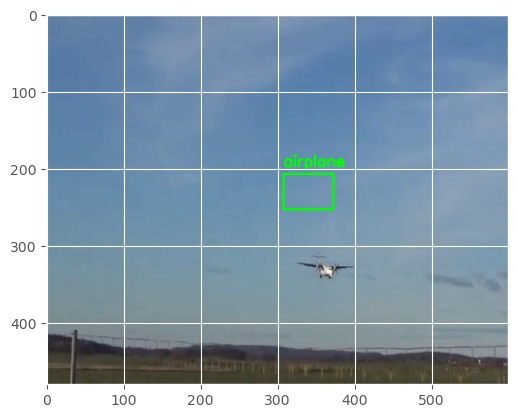

1/1 [==============================] - 0s 276ms/step


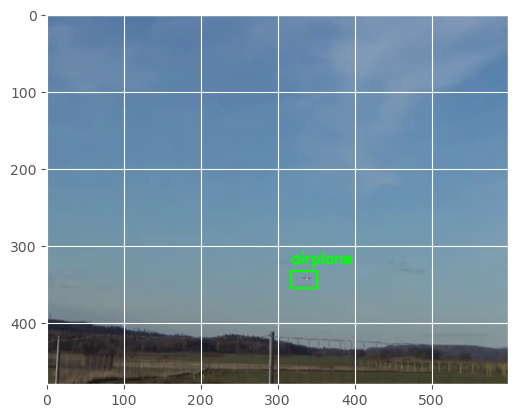

1/1 [==============================] - 0s 273ms/step


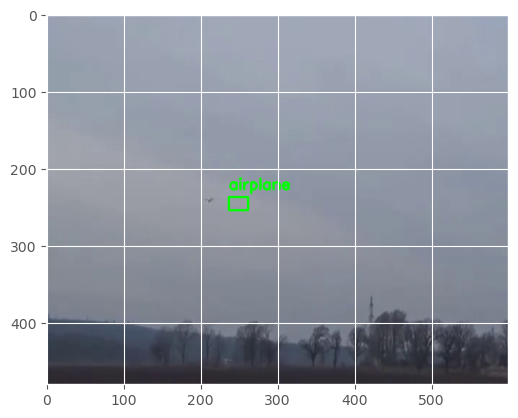

1/1 [==============================] - 0s 275ms/step


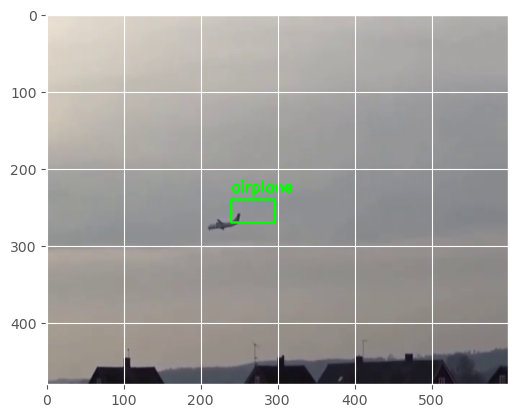

1/1 [==============================] - 0s 276ms/step


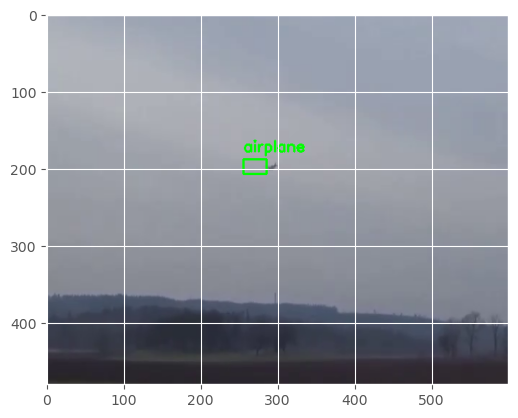

1/1 [==============================] - 0s 299ms/step


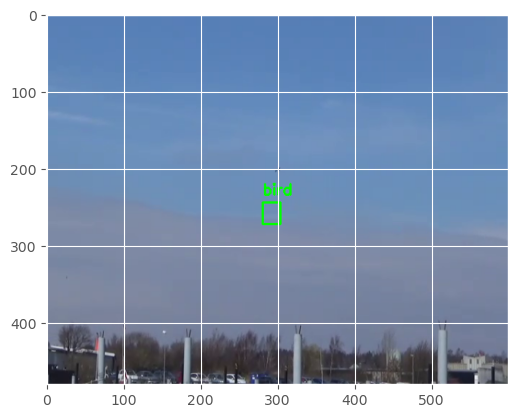

1/1 [==============================] - 0s 293ms/step


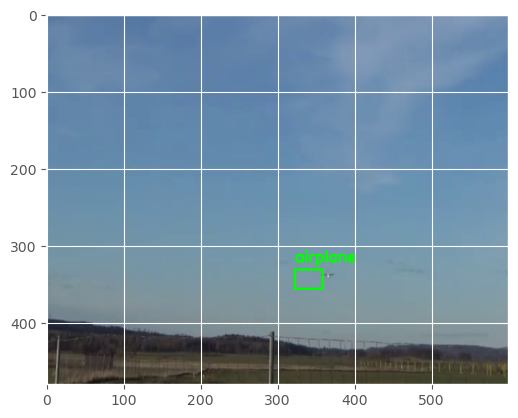

1/1 [==============================] - 0s 278ms/step


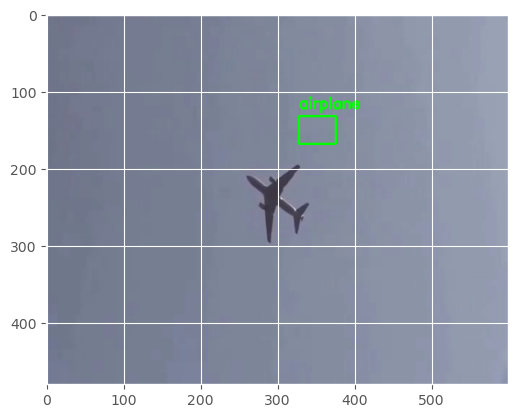

1/1 [==============================] - 0s 288ms/step


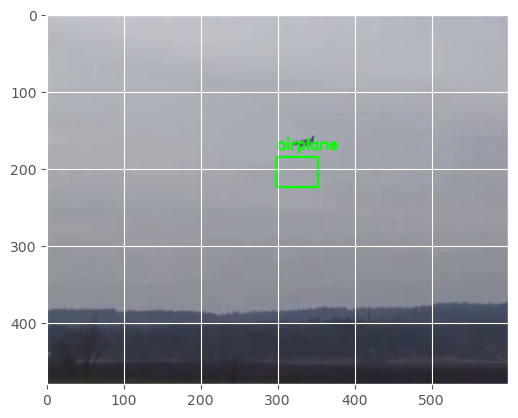

1/1 [==============================] - 0s 287ms/step


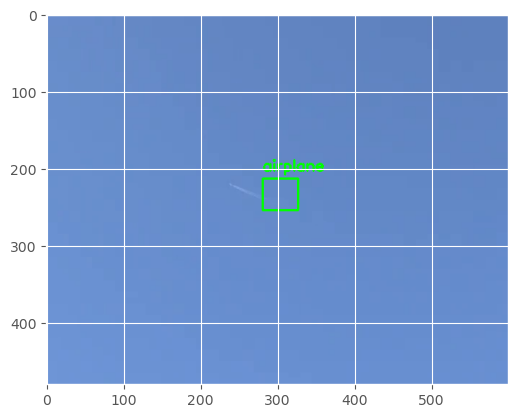

1/1 [==============================] - 0s 295ms/step


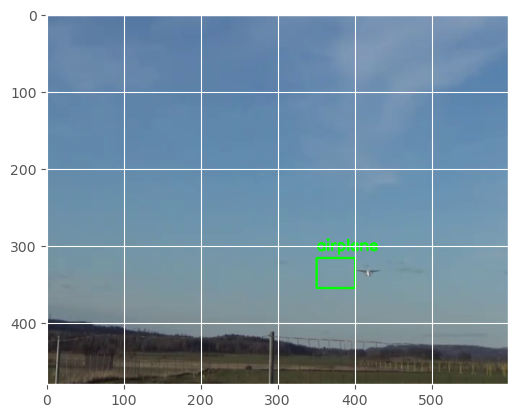

1/1 [==============================] - 0s 286ms/step


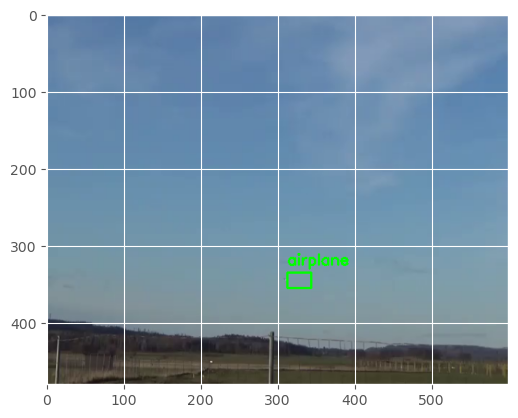

1/1 [==============================] - 0s 282ms/step


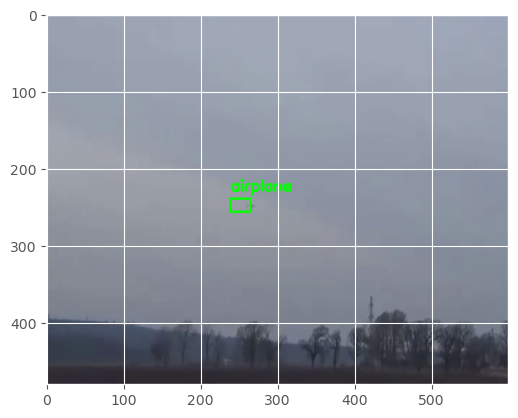

1/1 [==============================] - 0s 284ms/step


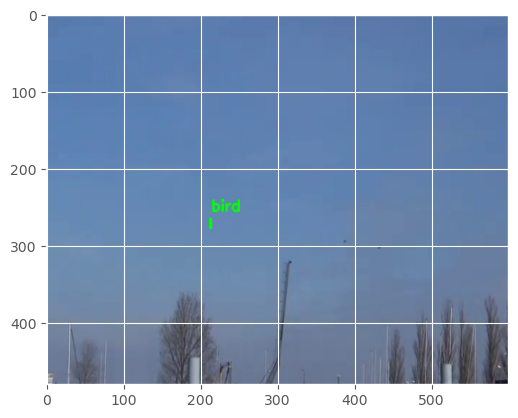

1/1 [==============================] - 0s 283ms/step


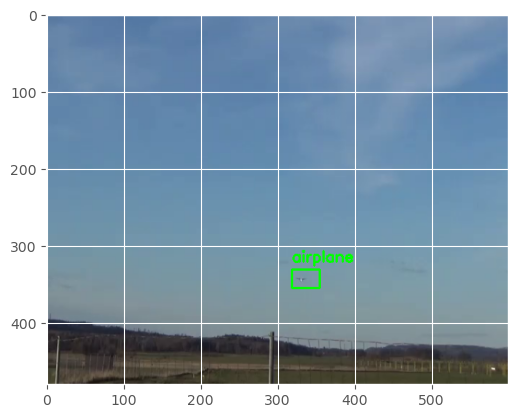

1/1 [==============================] - 0s 301ms/step


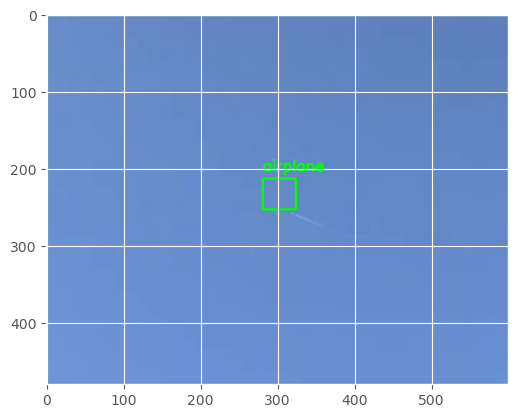

1/1 [==============================] - 0s 284ms/step


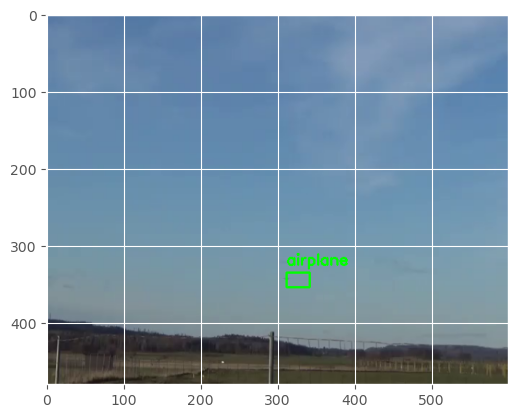

1/1 [==============================] - 0s 285ms/step


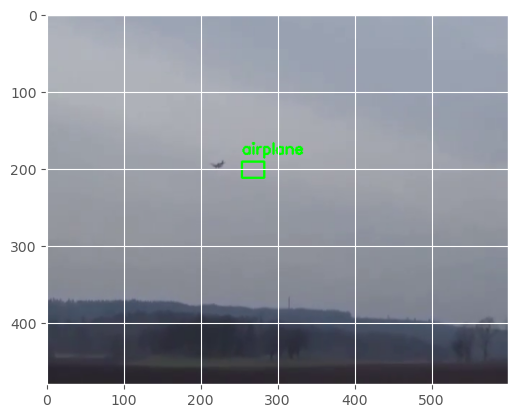

1/1 [==============================] - 0s 282ms/step


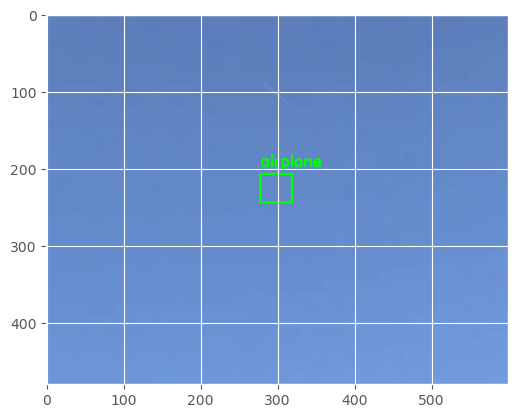

1/1 [==============================] - 0s 284ms/step


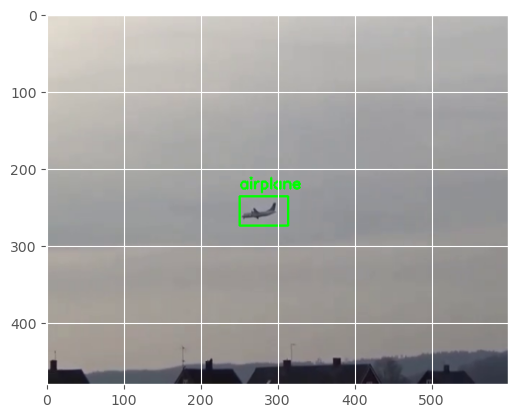

1/1 [==============================] - 0s 287ms/step


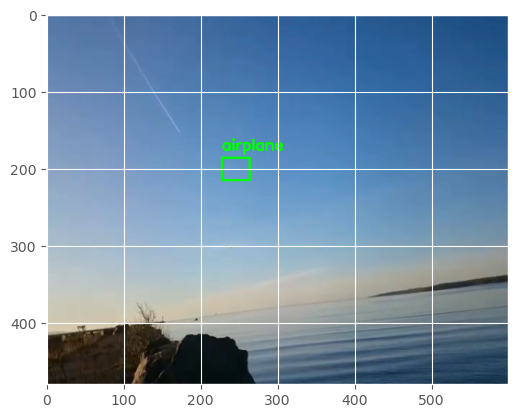

1/1 [==============================] - 0s 279ms/step


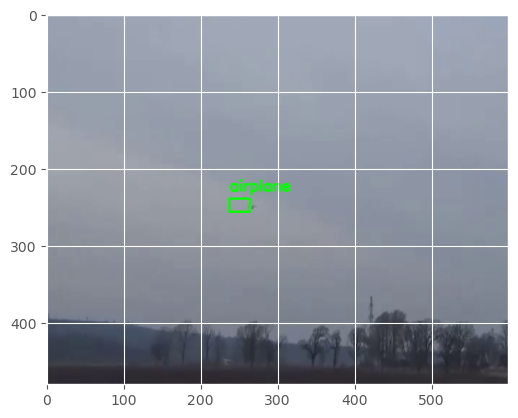

1/1 [==============================] - 0s 284ms/step


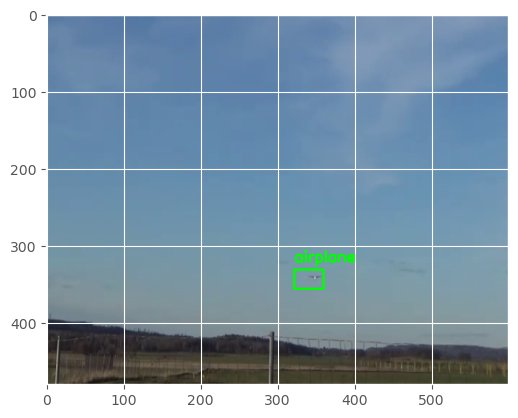

1/1 [==============================] - 0s 283ms/step


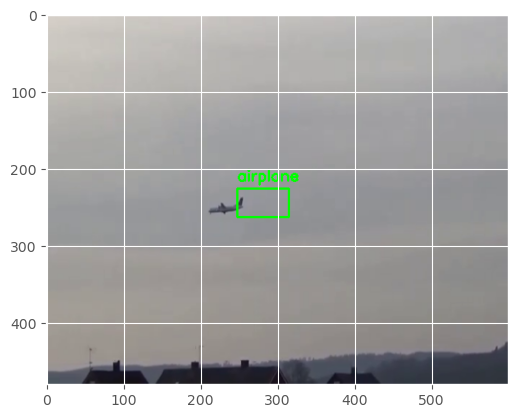

1/1 [==============================] - 0s 325ms/step


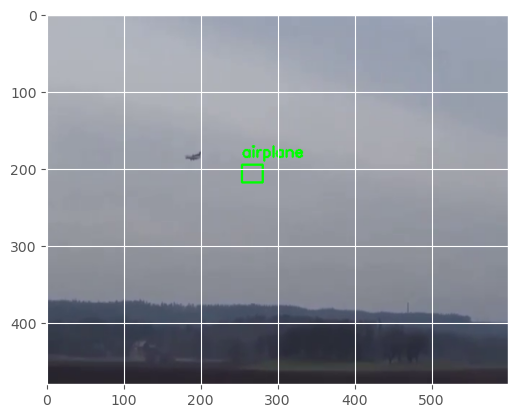

1/1 [==============================] - 0s 370ms/step


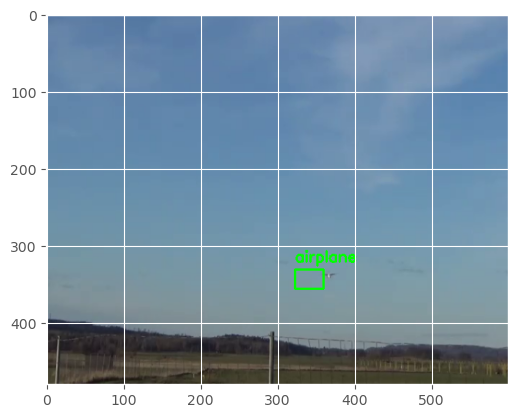

1/1 [==============================] - 0s 282ms/step


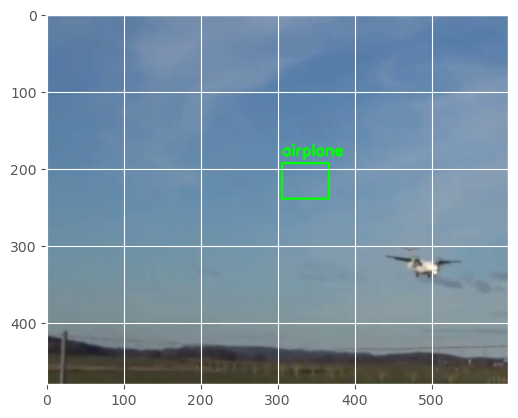

1/1 [==============================] - 0s 284ms/step


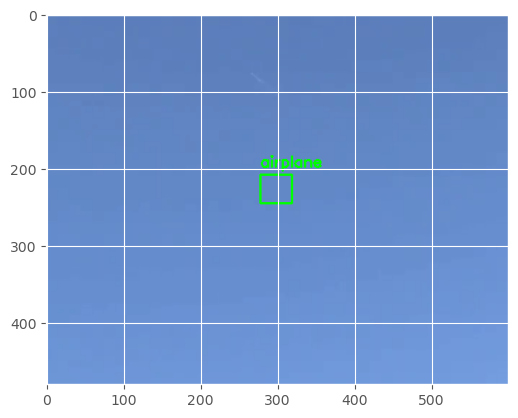

1/1 [==============================] - 0s 278ms/step


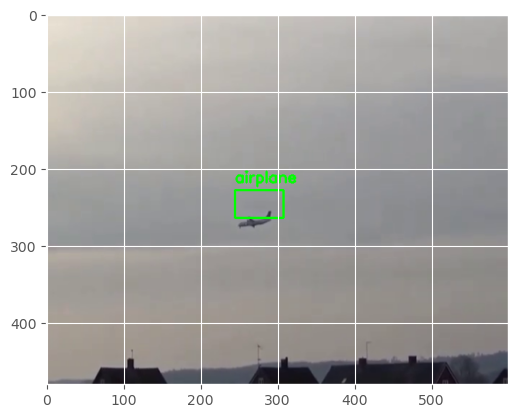

1/1 [==============================] - 0s 290ms/step


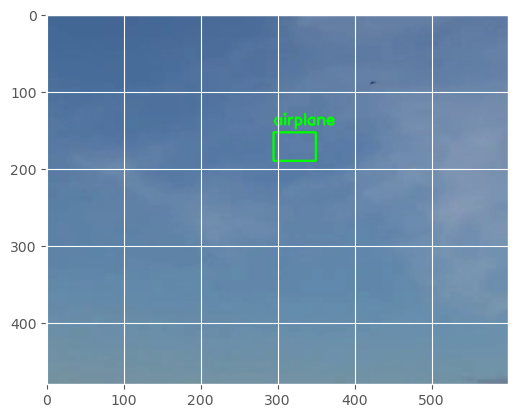

1/1 [==============================] - 0s 292ms/step


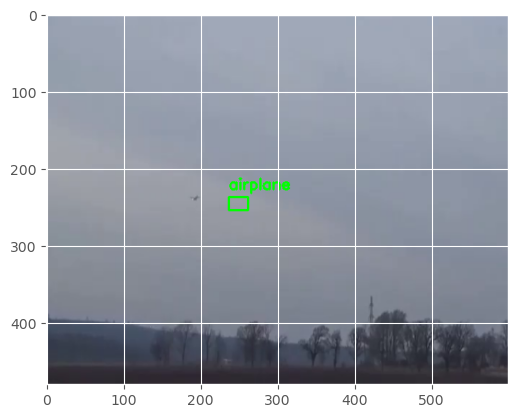

1/1 [==============================] - 0s 291ms/step


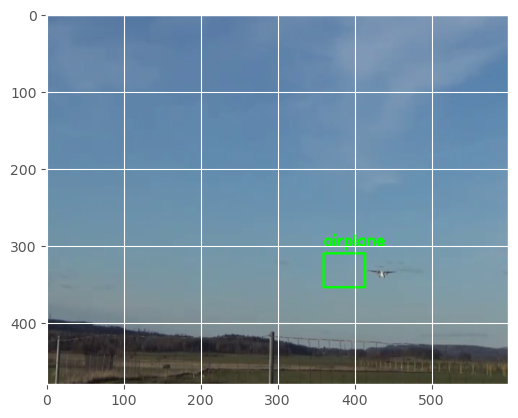

1/1 [==============================] - 0s 281ms/step


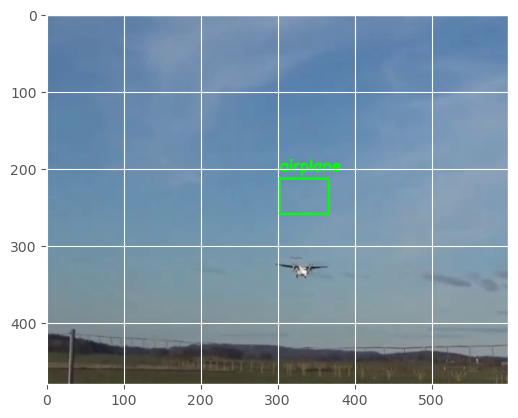

1/1 [==============================] - 0s 285ms/step


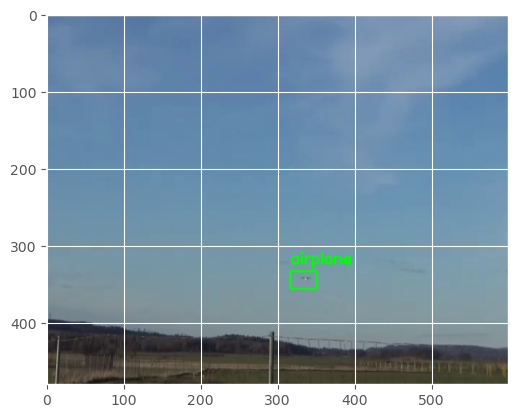

1/1 [==============================] - 0s 288ms/step


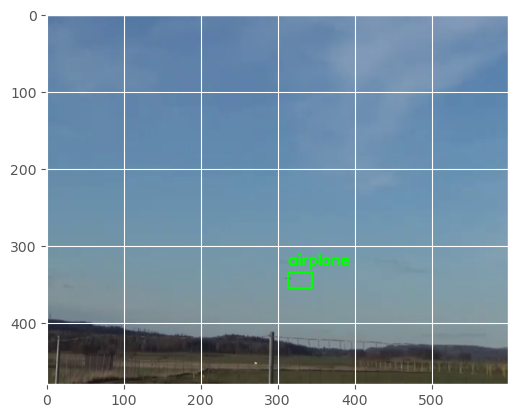

1/1 [==============================] - 0s 289ms/step


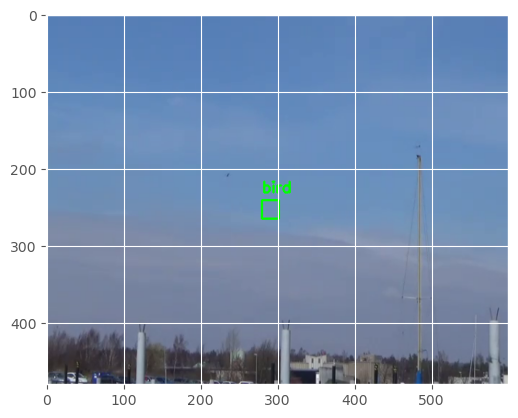

1/1 [==============================] - 0s 283ms/step


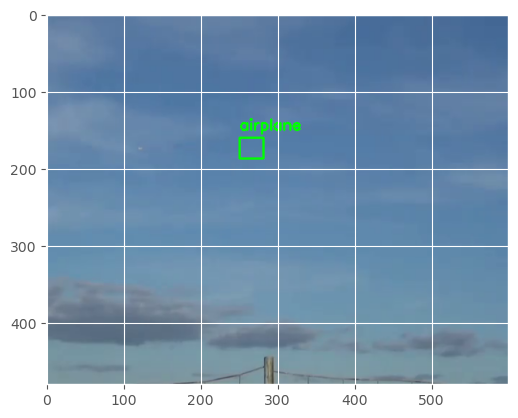

1/1 [==============================] - 0s 282ms/step


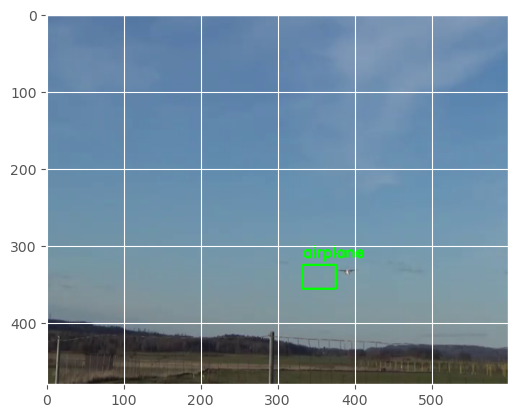

1/1 [==============================] - 0s 295ms/step


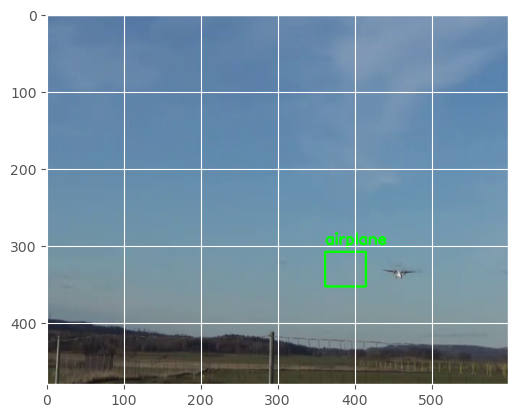

1/1 [==============================] - 0s 288ms/step


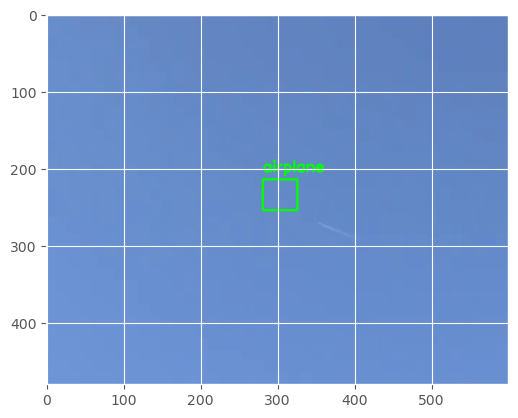

1/1 [==============================] - 0s 287ms/step


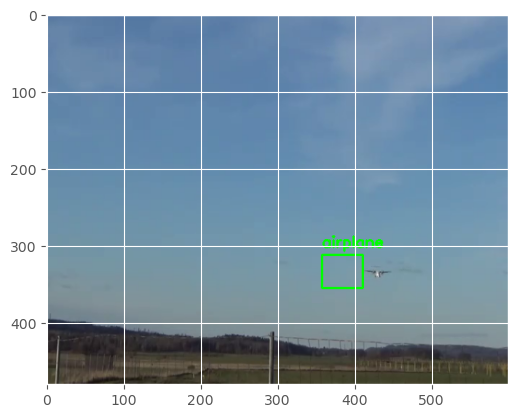

1/1 [==============================] - 0s 320ms/step


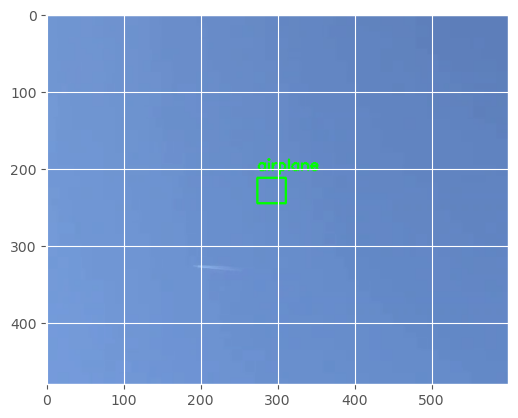

1/1 [==============================] - 0s 285ms/step


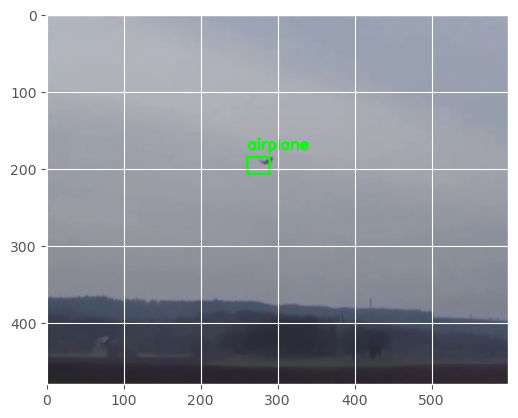

1/1 [==============================] - 0s 280ms/step


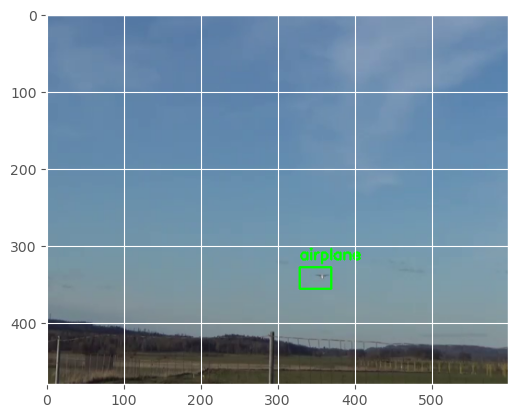

1/1 [==============================] - 0s 293ms/step


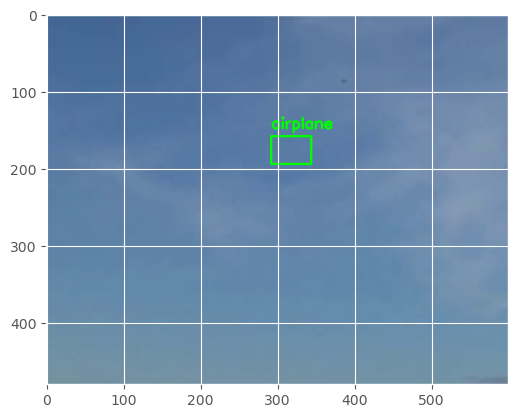

1/1 [==============================] - 0s 289ms/step


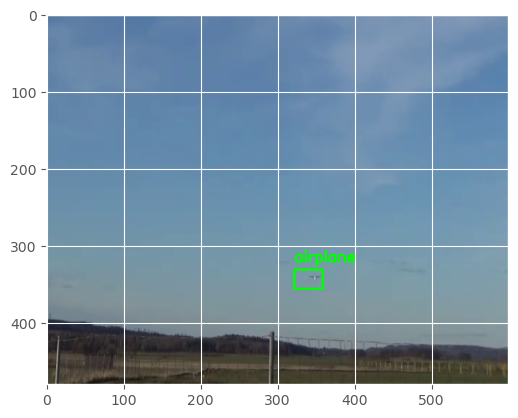

1/1 [==============================] - 0s 285ms/step


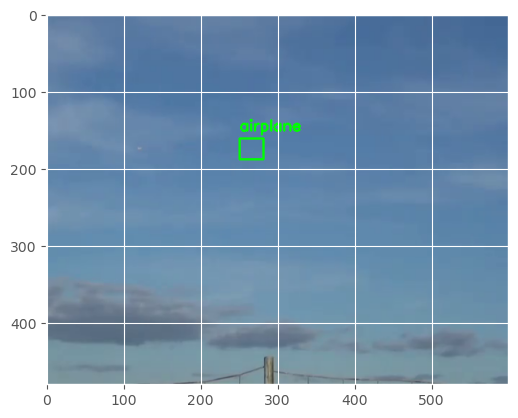

1/1 [==============================] - 0s 289ms/step


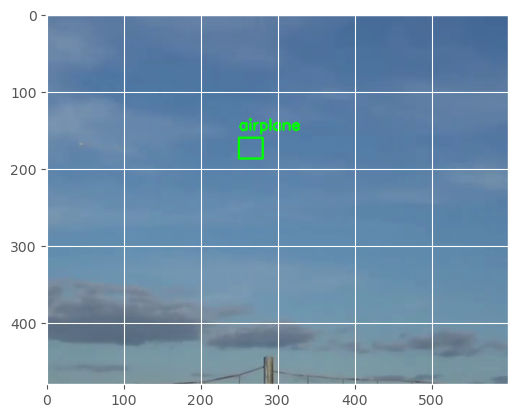

1/1 [==============================] - 0s 287ms/step


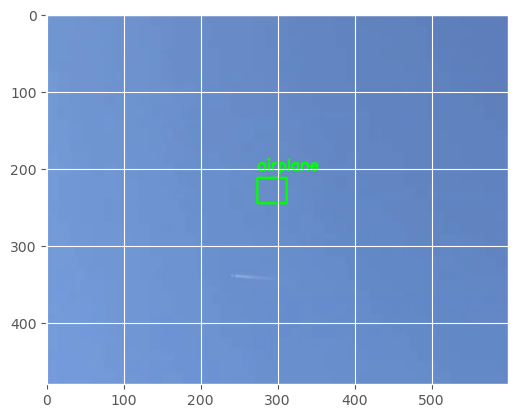

1/1 [==============================] - 0s 284ms/step


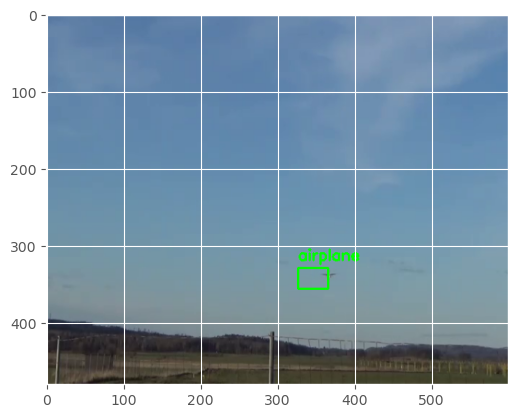

1/1 [==============================] - 0s 284ms/step


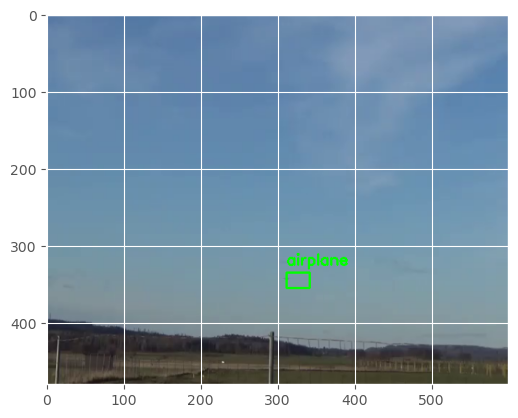

1/1 [==============================] - 0s 289ms/step


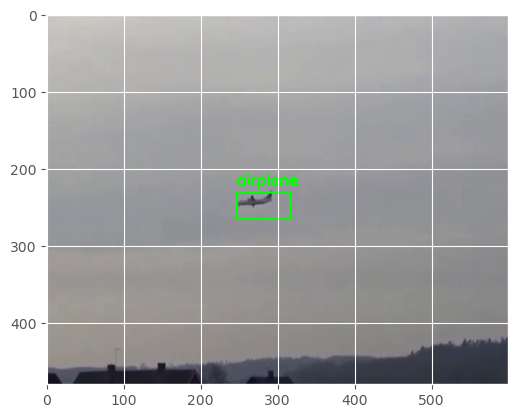

1/1 [==============================] - 0s 290ms/step


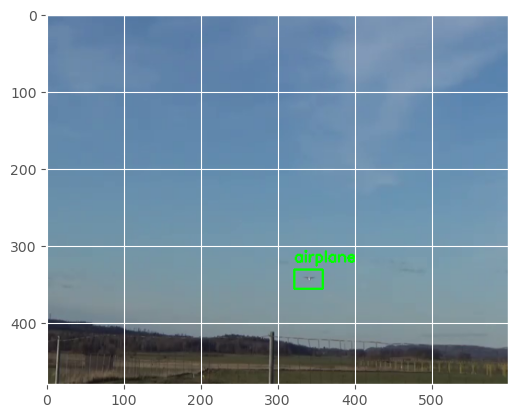

1/1 [==============================] - 0s 288ms/step


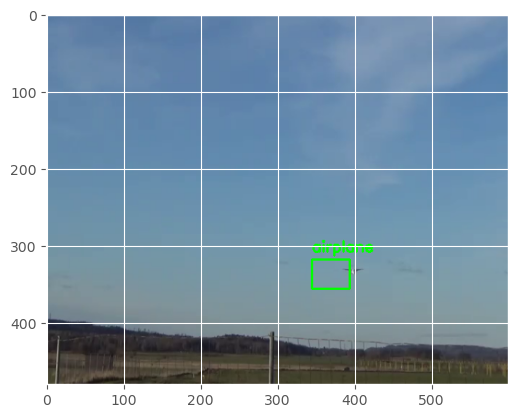

1/1 [==============================] - 0s 287ms/step


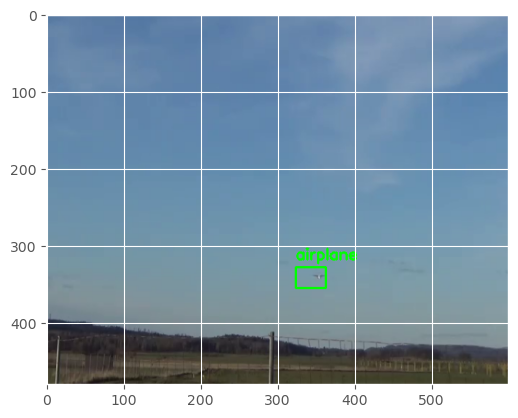

1/1 [==============================] - 0s 288ms/step


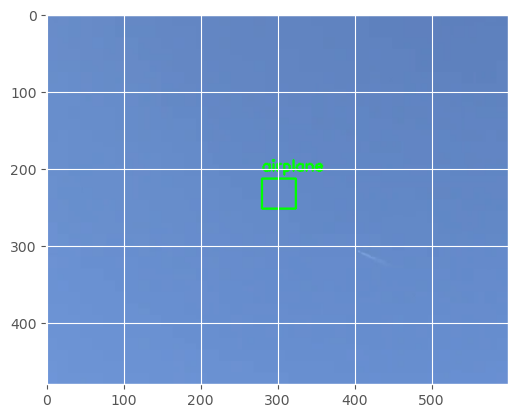

1/1 [==============================] - 0s 291ms/step


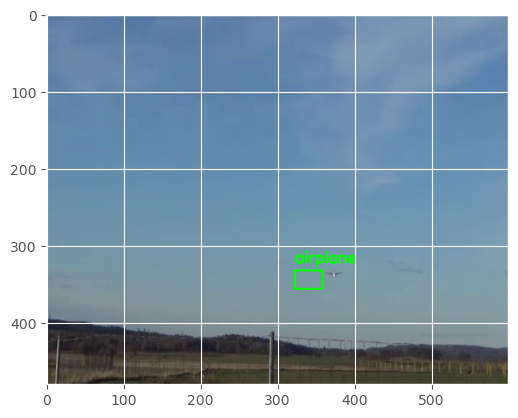

1/1 [==============================] - 0s 288ms/step


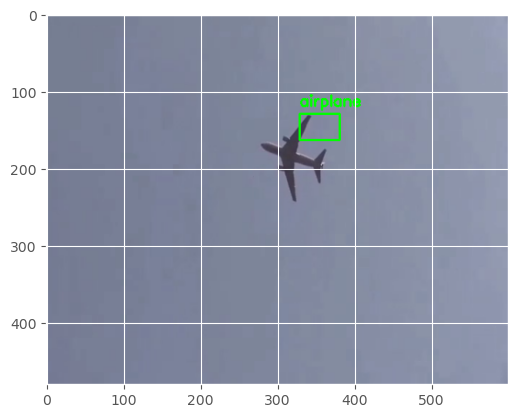

1/1 [==============================] - 0s 286ms/step


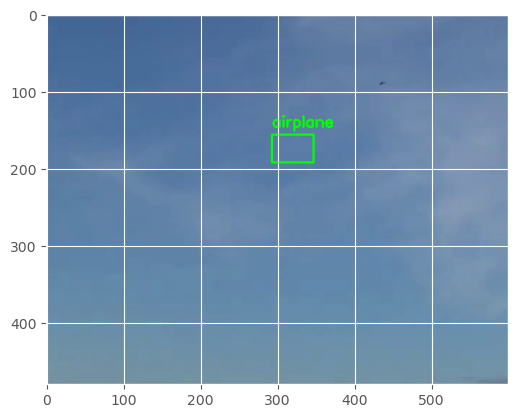

1/1 [==============================] - 0s 289ms/step


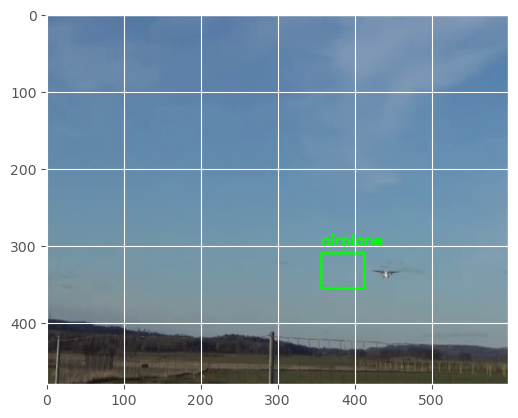

1/1 [==============================] - 0s 285ms/step


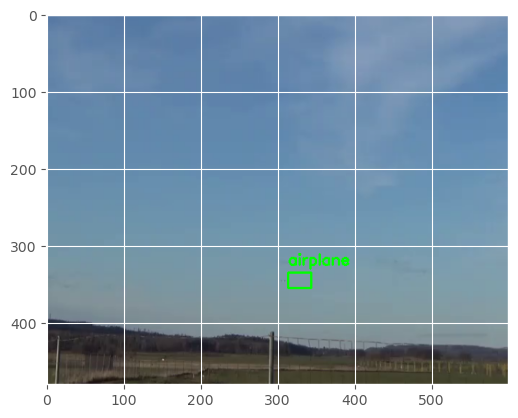

1/1 [==============================] - 0s 283ms/step


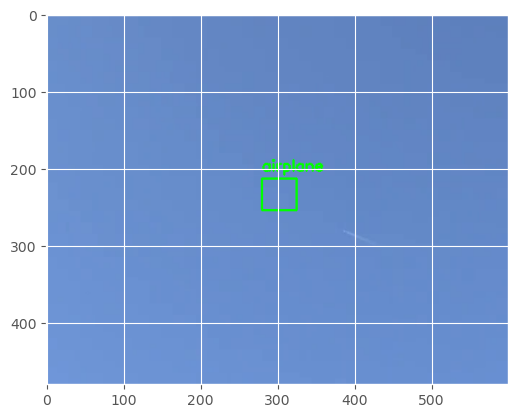

1/1 [==============================] - 0s 281ms/step


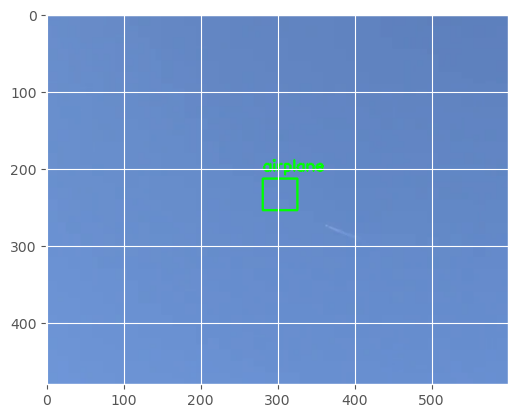

1/1 [==============================] - 0s 285ms/step


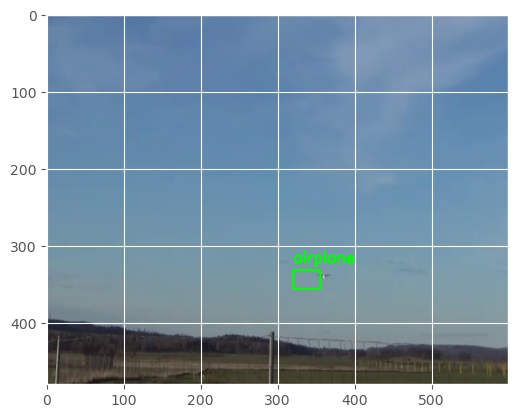

1/1 [==============================] - 0s 286ms/step


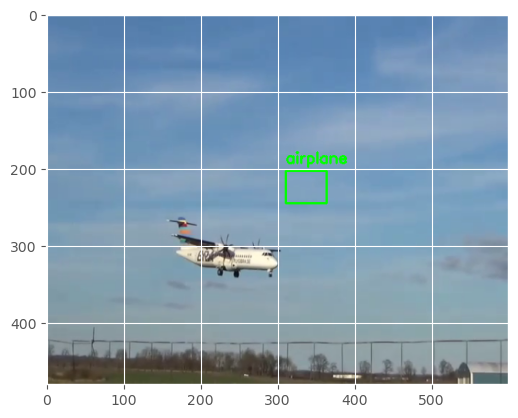

1/1 [==============================] - 0s 285ms/step


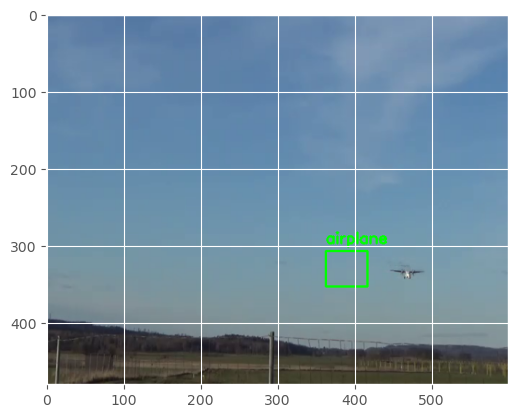

1/1 [==============================] - 0s 283ms/step


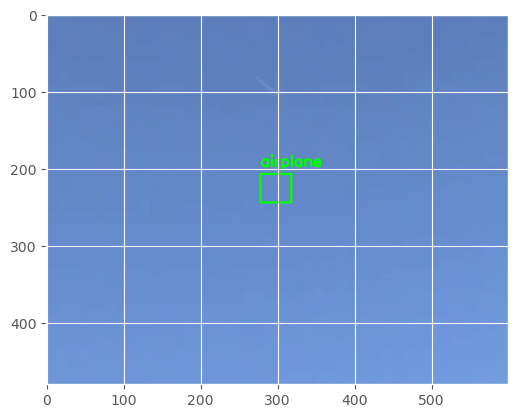

1/1 [==============================] - 0s 282ms/step


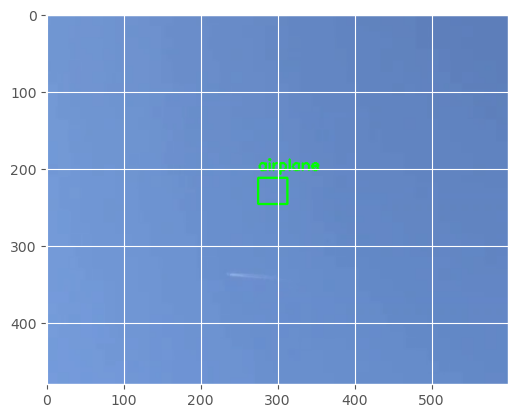

1/1 [==============================] - 0s 281ms/step


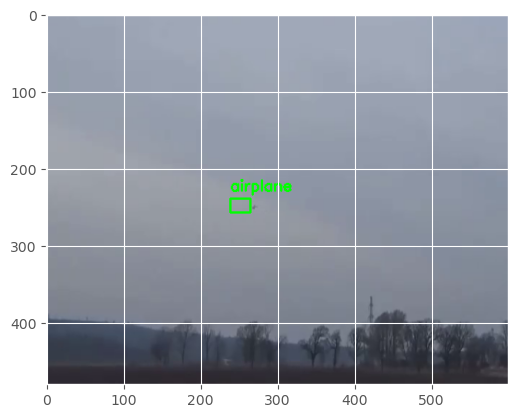

1/1 [==============================] - 0s 291ms/step


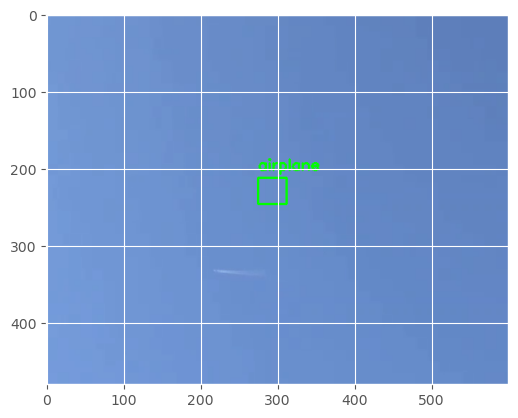

1/1 [==============================] - 0s 280ms/step


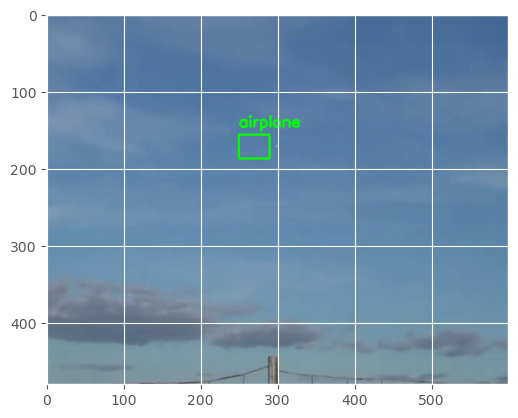

1/1 [==============================] - 0s 282ms/step


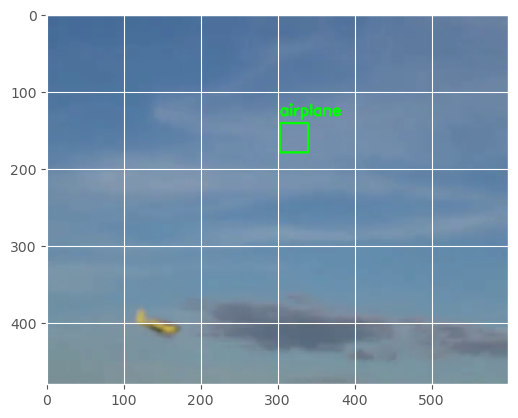

1/1 [==============================] - 0s 280ms/step


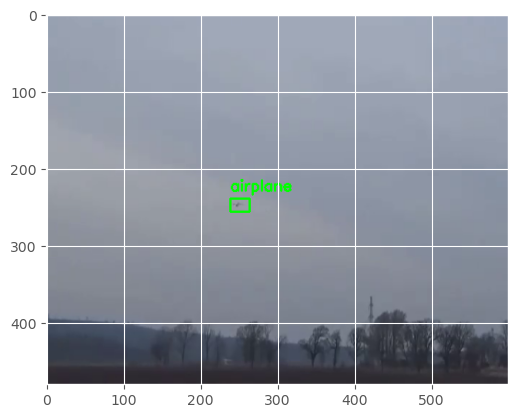

1/1 [==============================] - 0s 284ms/step


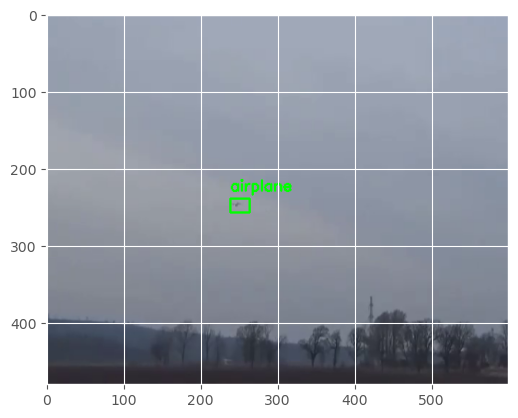

1/1 [==============================] - 0s 385ms/step


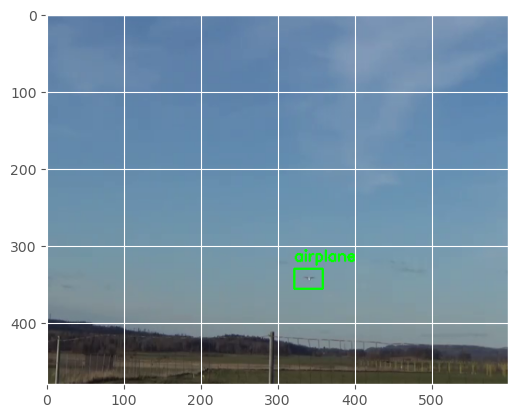

1/1 [==============================] - 0s 363ms/step


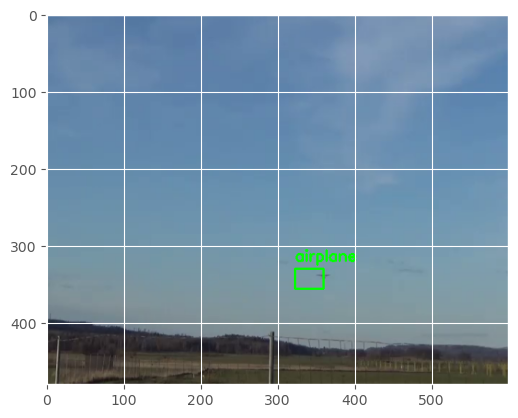

1/1 [==============================] - 0s 318ms/step


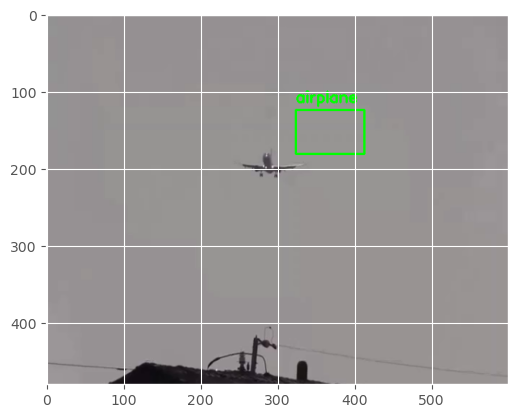

1/1 [==============================] - 0s 286ms/step


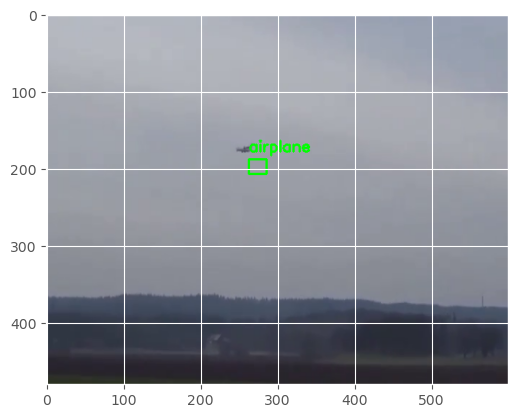

1/1 [==============================] - 0s 286ms/step


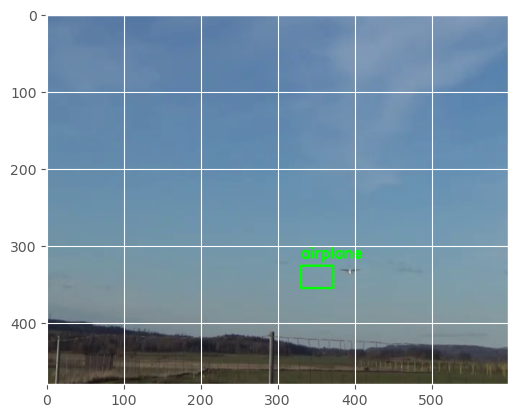

1/1 [==============================] - 0s 278ms/step


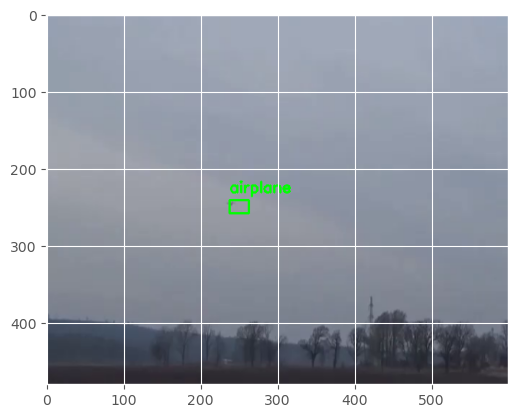

1/1 [==============================] - 0s 284ms/step


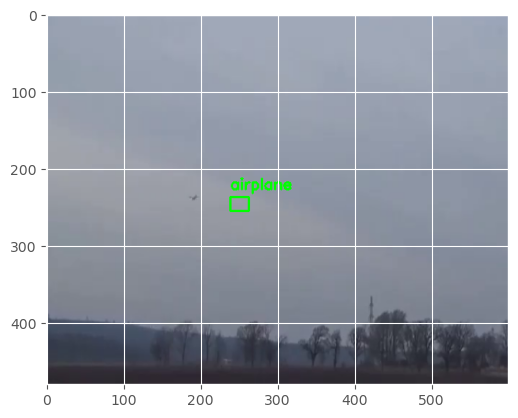

1/1 [==============================] - 0s 278ms/step


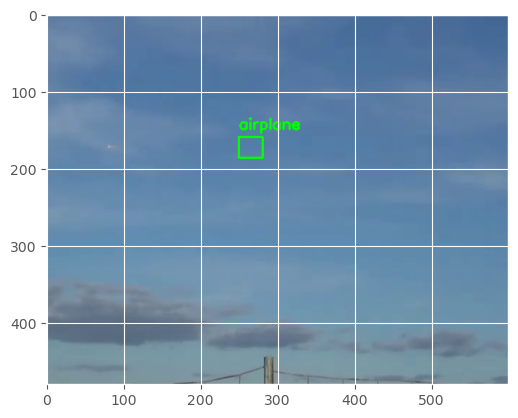

1/1 [==============================] - 0s 287ms/step


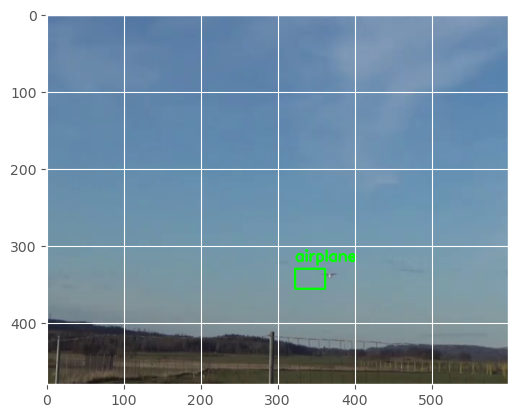

1/1 [==============================] - 0s 289ms/step


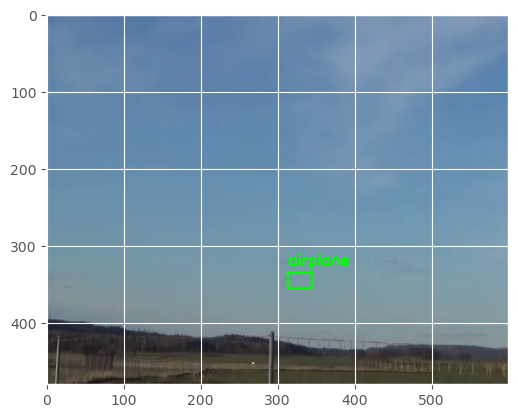

1/1 [==============================] - 0s 287ms/step


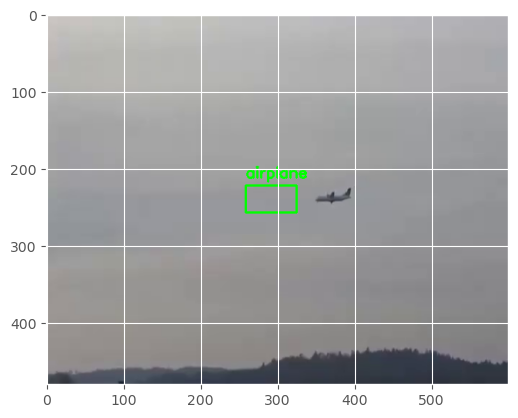

1/1 [==============================] - 0s 285ms/step


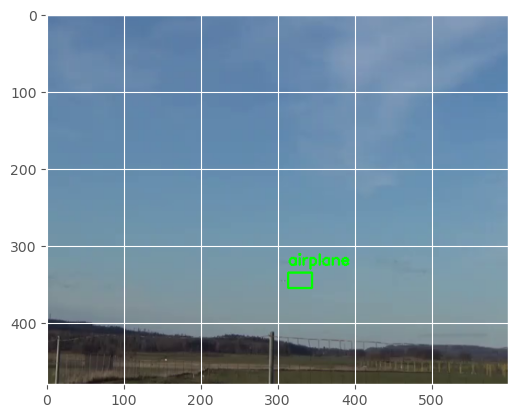

1/1 [==============================] - 0s 293ms/step


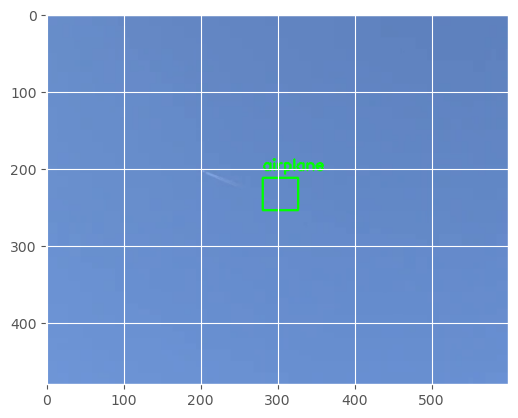

1/1 [==============================] - 0s 285ms/step


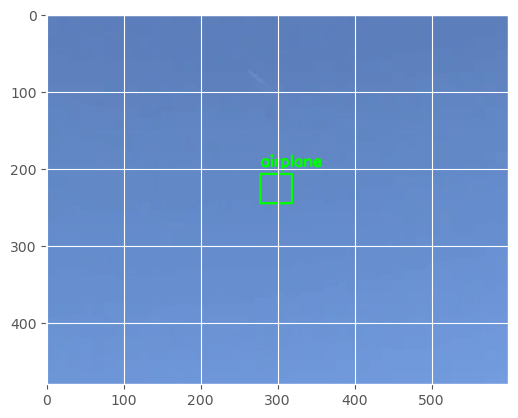

1/1 [==============================] - 0s 288ms/step


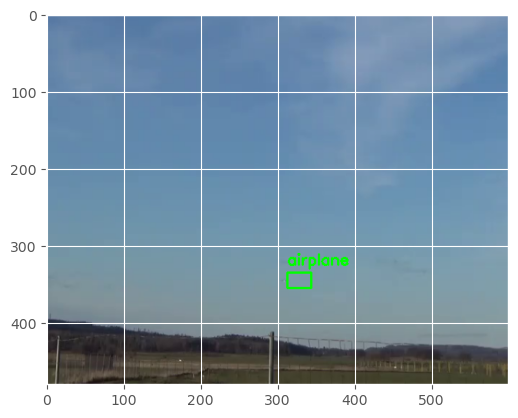

1/1 [==============================] - 0s 283ms/step


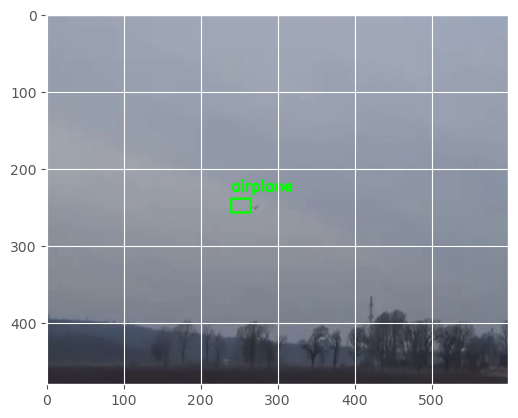

1/1 [==============================] - 0s 290ms/step


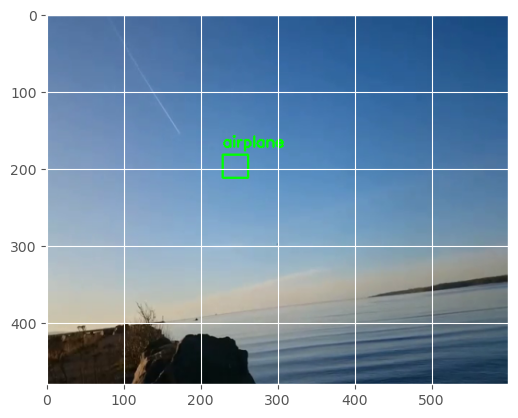

1/1 [==============================] - 0s 287ms/step


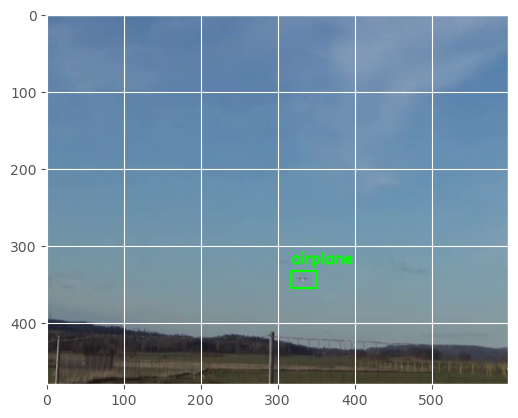

1/1 [==============================] - 0s 282ms/step


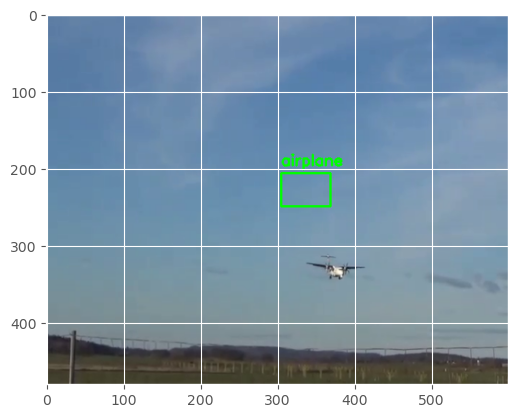

1/1 [==============================] - 0s 320ms/step


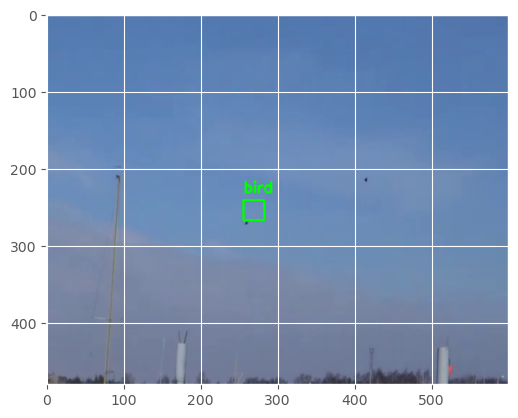

1/1 [==============================] - 0s 284ms/step


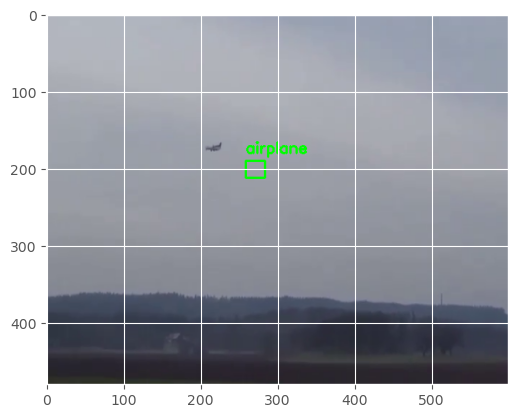

1/1 [==============================] - 0s 282ms/step


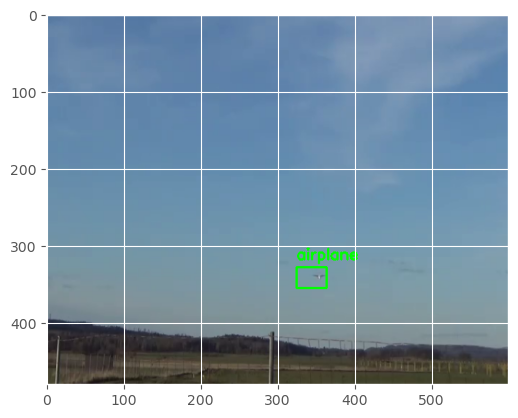

1/1 [==============================] - 0s 278ms/step


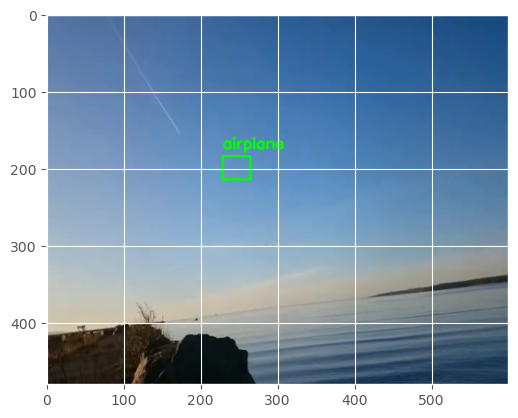

1/1 [==============================] - 0s 282ms/step


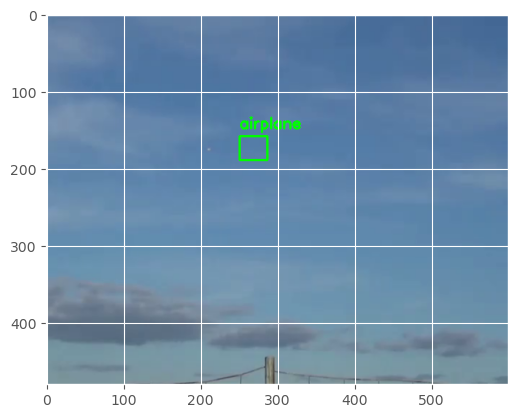

1/1 [==============================] - 0s 279ms/step


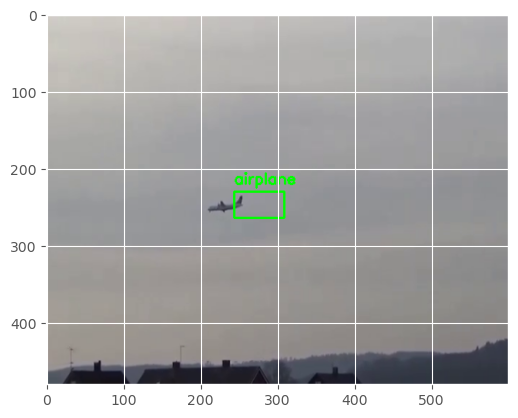

1/1 [==============================] - 0s 276ms/step


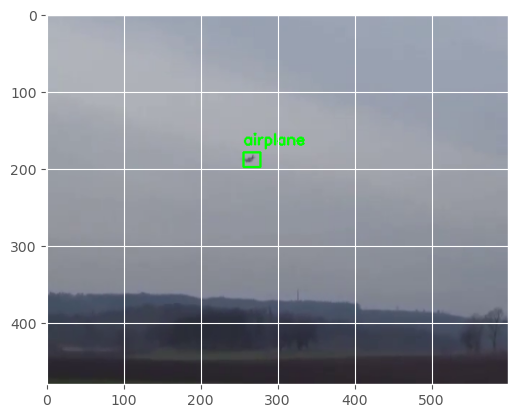

1/1 [==============================] - 0s 274ms/step


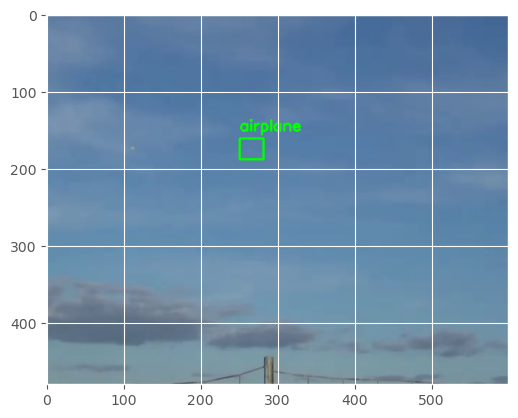

1/1 [==============================] - 0s 287ms/step


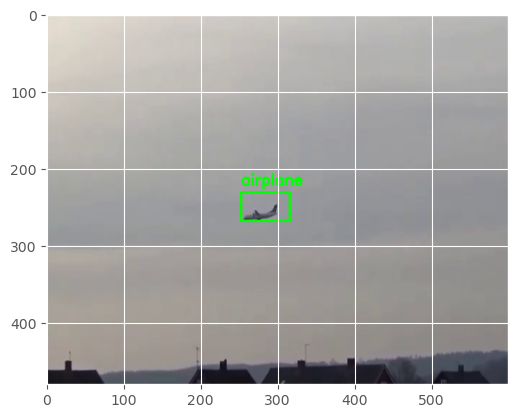

1/1 [==============================] - 0s 287ms/step


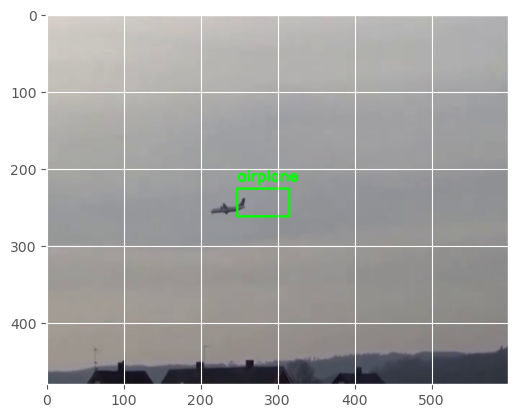

1/1 [==============================] - 0s 288ms/step


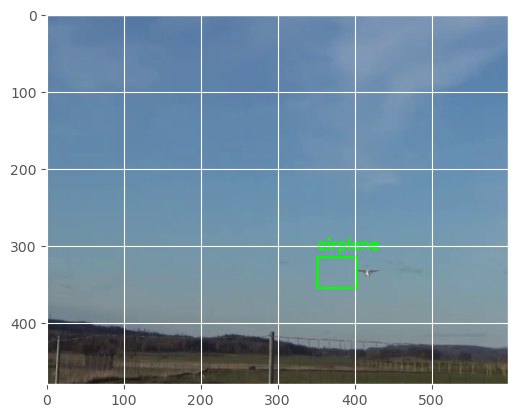

1/1 [==============================] - 0s 289ms/step


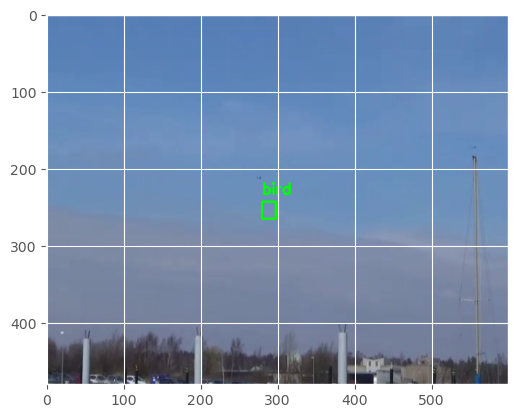

1/1 [==============================] - 0s 292ms/step


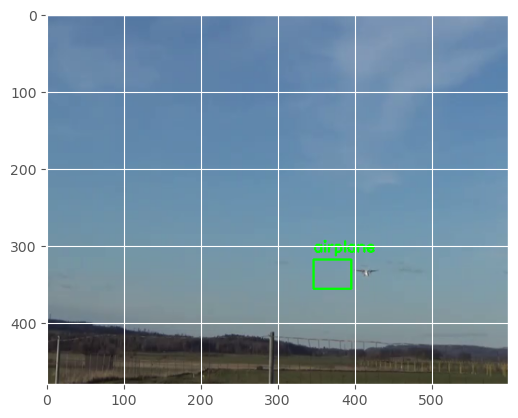

1/1 [==============================] - 0s 288ms/step


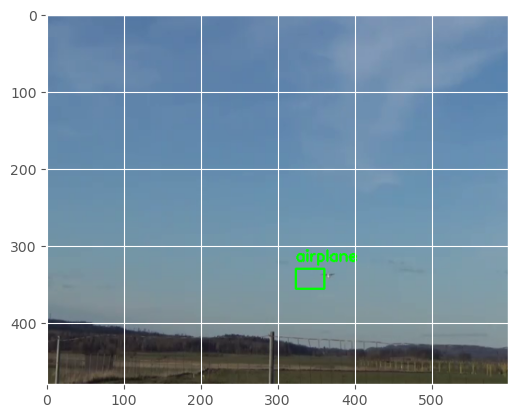

1/1 [==============================] - 0s 291ms/step


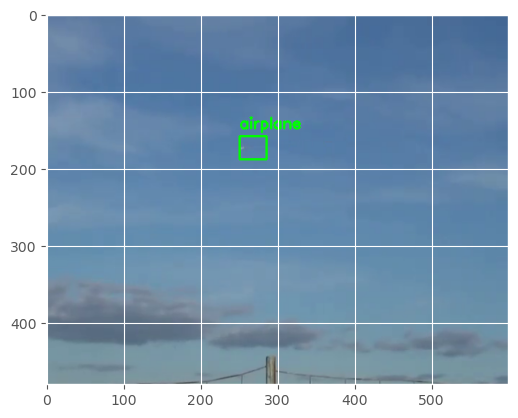

1/1 [==============================] - 0s 288ms/step


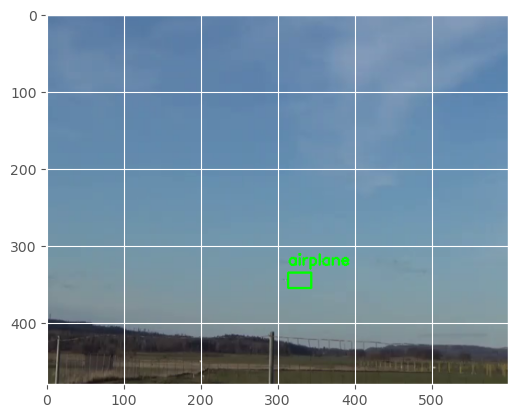

1/1 [==============================] - 0s 290ms/step


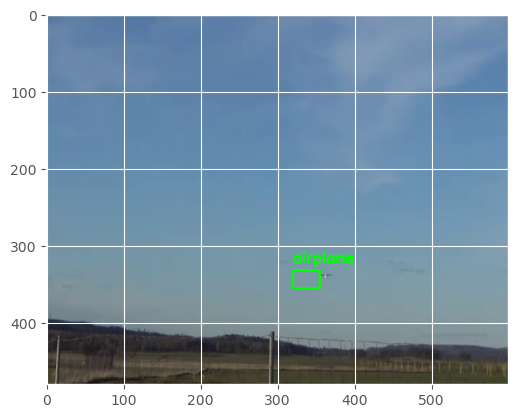

1/1 [==============================] - 0s 290ms/step


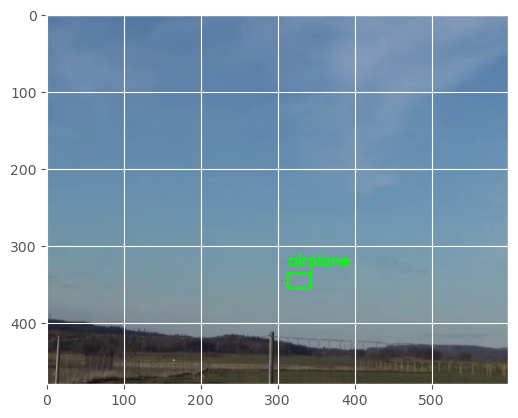

1/1 [==============================] - 0s 289ms/step


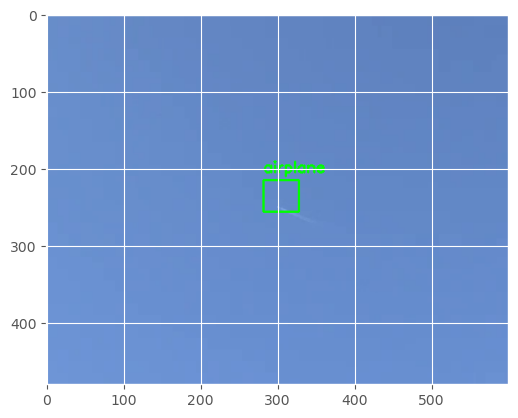

1/1 [==============================] - 0s 309ms/step


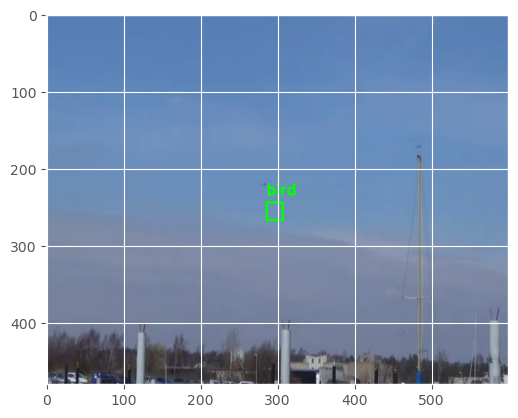

1/1 [==============================] - 0s 287ms/step


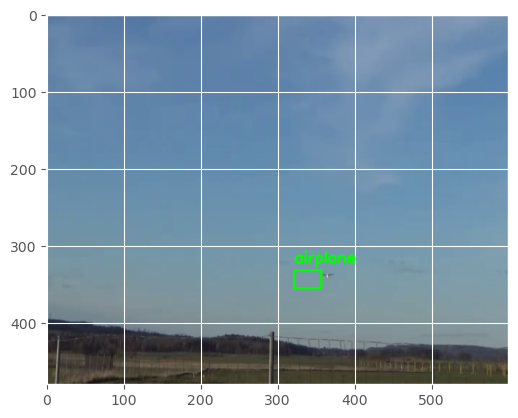

1/1 [==============================] - 0s 286ms/step


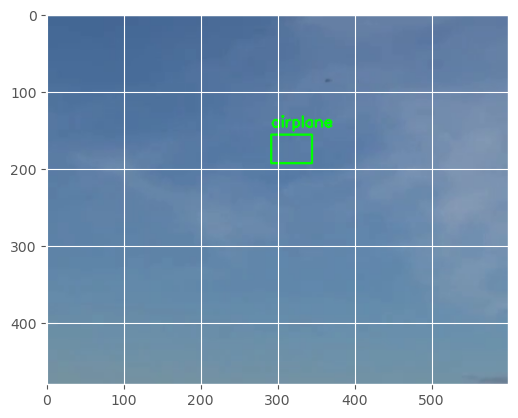

1/1 [==============================] - 0s 286ms/step


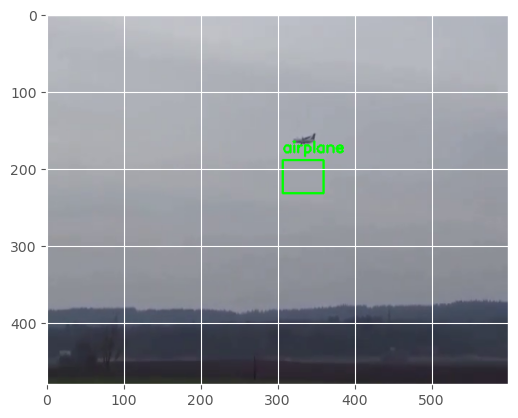

1/1 [==============================] - 0s 289ms/step


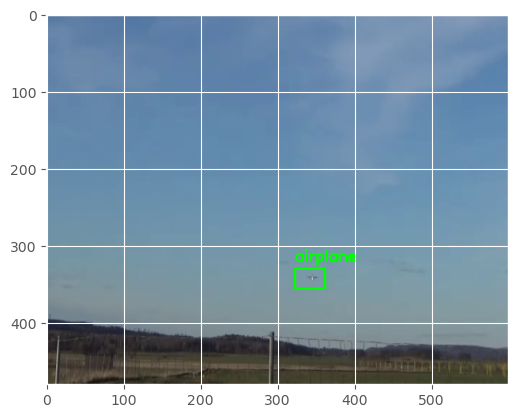

1/1 [==============================] - 0s 290ms/step


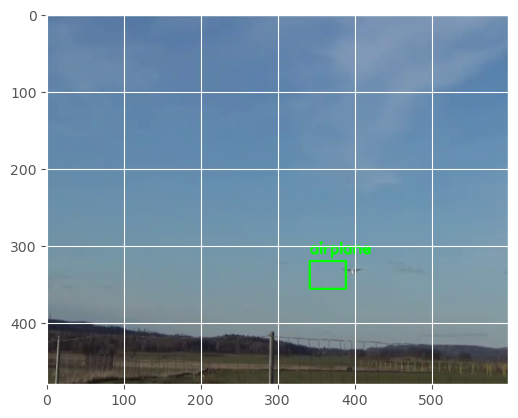

1/1 [==============================] - 0s 287ms/step


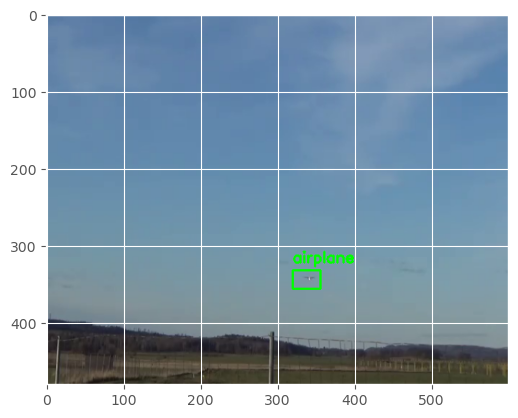

1/1 [==============================] - 0s 291ms/step


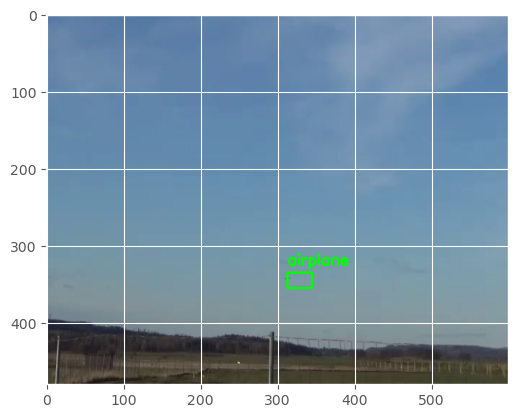

1/1 [==============================] - 0s 284ms/step


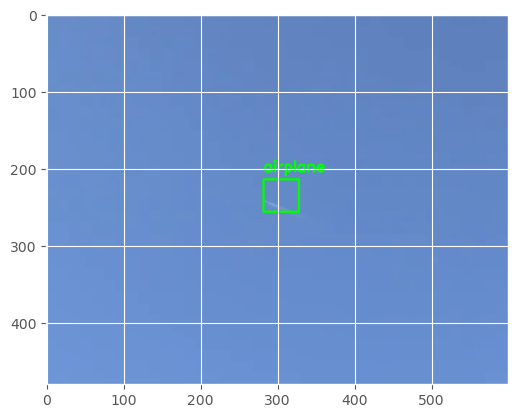

1/1 [==============================] - 0s 286ms/step


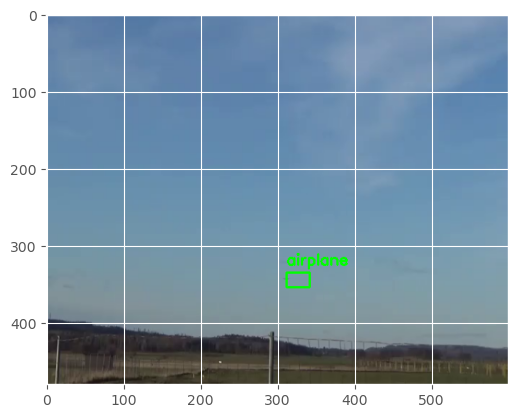

1/1 [==============================] - 0s 285ms/step


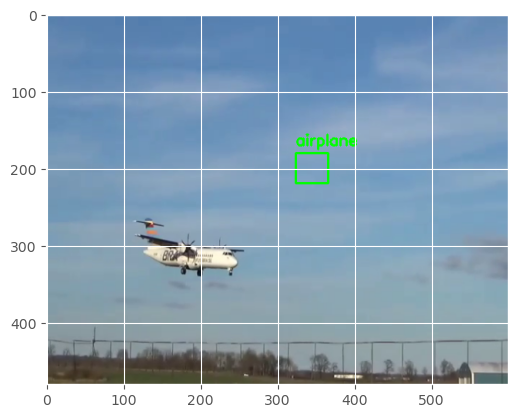

1/1 [==============================] - 0s 364ms/step


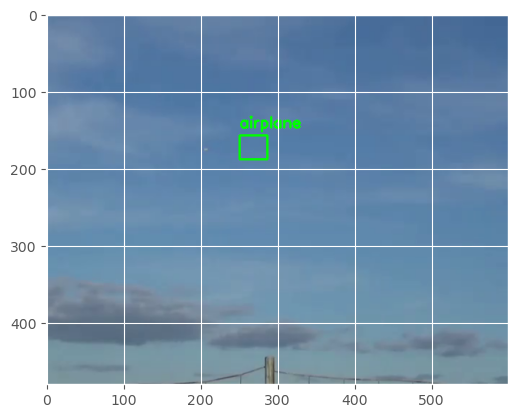

1/1 [==============================] - 0s 374ms/step


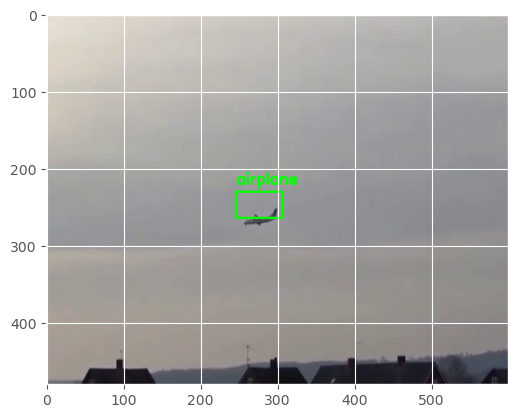

1/1 [==============================] - 0s 286ms/step


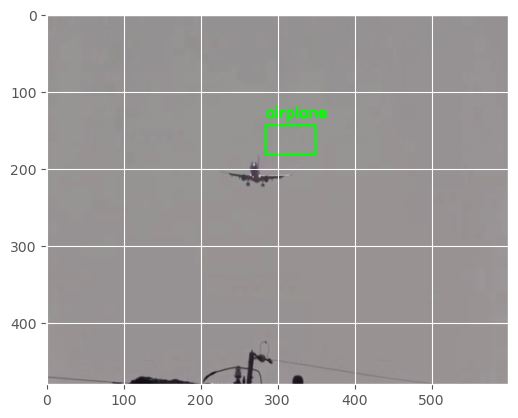

1/1 [==============================] - 0s 291ms/step


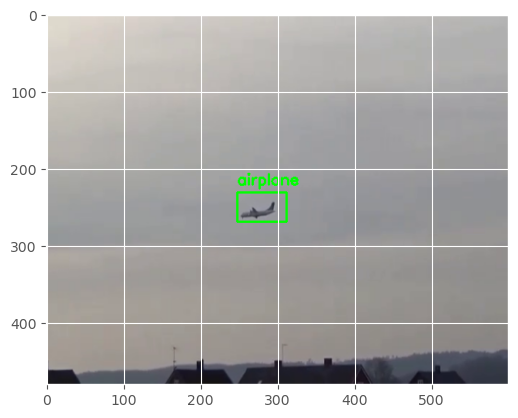

1/1 [==============================] - 0s 290ms/step


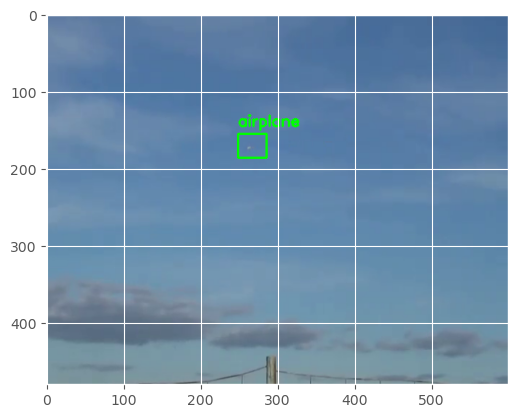

1/1 [==============================] - 0s 296ms/step


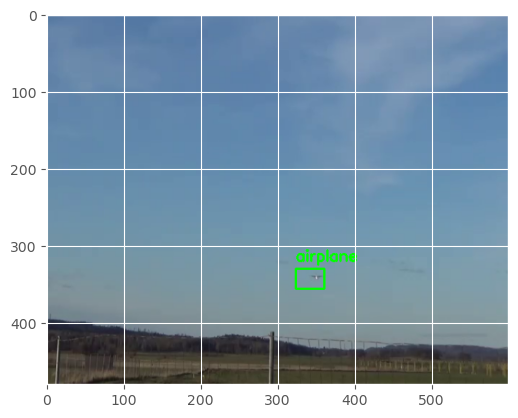

1/1 [==============================] - 0s 293ms/step


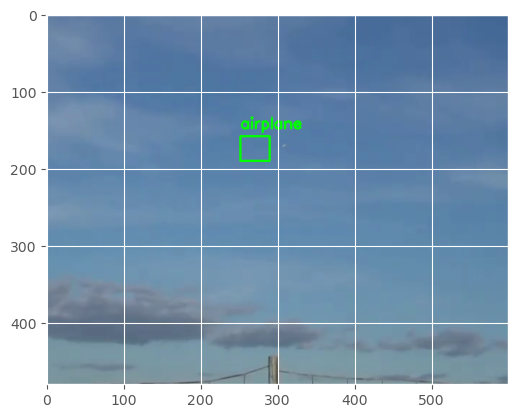

1/1 [==============================] - 0s 295ms/step


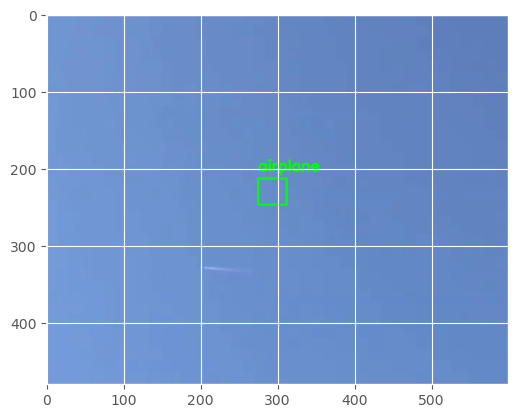

1/1 [==============================] - 0s 288ms/step


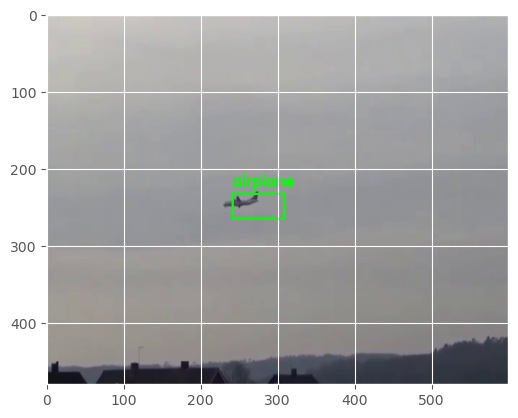

1/1 [==============================] - 0s 291ms/step


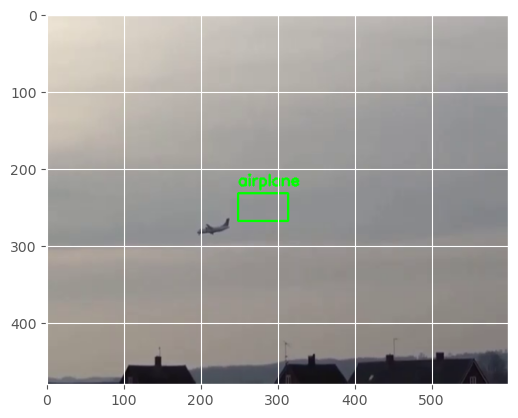

1/1 [==============================] - 0s 299ms/step


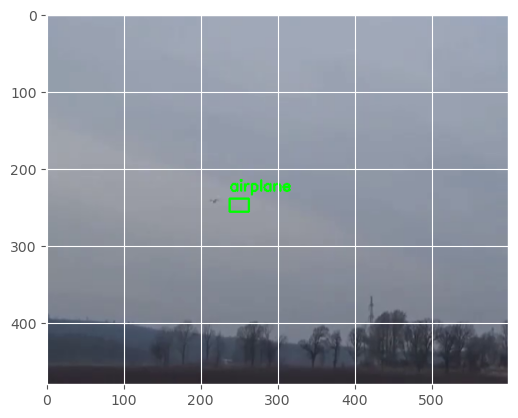

1/1 [==============================] - 0s 292ms/step


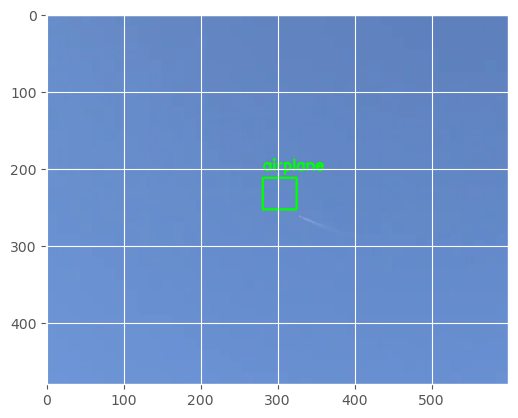

1/1 [==============================] - 0s 288ms/step


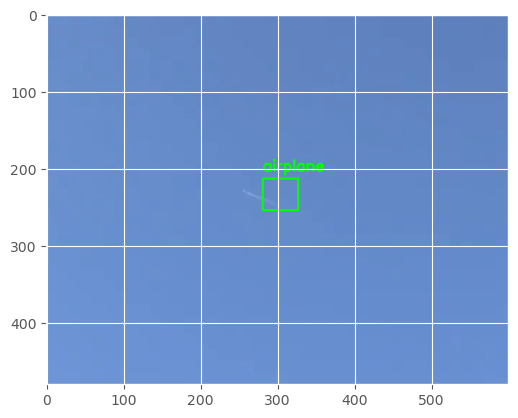

1/1 [==============================] - 0s 287ms/step


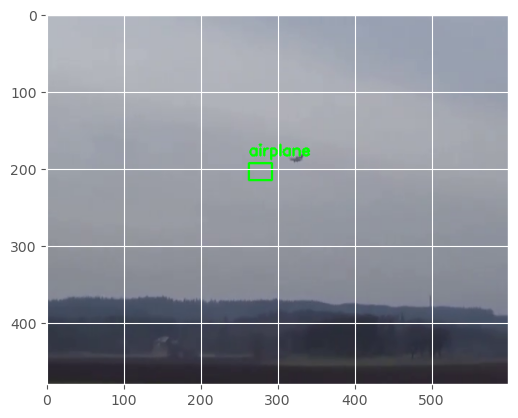

1/1 [==============================] - 0s 284ms/step


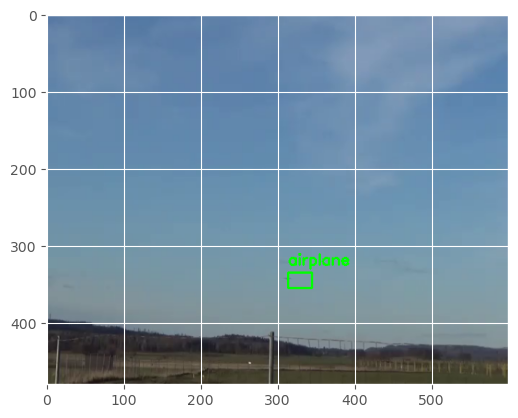

1/1 [==============================] - 0s 294ms/step


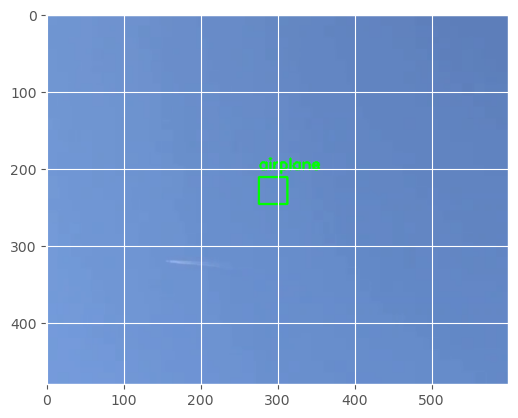

1/1 [==============================] - 0s 286ms/step


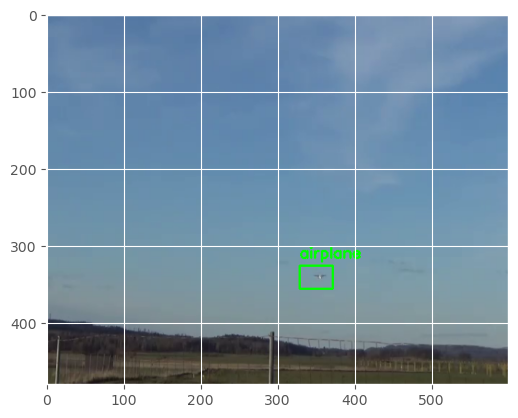

1/1 [==============================] - 0s 286ms/step


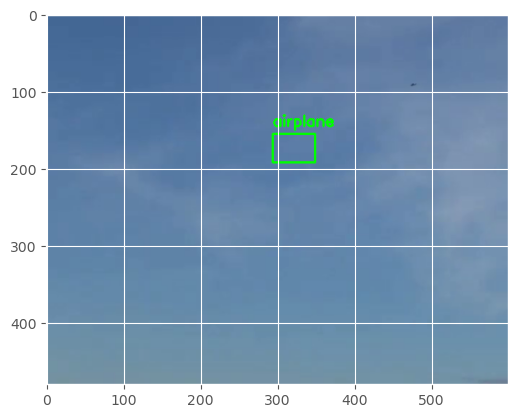

1/1 [==============================] - 0s 287ms/step


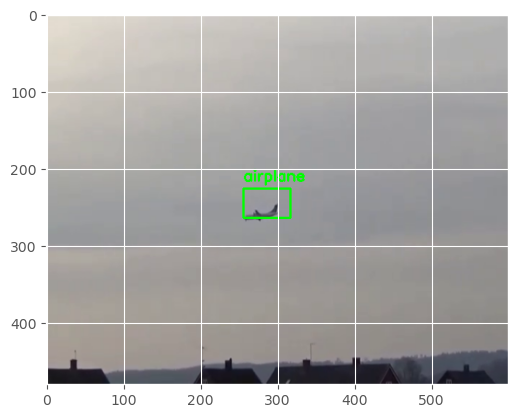

1/1 [==============================] - 0s 293ms/step


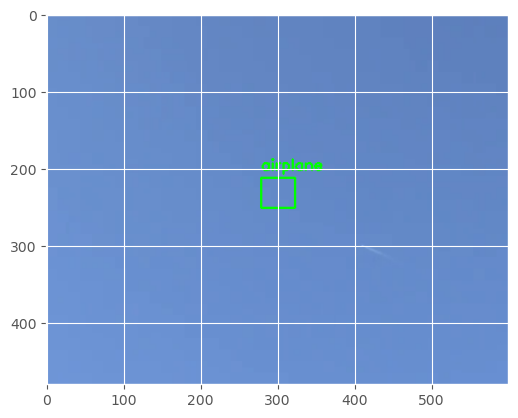

1/1 [==============================] - 0s 289ms/step


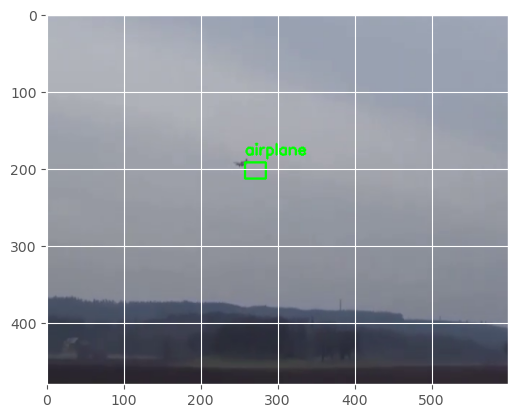

1/1 [==============================] - 0s 294ms/step


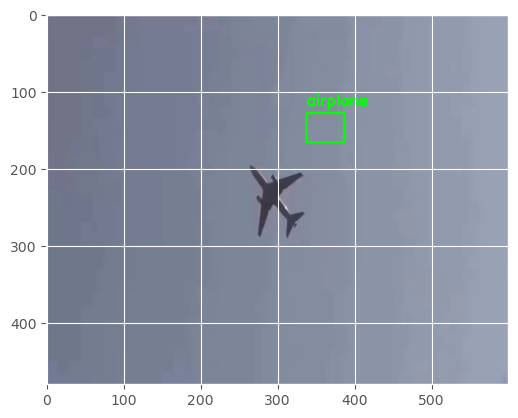

1/1 [==============================] - 0s 291ms/step


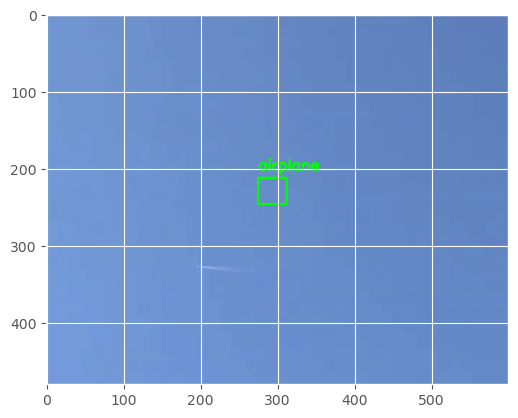

1/1 [==============================] - 0s 291ms/step


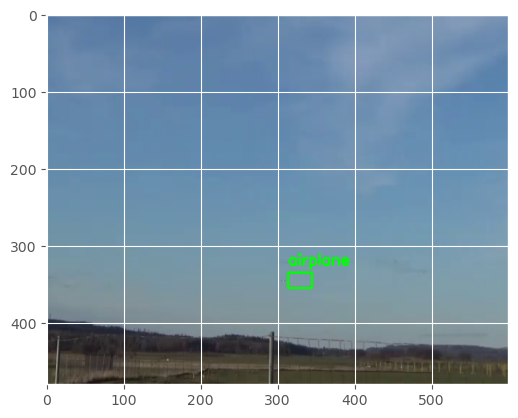

1/1 [==============================] - 0s 288ms/step


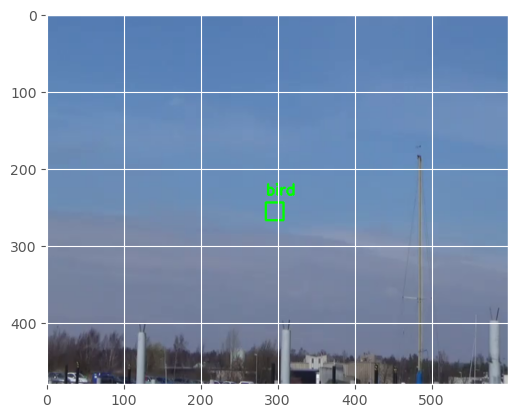

1/1 [==============================] - 0s 287ms/step


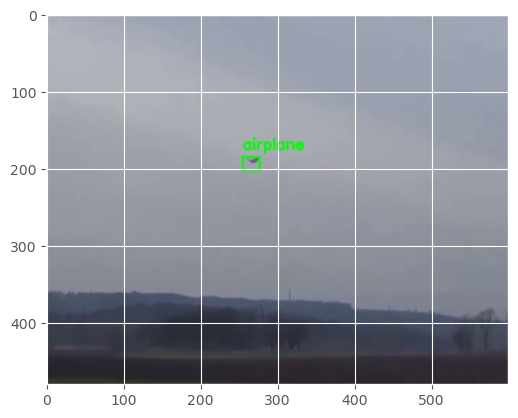

1/1 [==============================] - 0s 294ms/step


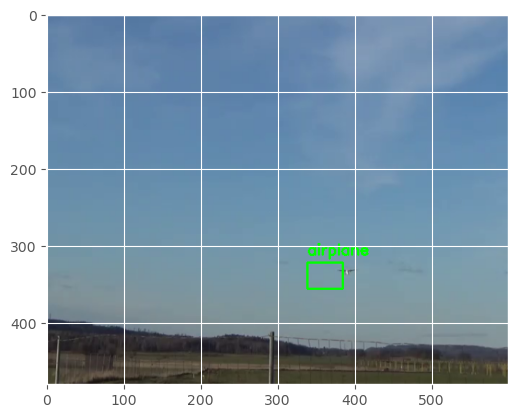

1/1 [==============================] - 0s 297ms/step


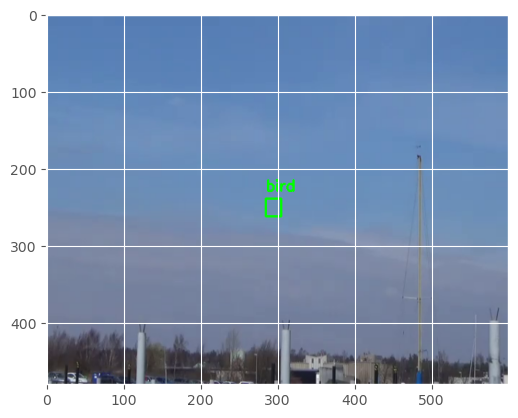

1/1 [==============================] - 0s 288ms/step


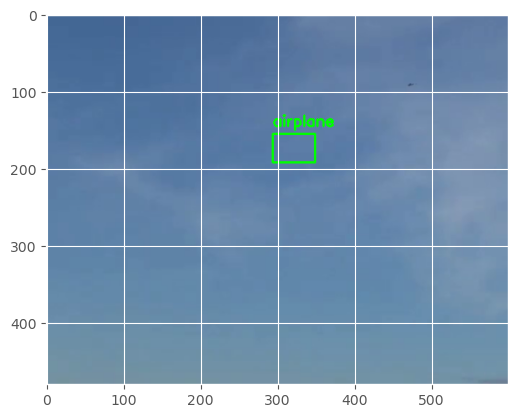

1/1 [==============================] - 0s 283ms/step


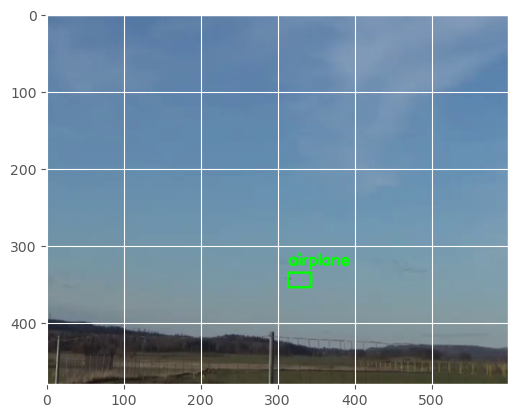

1/1 [==============================] - 0s 299ms/step


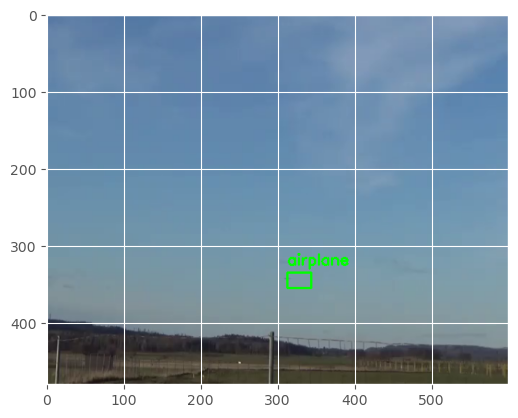

1/1 [==============================] - 0s 291ms/step


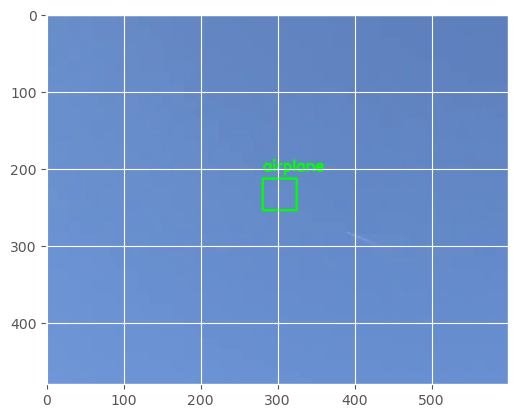

1/1 [==============================] - 0s 296ms/step


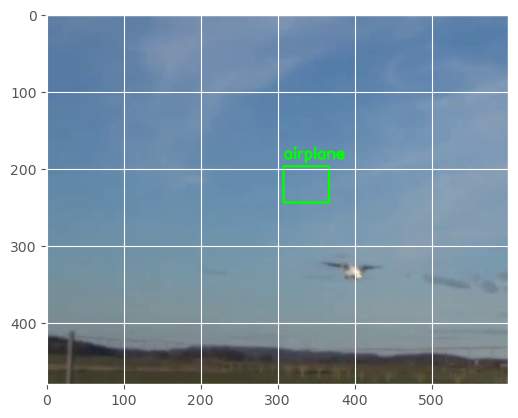

1/1 [==============================] - 0s 292ms/step


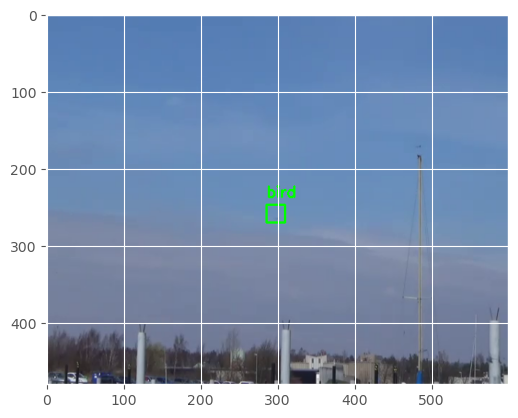

1/1 [==============================] - 0s 289ms/step


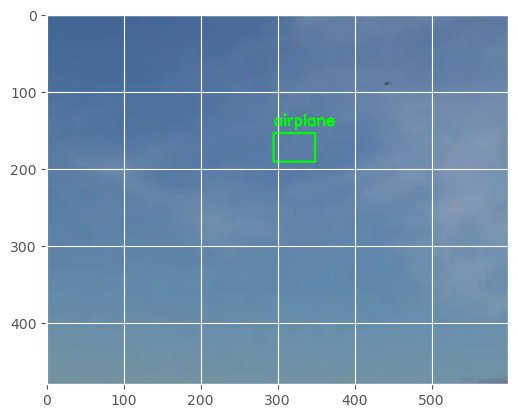

1/1 [==============================] - 0s 284ms/step


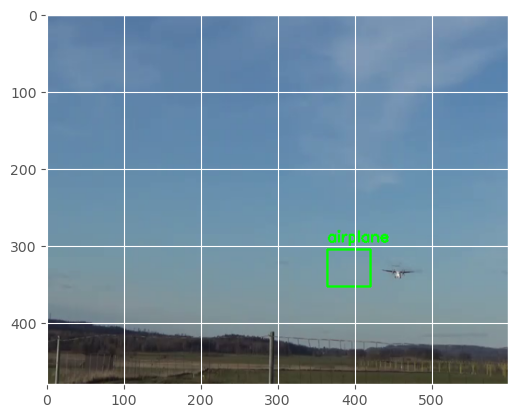

1/1 [==============================] - 0s 279ms/step


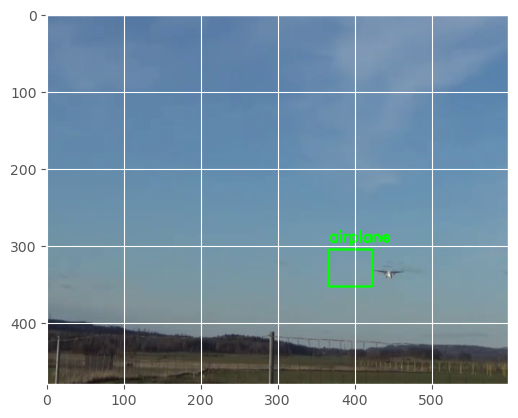

1/1 [==============================] - 0s 287ms/step


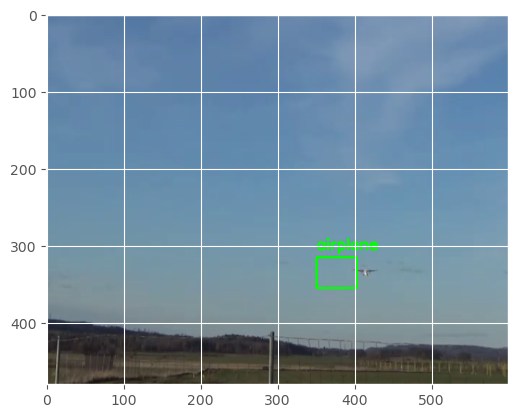

1/1 [==============================] - 0s 290ms/step


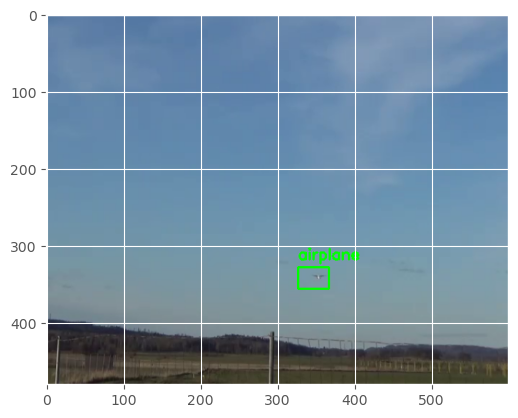

1/1 [==============================] - 0s 291ms/step


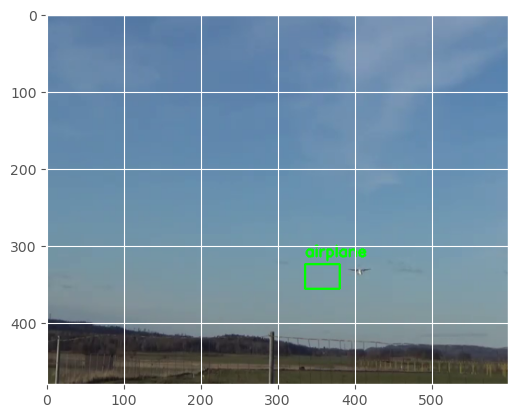

1/1 [==============================] - 0s 291ms/step


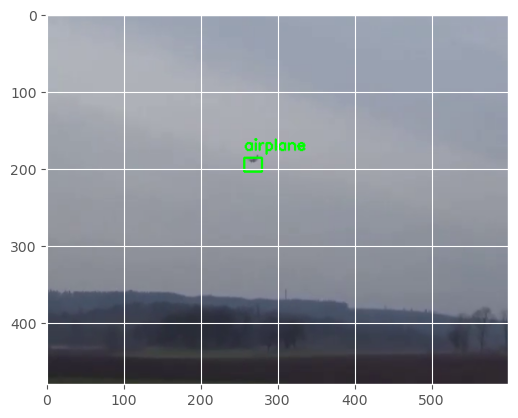

1/1 [==============================] - 0s 321ms/step


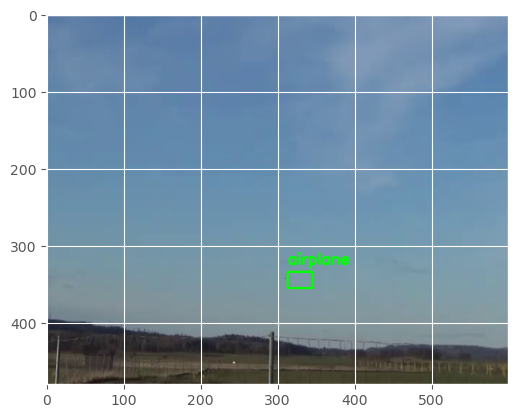

1/1 [==============================] - 0s 296ms/step


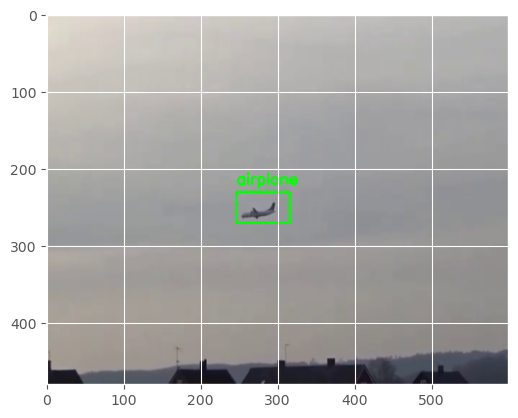

1/1 [==============================] - 0s 288ms/step


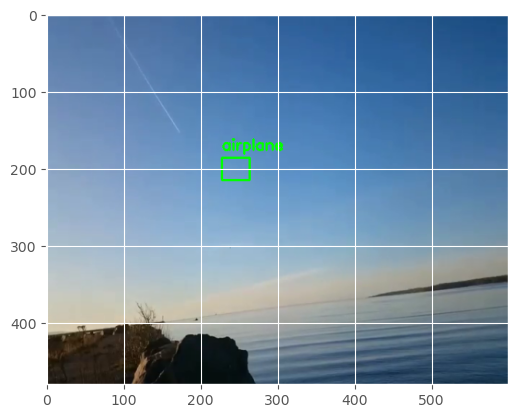

1/1 [==============================] - 0s 288ms/step


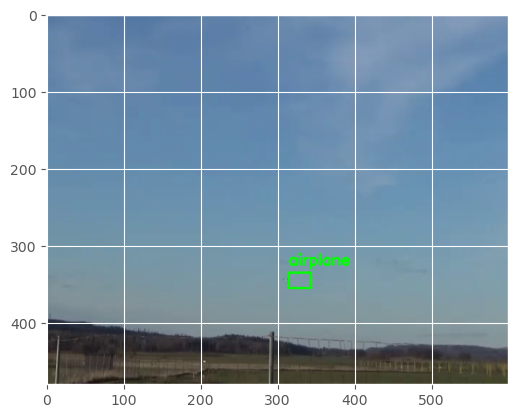

1/1 [==============================] - 0s 286ms/step


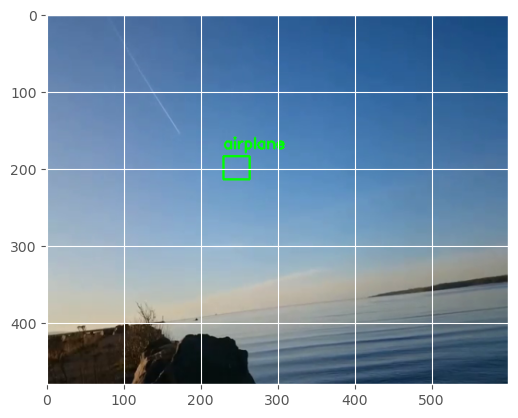

1/1 [==============================] - 0s 282ms/step


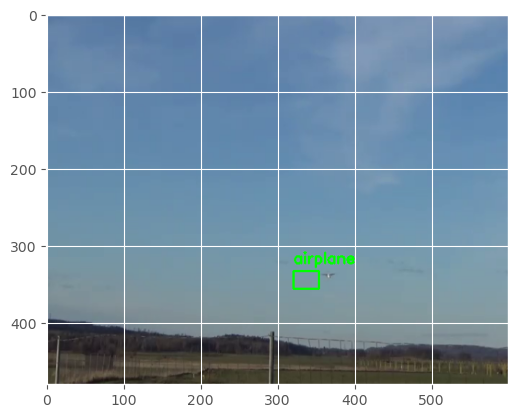

1/1 [==============================] - 0s 285ms/step


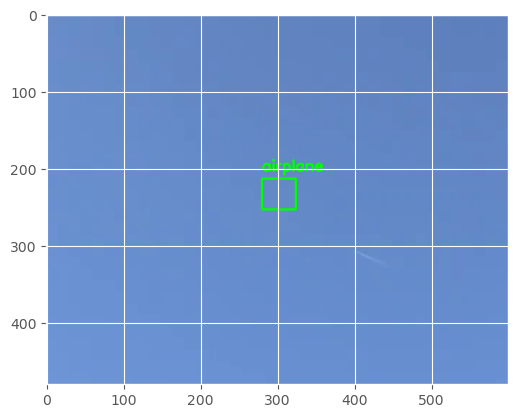

1/1 [==============================] - 0s 291ms/step


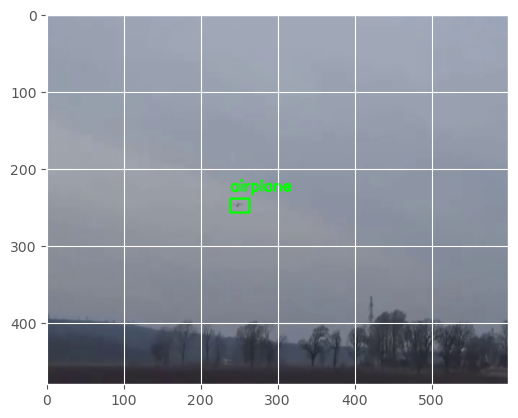

1/1 [==============================] - 0s 285ms/step


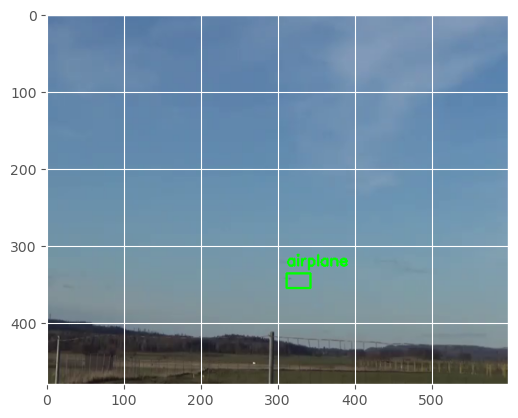

1/1 [==============================] - 0s 294ms/step


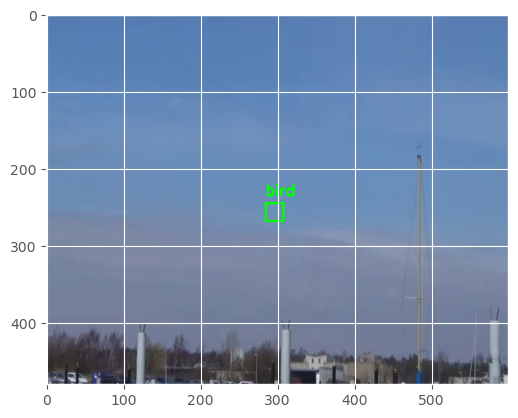

1/1 [==============================] - 0s 295ms/step


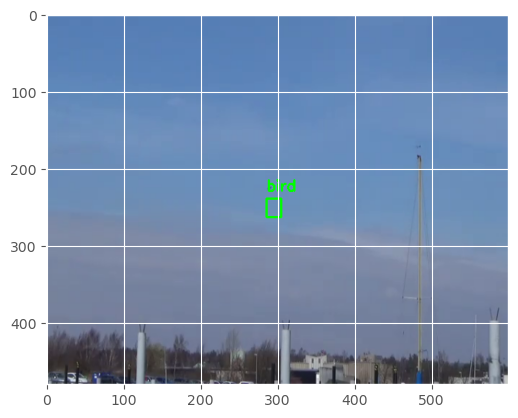

1/1 [==============================] - 0s 398ms/step


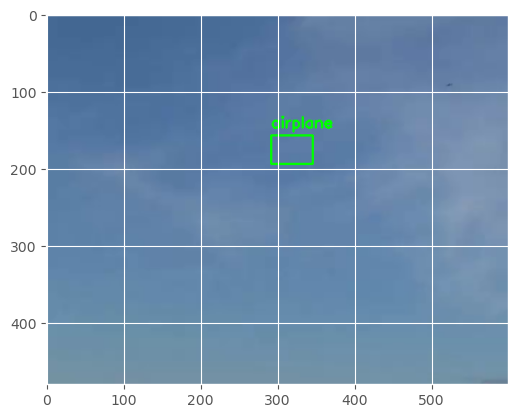

1/1 [==============================] - 0s 375ms/step


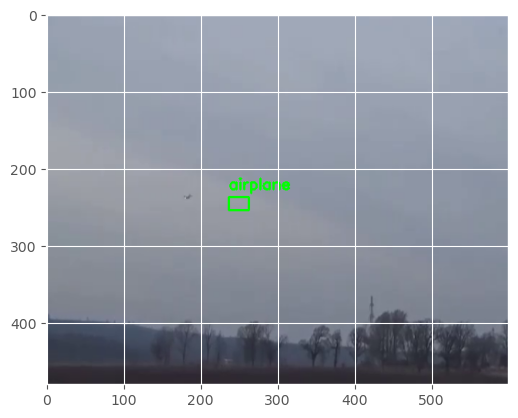

1/1 [==============================] - 0s 291ms/step


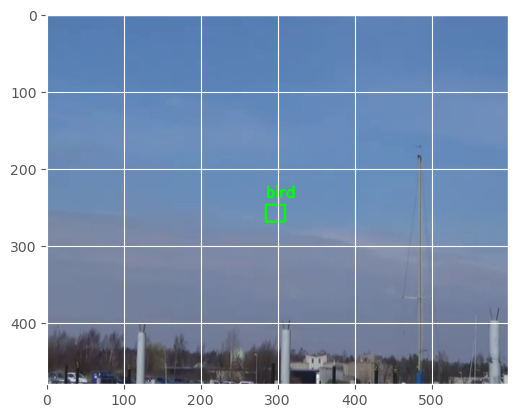

1/1 [==============================] - 0s 291ms/step


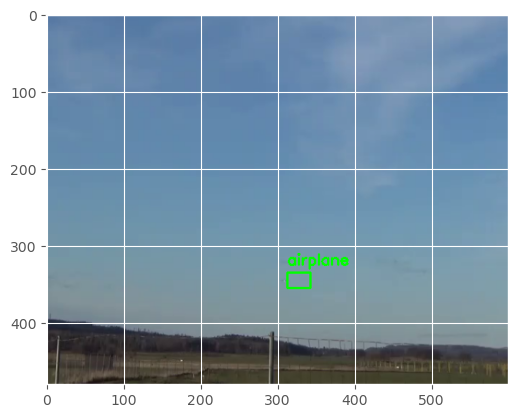

1/1 [==============================] - 0s 296ms/step


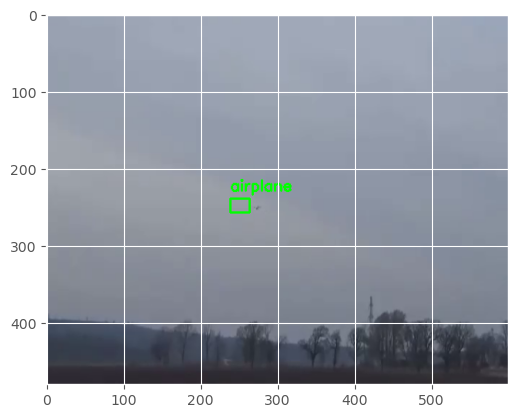

1/1 [==============================] - 0s 292ms/step


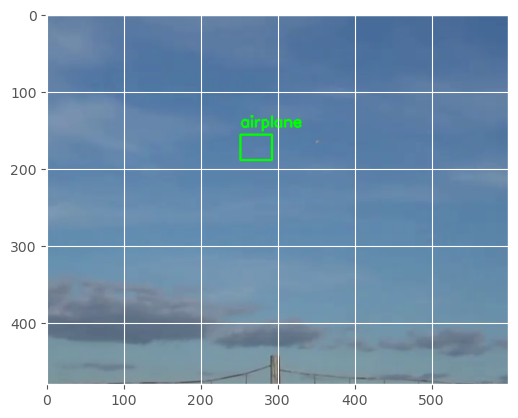

1/1 [==============================] - 0s 290ms/step


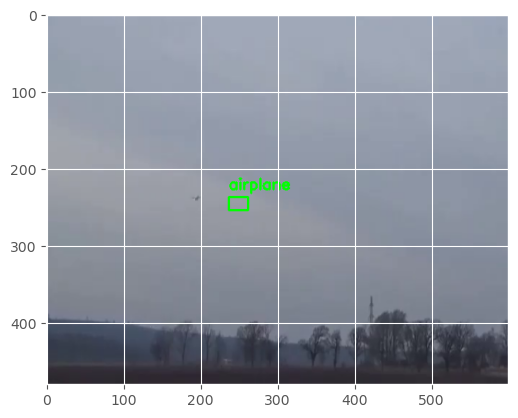

1/1 [==============================] - 0s 291ms/step


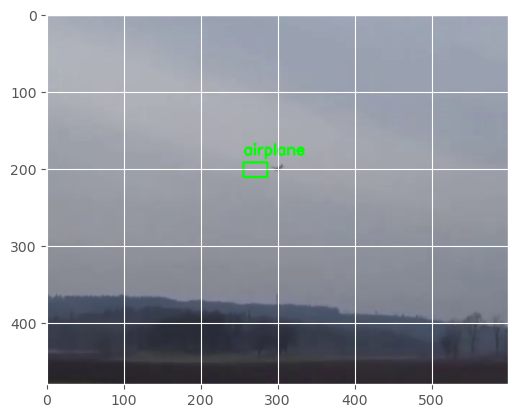

1/1 [==============================] - 0s 289ms/step


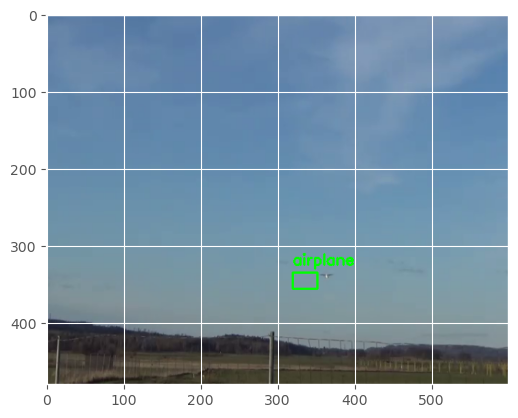

1/1 [==============================] - 0s 287ms/step


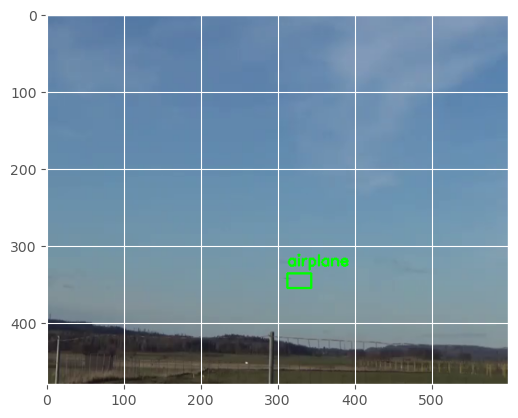

1/1 [==============================] - 0s 289ms/step


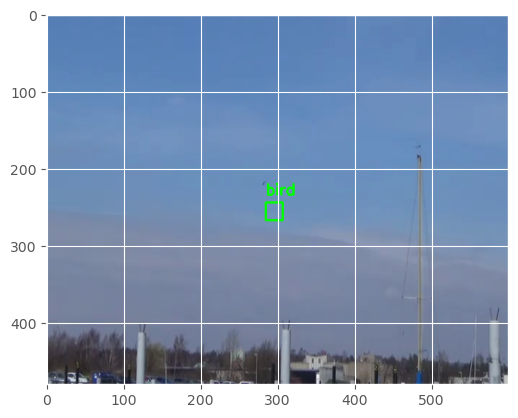

1/1 [==============================] - 0s 290ms/step


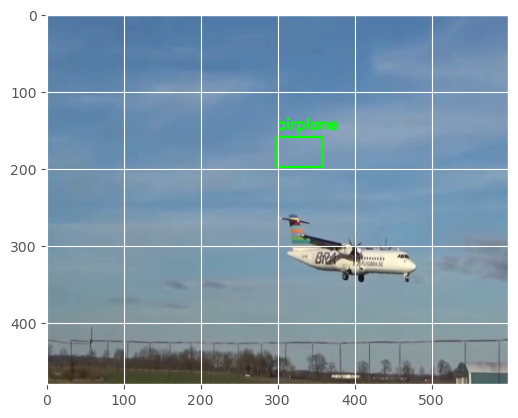

1/1 [==============================] - 0s 289ms/step


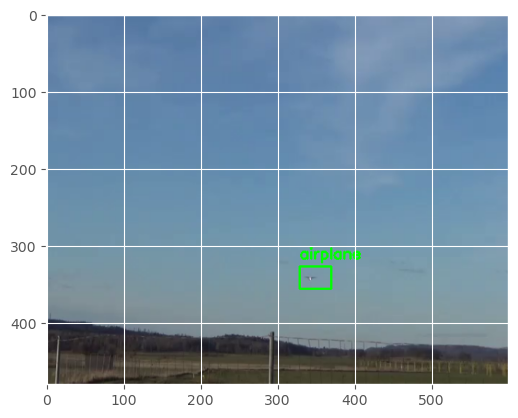

1/1 [==============================] - 0s 295ms/step


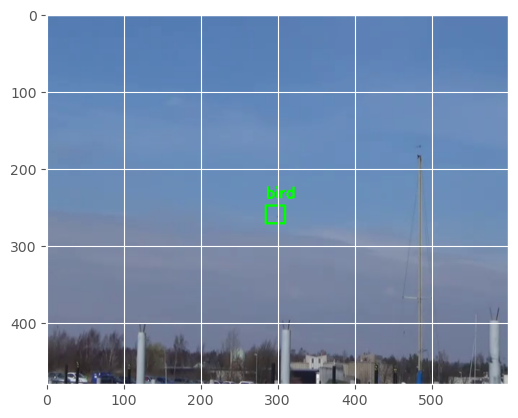

1/1 [==============================] - 0s 287ms/step


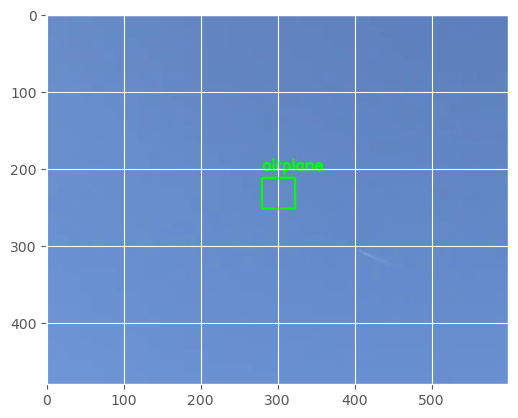

1/1 [==============================] - 0s 291ms/step


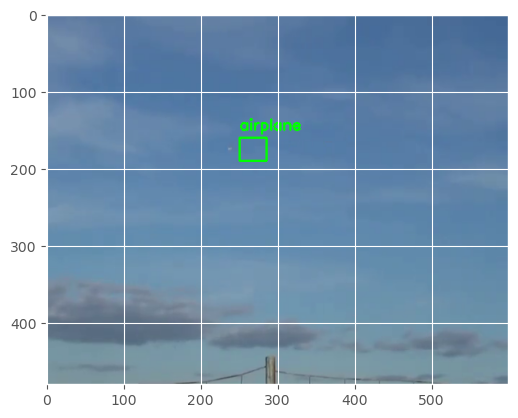

1/1 [==============================] - 0s 290ms/step


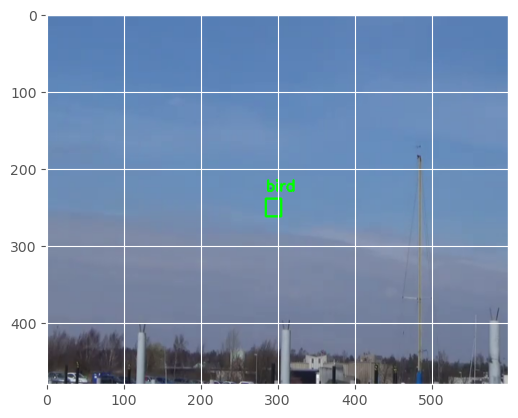

1/1 [==============================] - 0s 287ms/step


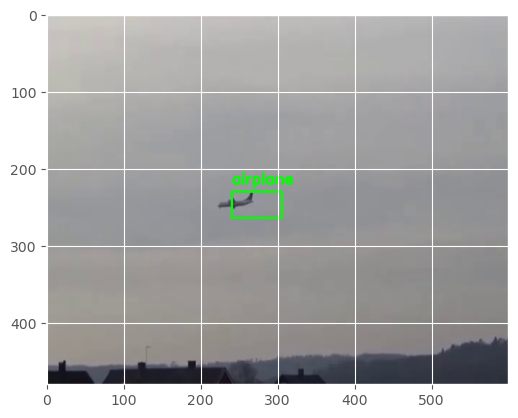

1/1 [==============================] - 0s 289ms/step


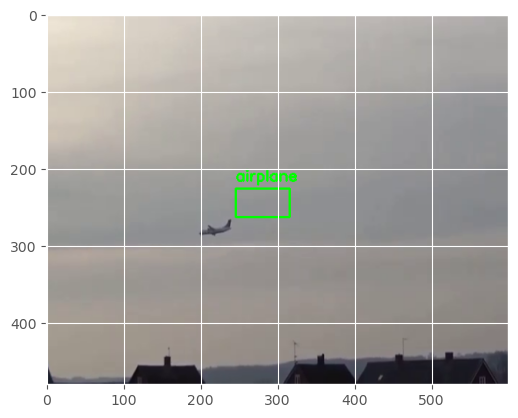

1/1 [==============================] - 0s 293ms/step


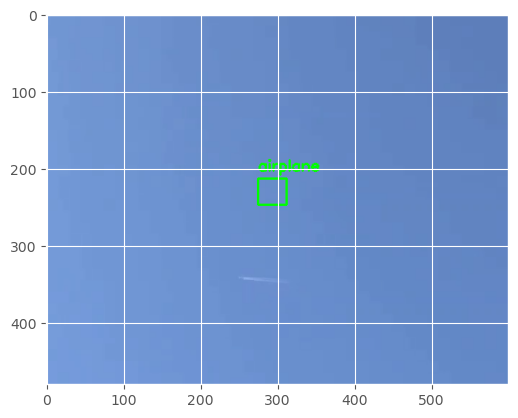

1/1 [==============================] - 0s 288ms/step


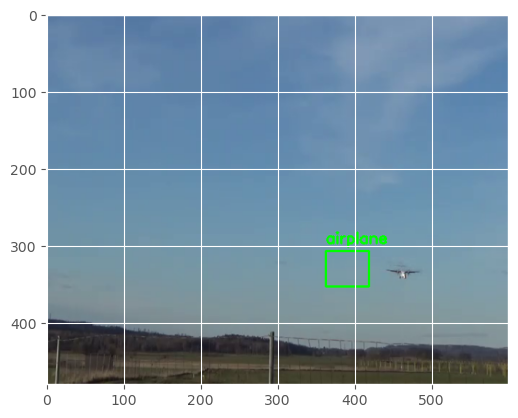

1/1 [==============================] - 0s 283ms/step


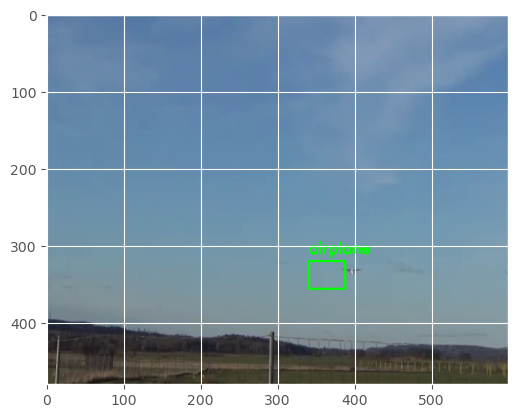

1/1 [==============================] - 0s 286ms/step


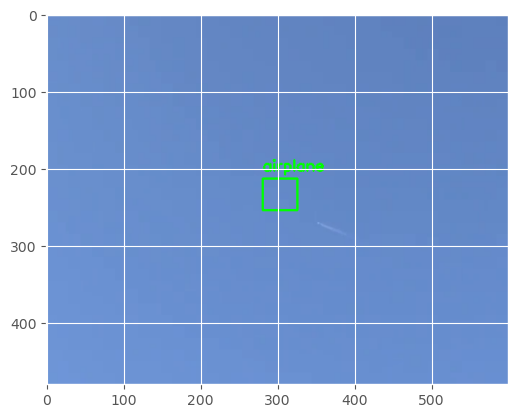

1/1 [==============================] - 0s 288ms/step


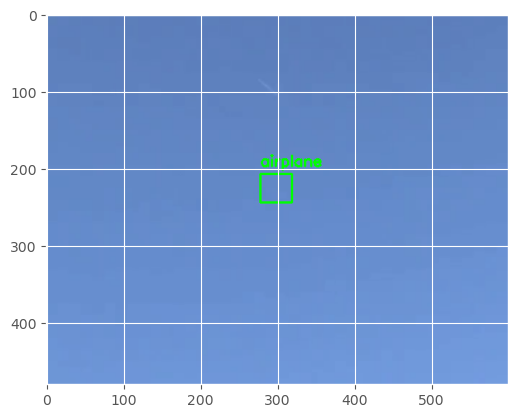

1/1 [==============================] - 0s 286ms/step


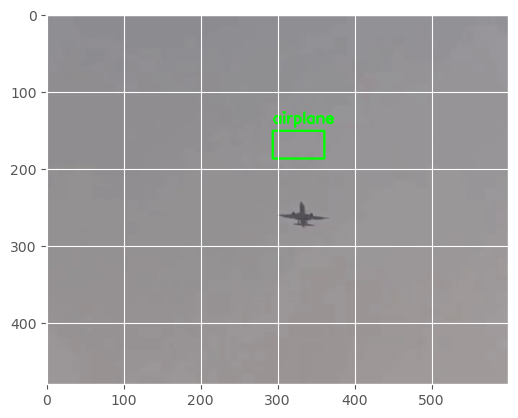

1/1 [==============================] - 0s 281ms/step


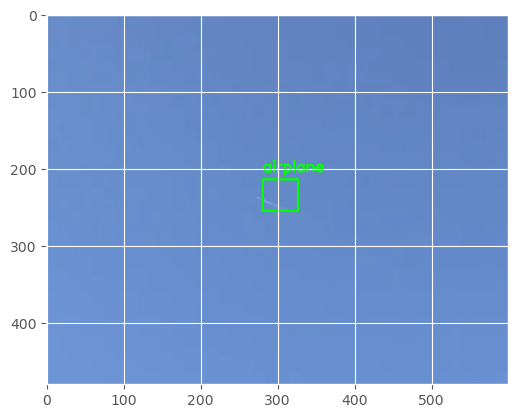

1/1 [==============================] - 0s 284ms/step


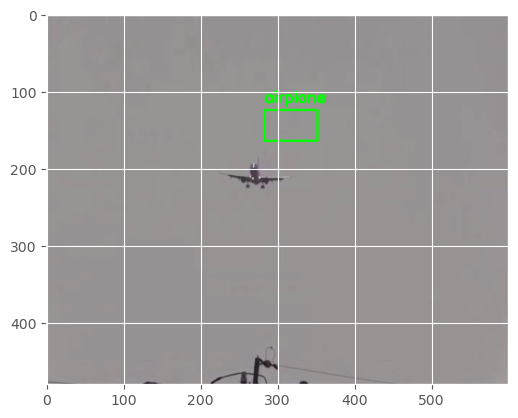

1/1 [==============================] - 0s 299ms/step


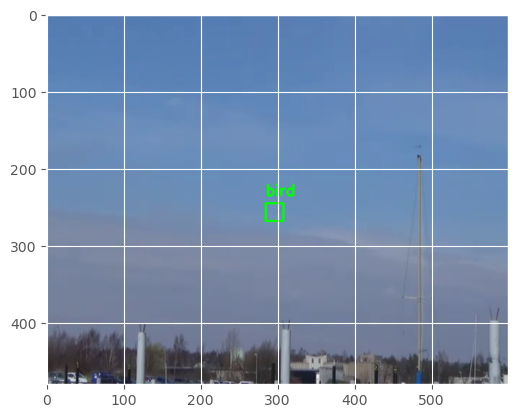

1/1 [==============================] - 0s 288ms/step


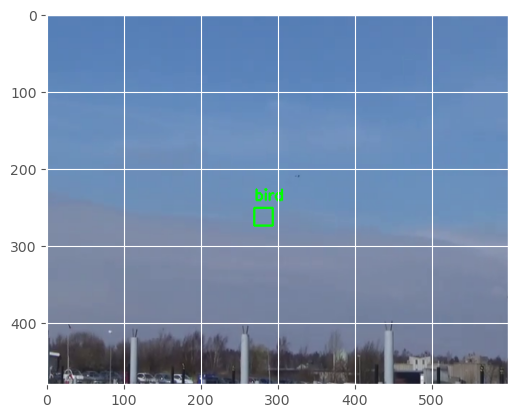

1/1 [==============================] - 0s 288ms/step


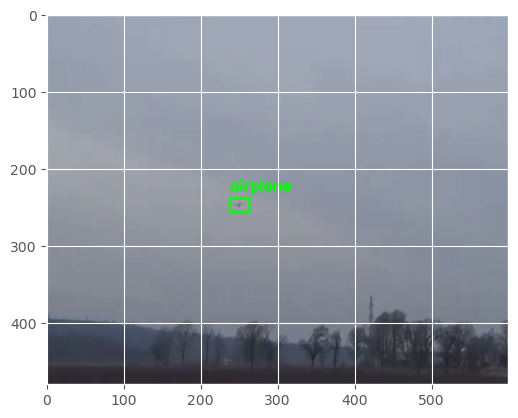

1/1 [==============================] - 0s 283ms/step


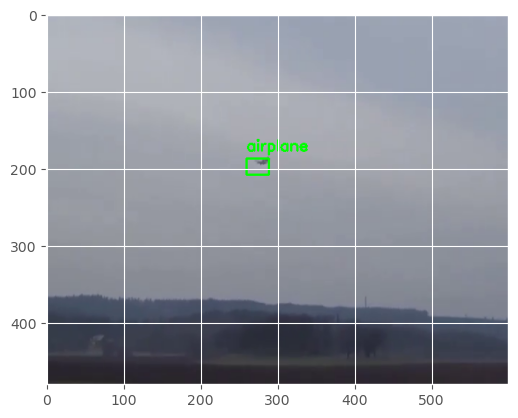

1/1 [==============================] - 0s 286ms/step


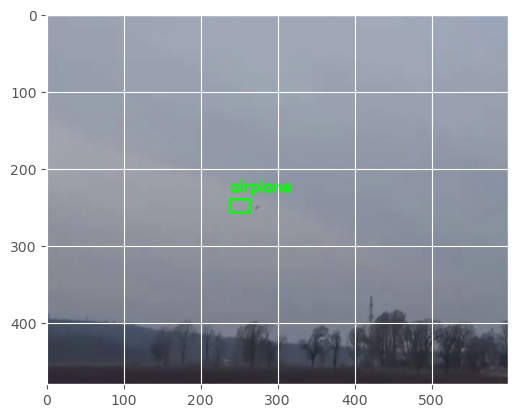

1/1 [==============================] - 0s 279ms/step


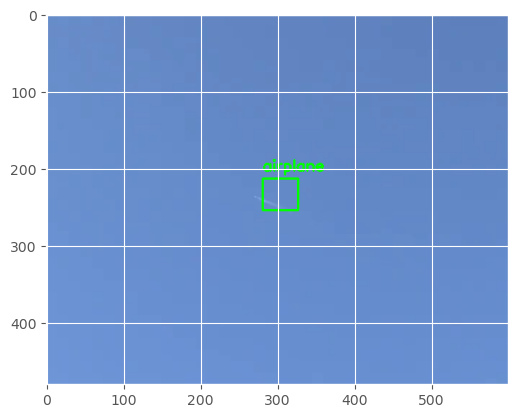

1/1 [==============================] - 0s 281ms/step


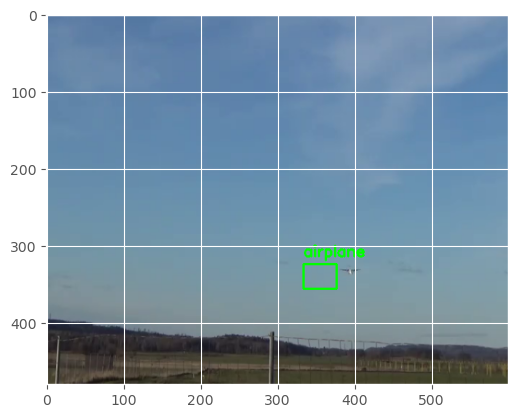

1/1 [==============================] - 0s 282ms/step


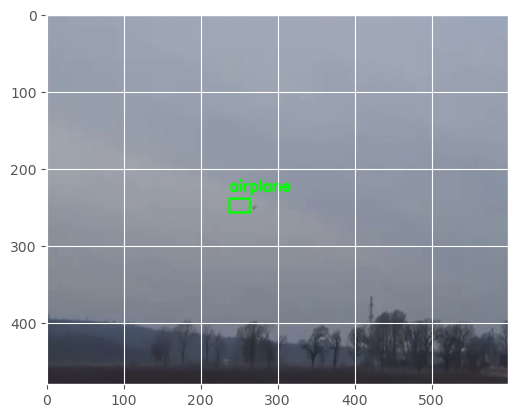

1/1 [==============================] - 0s 282ms/step


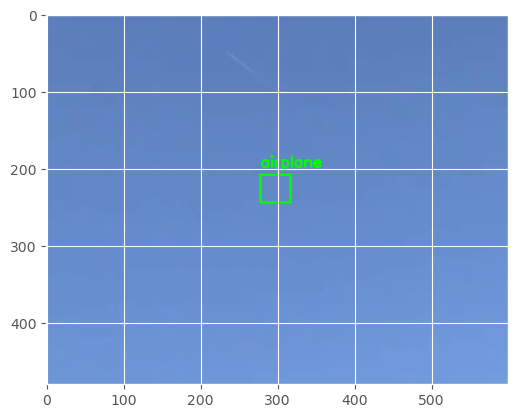

1/1 [==============================] - 0s 286ms/step


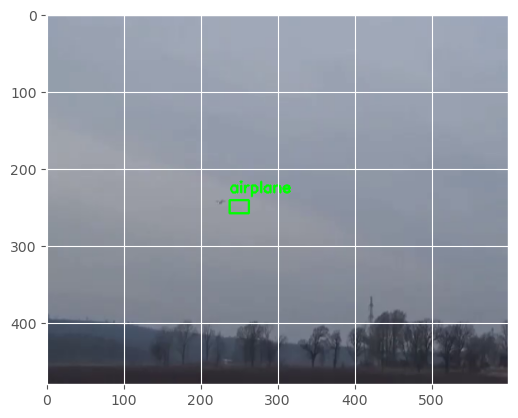

1/1 [==============================] - 0s 284ms/step


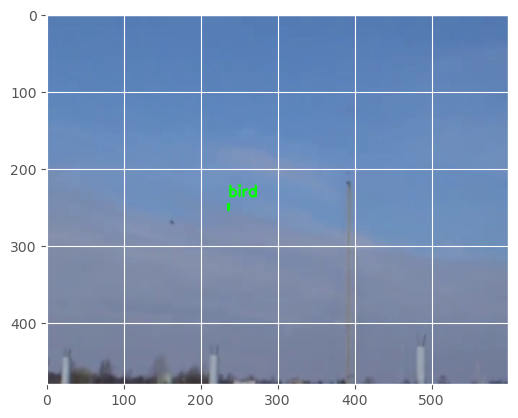

1/1 [==============================] - 0s 287ms/step


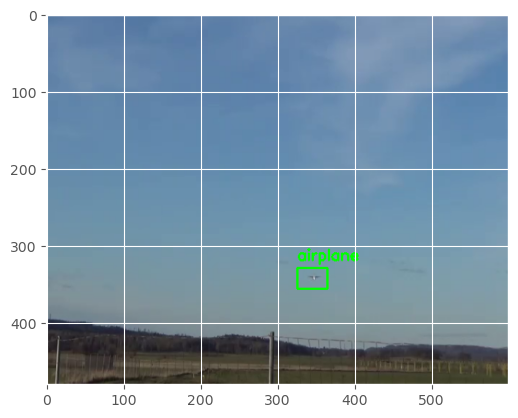

1/1 [==============================] - 0s 293ms/step


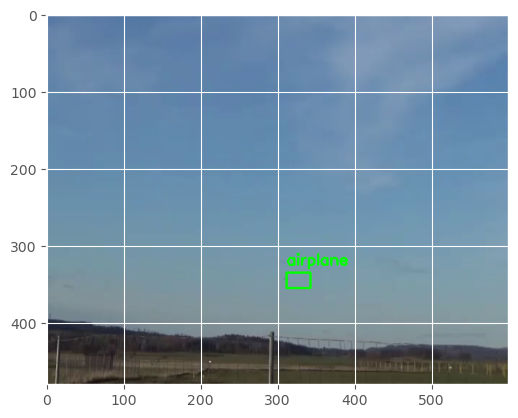

1/1 [==============================] - 0s 291ms/step


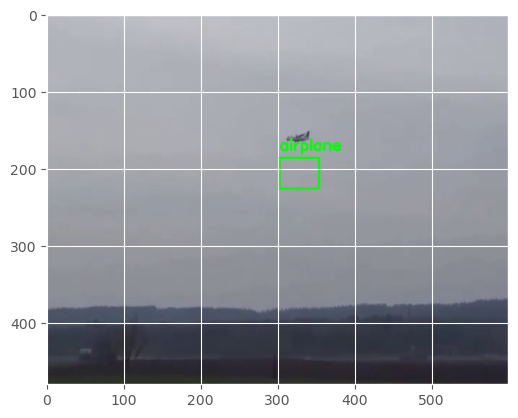

1/1 [==============================] - 0s 284ms/step


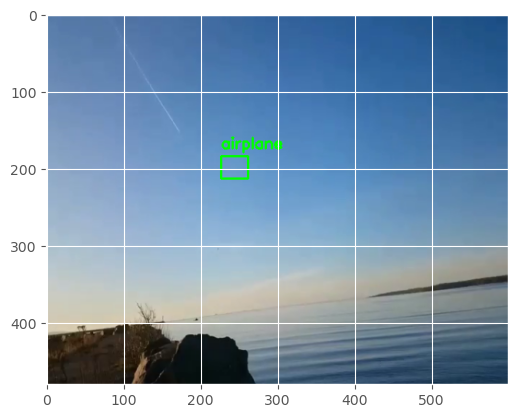

1/1 [==============================] - 0s 289ms/step


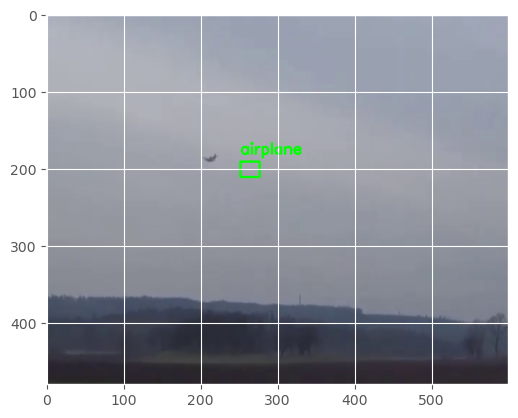

1/1 [==============================] - 0s 298ms/step


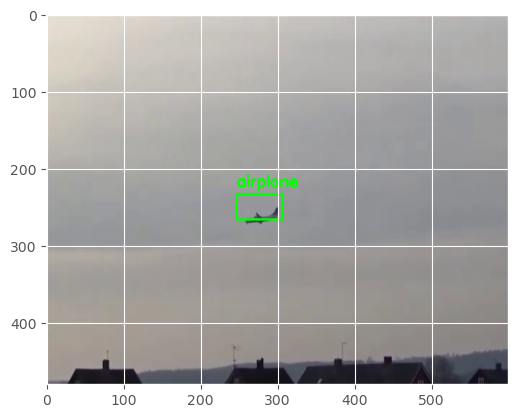

1/1 [==============================] - 0s 292ms/step


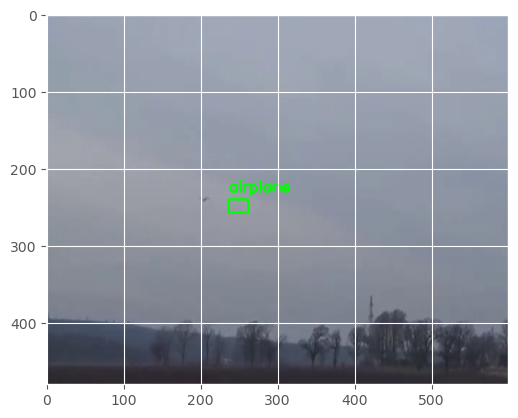

1/1 [==============================] - 0s 292ms/step


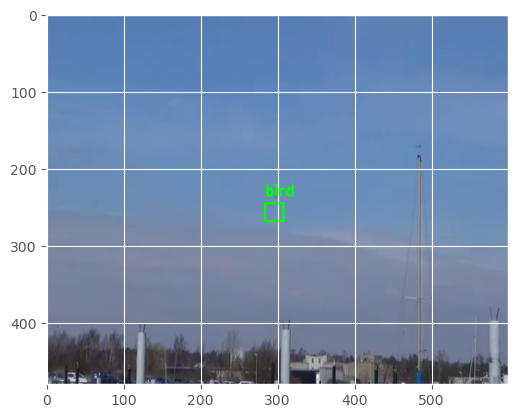

1/1 [==============================] - 0s 291ms/step


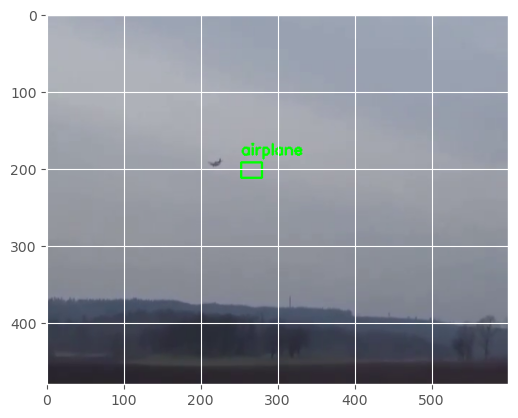

1/1 [==============================] - 0s 291ms/step


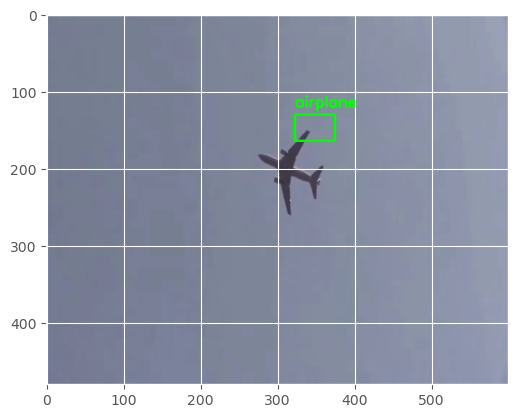

1/1 [==============================] - 0s 292ms/step


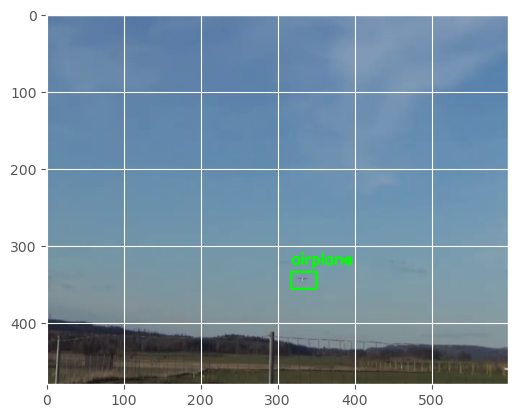

1/1 [==============================] - 0s 392ms/step


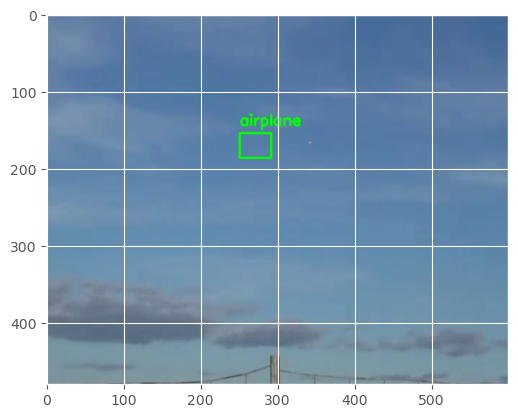

1/1 [==============================] - 0s 376ms/step


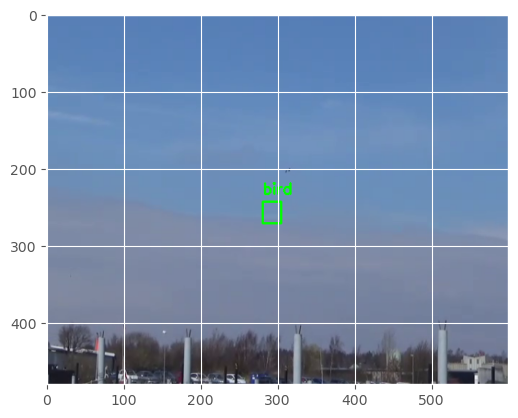

1/1 [==============================] - 0s 289ms/step


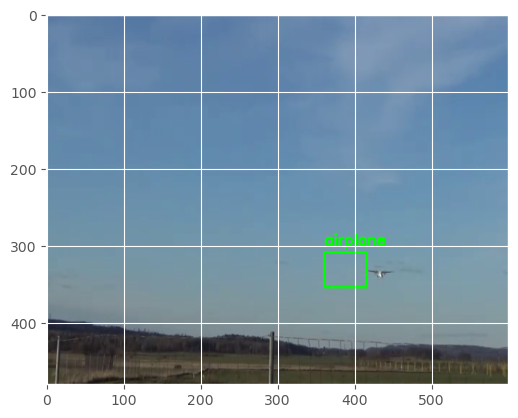

1/1 [==============================] - 0s 288ms/step


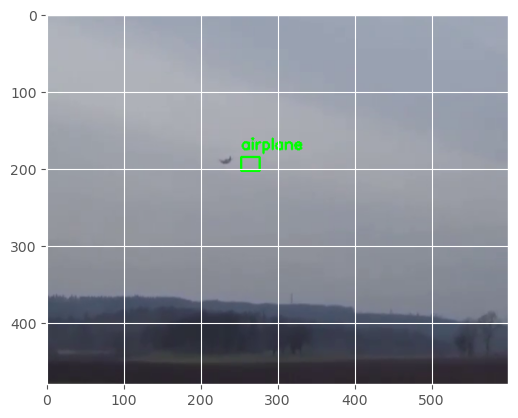

1/1 [==============================] - 0s 290ms/step


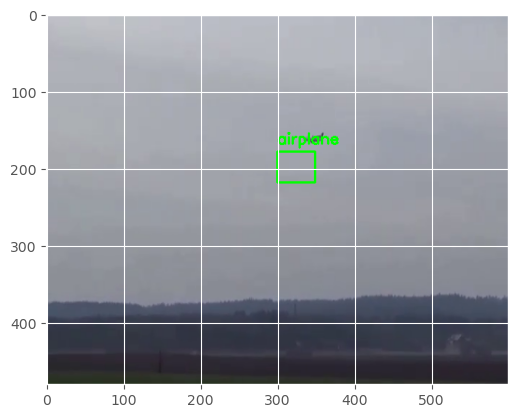

1/1 [==============================] - 0s 290ms/step


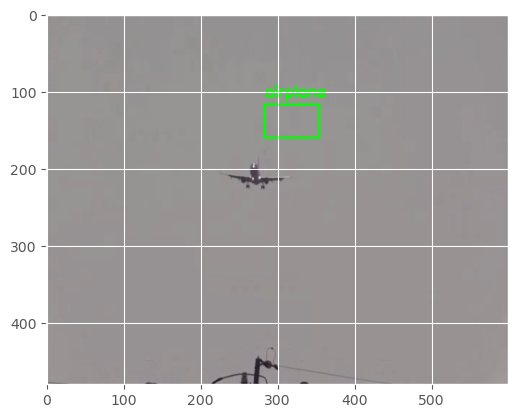

1/1 [==============================] - 0s 289ms/step


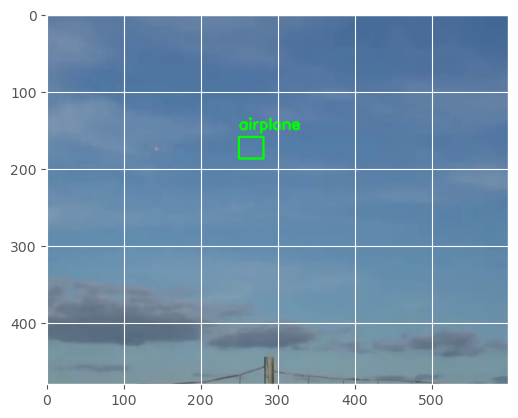

1/1 [==============================] - 0s 291ms/step


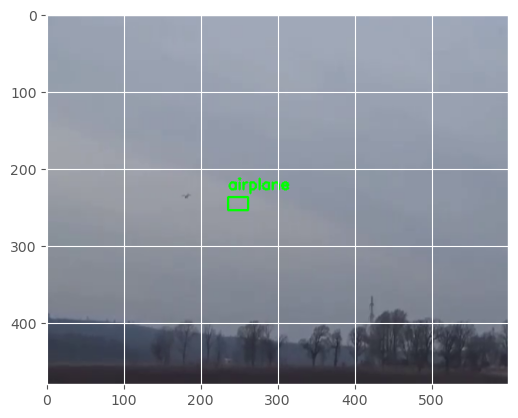

1/1 [==============================] - 0s 285ms/step


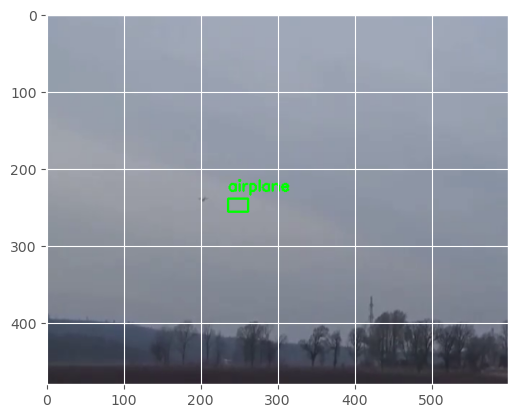

1/1 [==============================] - 0s 325ms/step


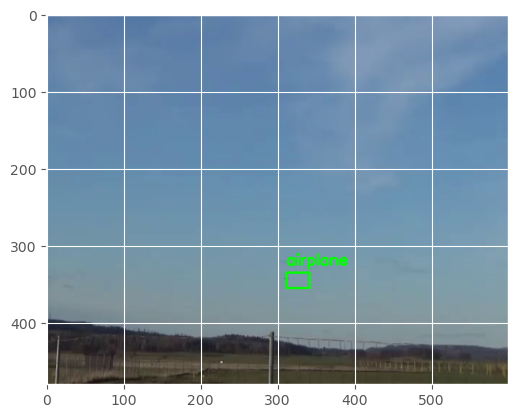

1/1 [==============================] - 0s 291ms/step


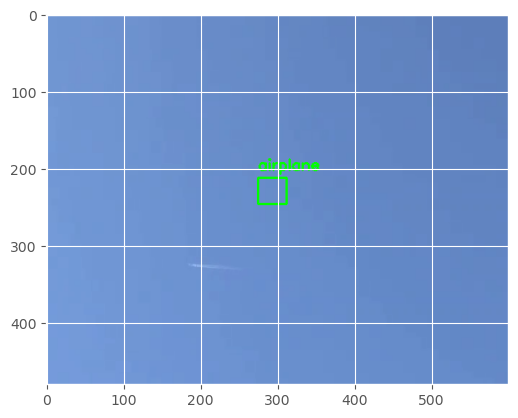

1/1 [==============================] - 0s 288ms/step


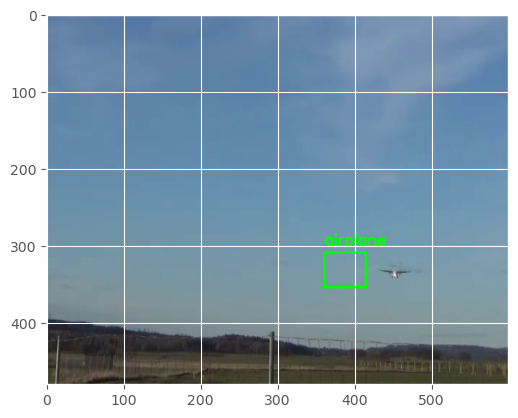

1/1 [==============================] - 0s 290ms/step


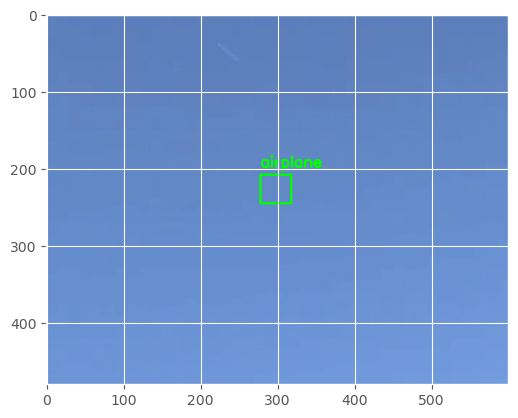

1/1 [==============================] - 0s 295ms/step


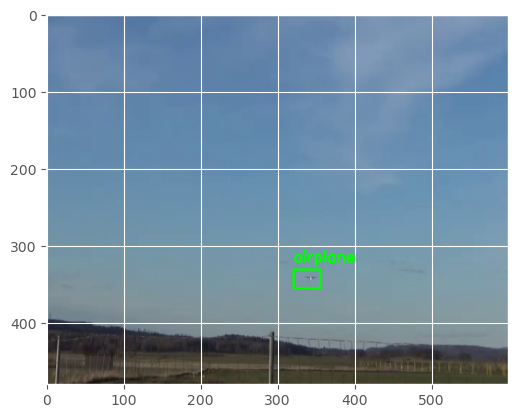

1/1 [==============================] - 0s 290ms/step


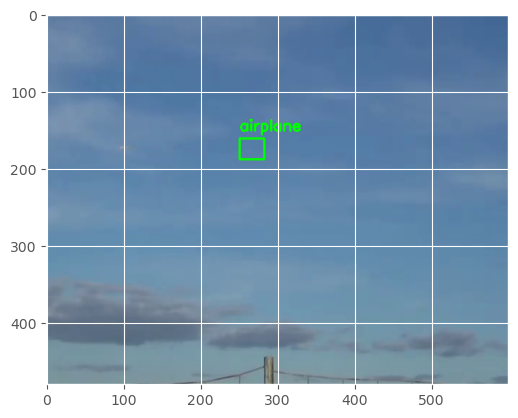

1/1 [==============================] - 0s 287ms/step


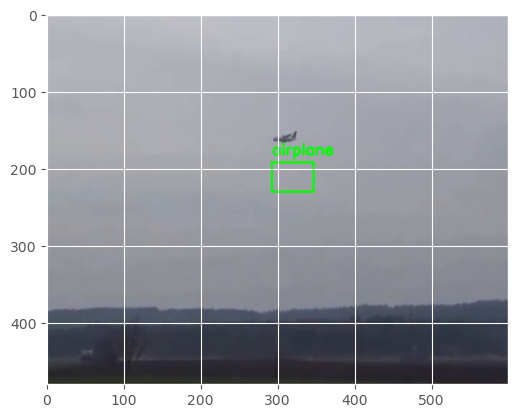

1/1 [==============================] - 0s 290ms/step


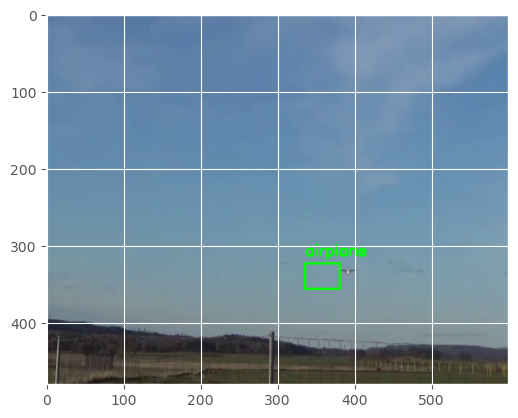

1/1 [==============================] - 0s 289ms/step


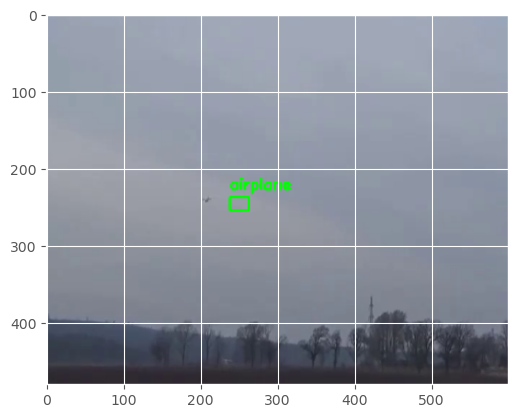

1/1 [==============================] - 0s 288ms/step


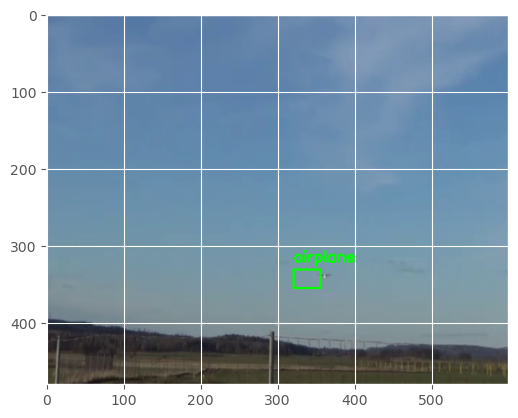

1/1 [==============================] - 0s 302ms/step


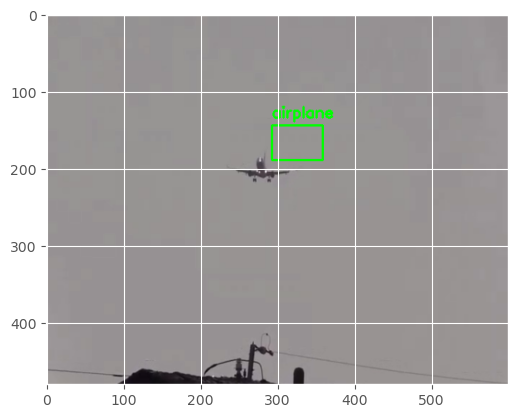

1/1 [==============================] - 0s 285ms/step


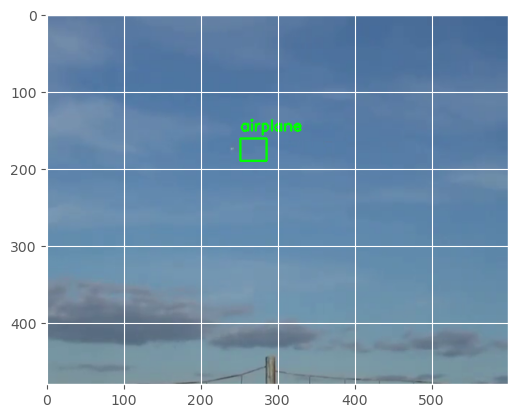

1/1 [==============================] - 0s 292ms/step


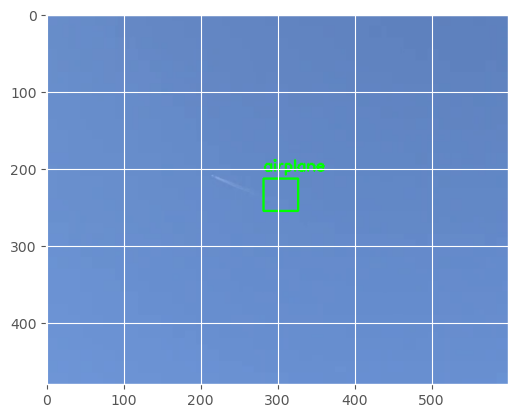

1/1 [==============================] - 0s 297ms/step


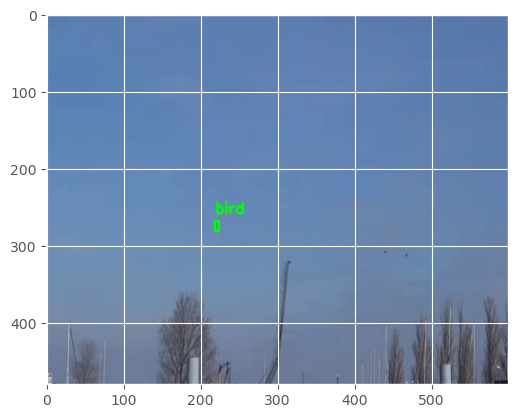

1/1 [==============================] - 0s 286ms/step


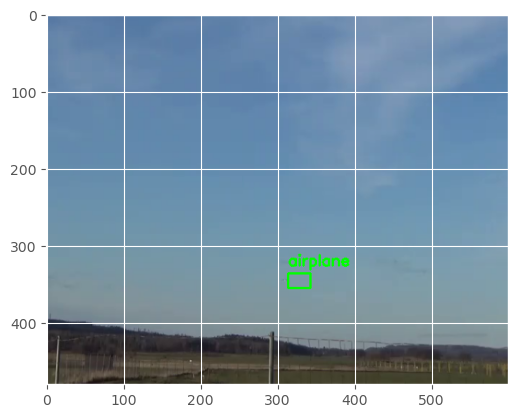

1/1 [==============================] - 0s 291ms/step


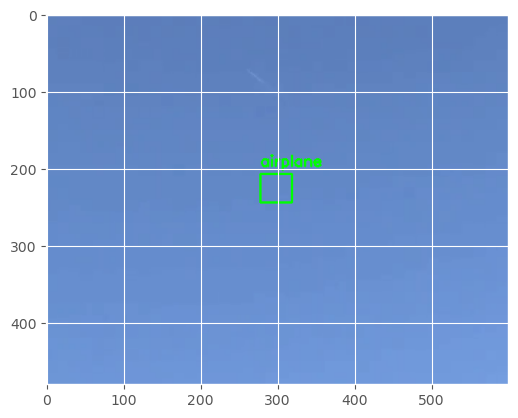

1/1 [==============================] - 0s 289ms/step


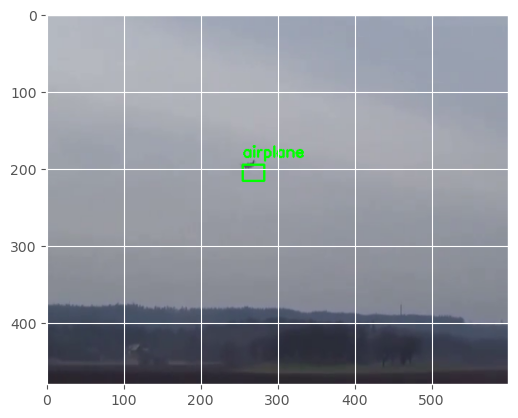

1/1 [==============================] - 0s 292ms/step


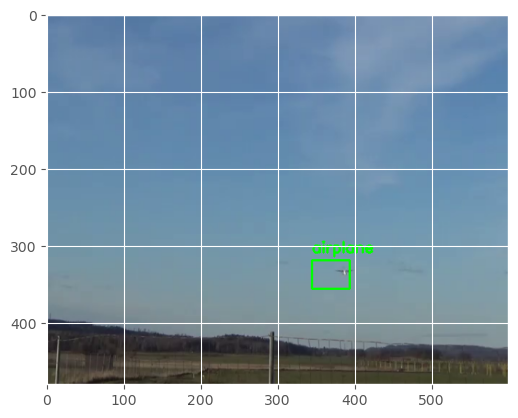

1/1 [==============================] - 0s 290ms/step


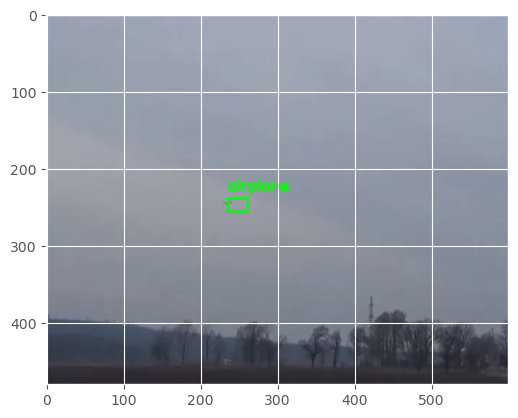

1/1 [==============================] - 0s 292ms/step


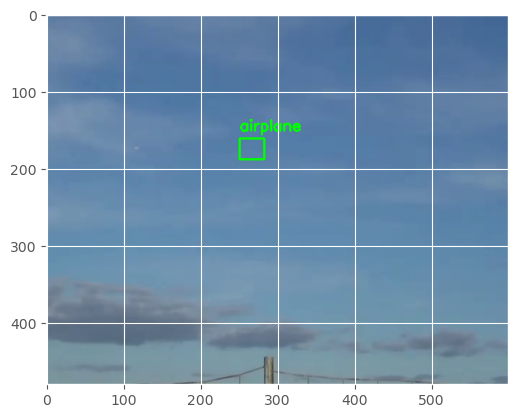

1/1 [==============================] - 0s 289ms/step


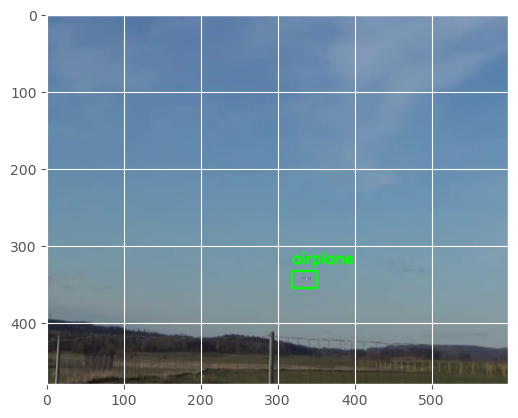

1/1 [==============================] - 0s 290ms/step


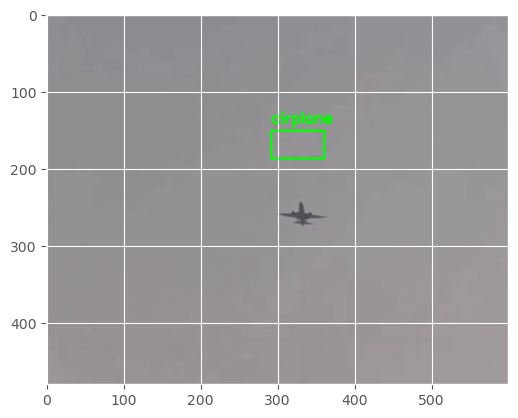

1/1 [==============================] - 0s 291ms/step


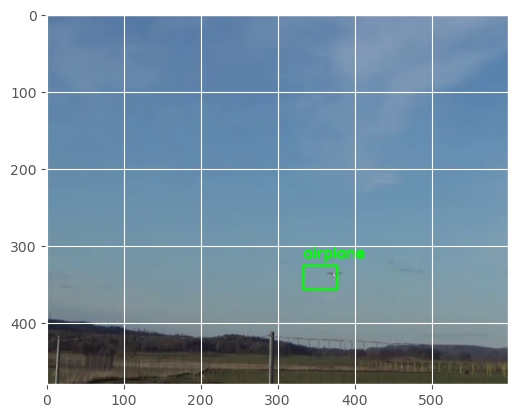

1/1 [==============================] - 0s 293ms/step


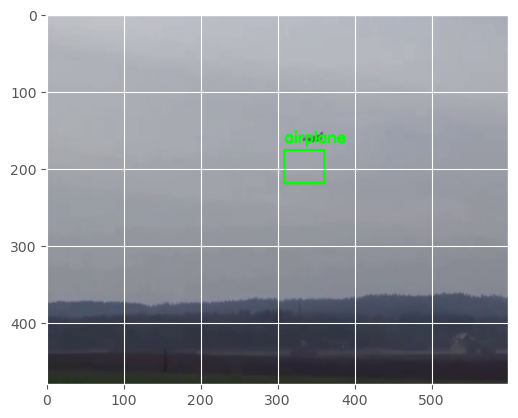

1/1 [==============================] - 0s 291ms/step


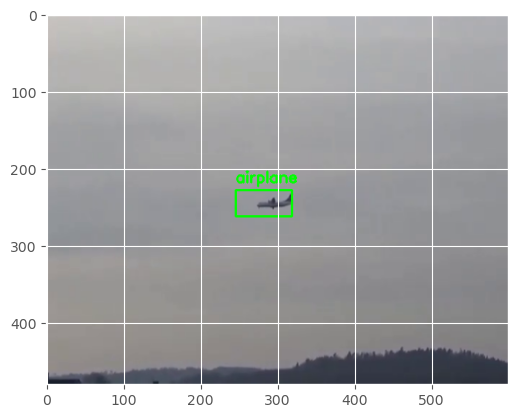

1/1 [==============================] - 0s 289ms/step


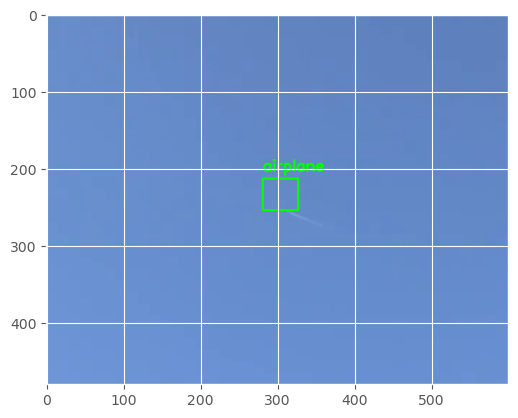

1/1 [==============================] - 0s 292ms/step


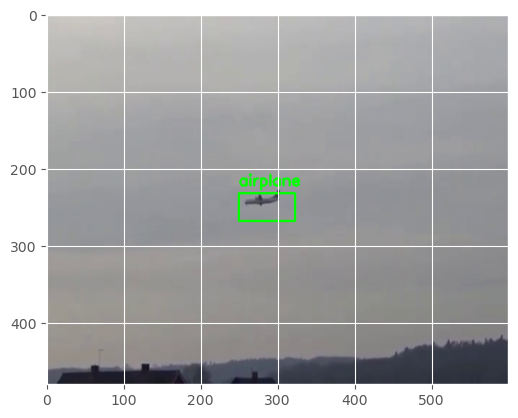

1/1 [==============================] - 0s 291ms/step


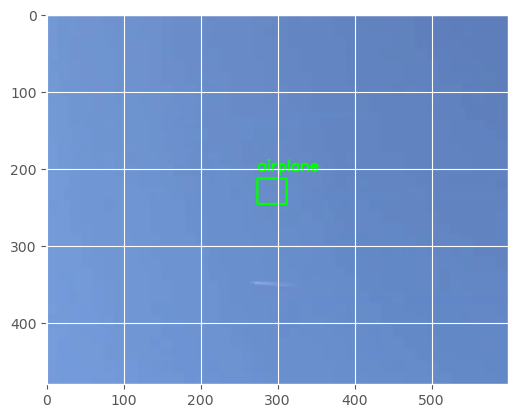

1/1 [==============================] - 0s 290ms/step


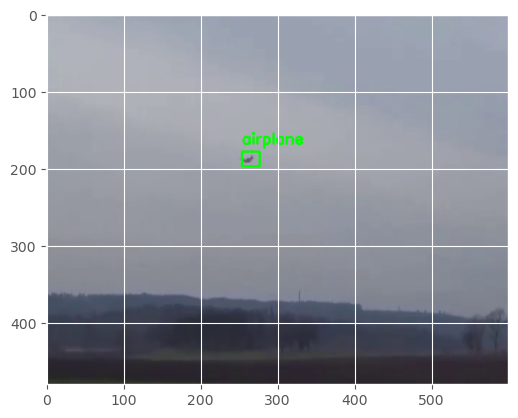

1/1 [==============================] - 0s 290ms/step


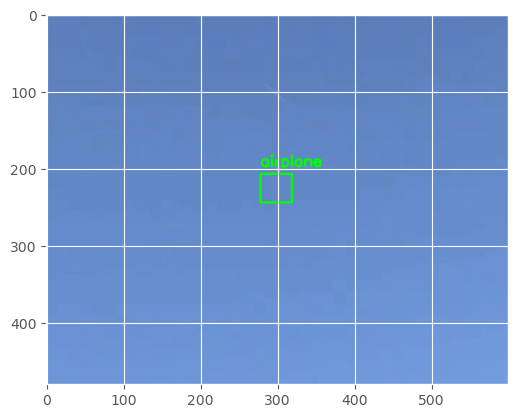

1/1 [==============================] - 0s 291ms/step


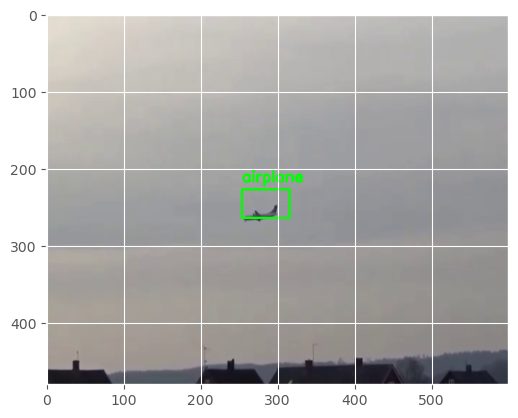

1/1 [==============================] - 0s 295ms/step


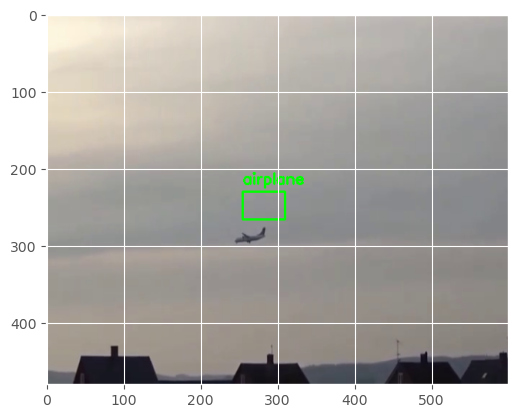

1/1 [==============================] - 0s 289ms/step


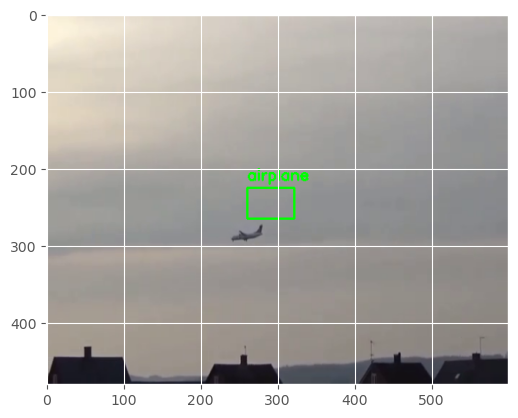

1/1 [==============================] - 0s 290ms/step


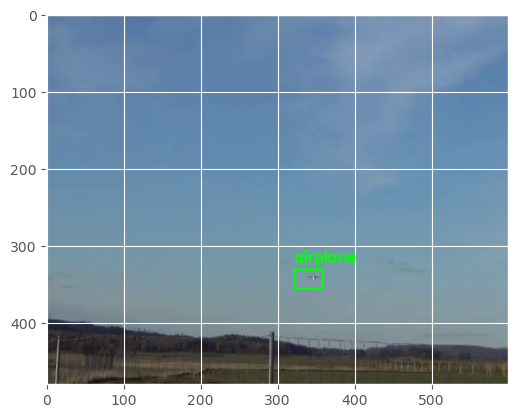

1/1 [==============================] - 0s 323ms/step


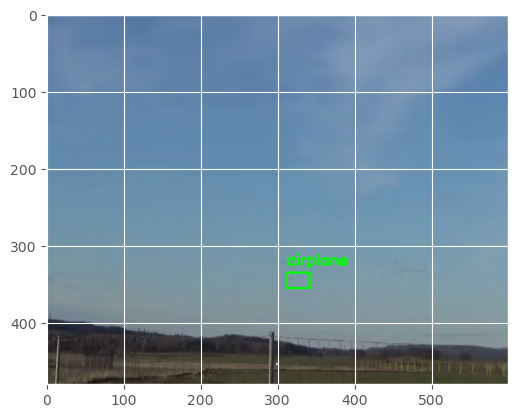

1/1 [==============================] - 0s 291ms/step


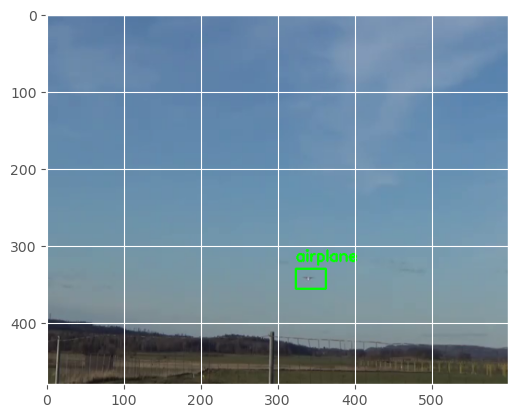

1/1 [==============================] - 0s 289ms/step


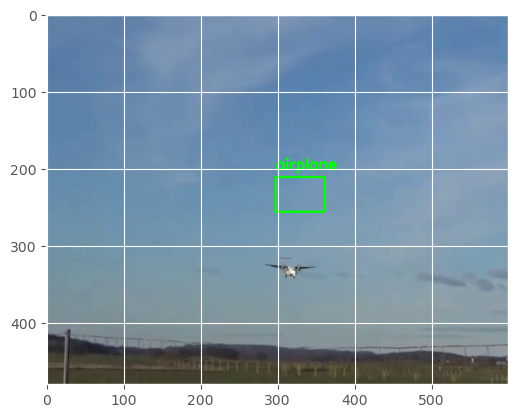

1/1 [==============================] - 0s 288ms/step


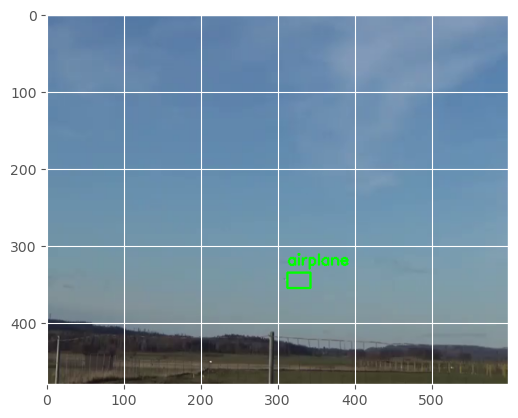

1/1 [==============================] - 0s 293ms/step


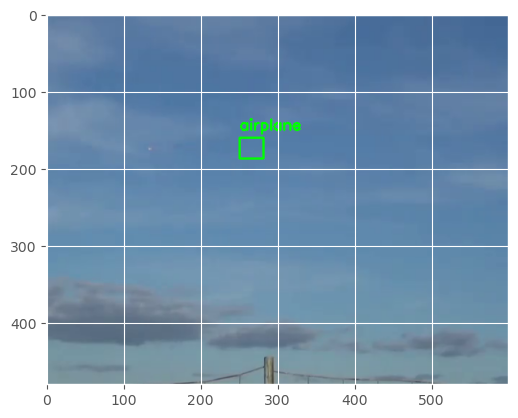

1/1 [==============================] - 0s 288ms/step


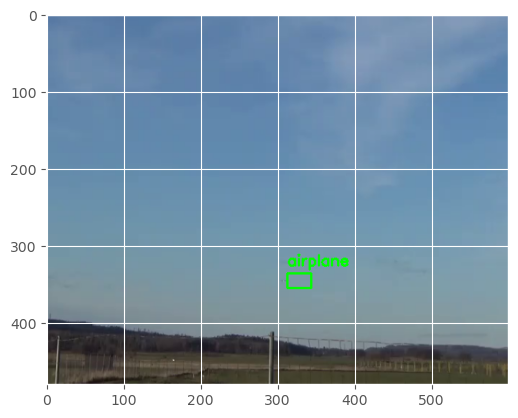

1/1 [==============================] - 0s 391ms/step


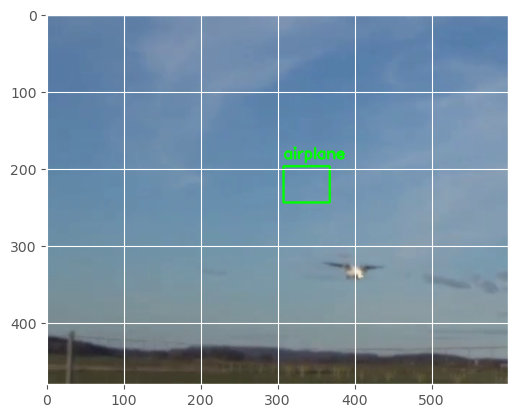

1/1 [==============================] - 0s 379ms/step


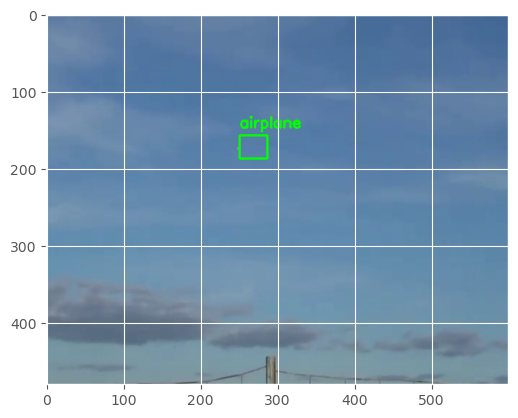

1/1 [==============================] - 0s 290ms/step


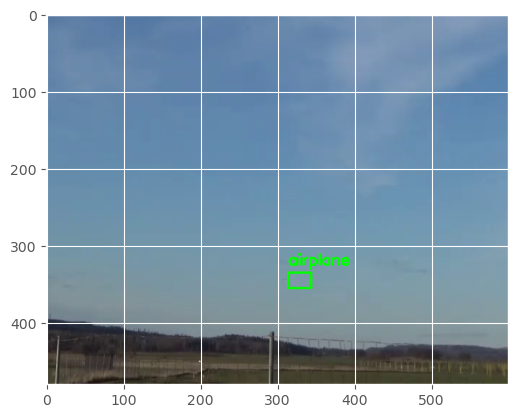

1/1 [==============================] - 0s 288ms/step


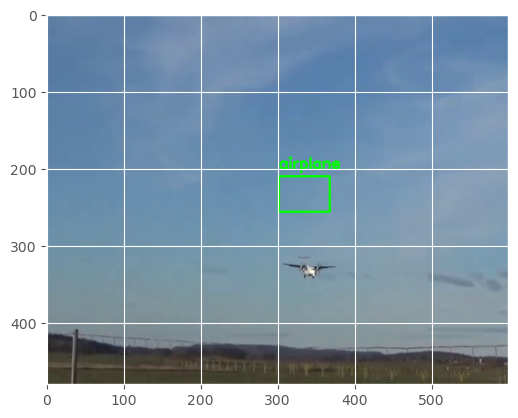

1/1 [==============================] - 0s 289ms/step


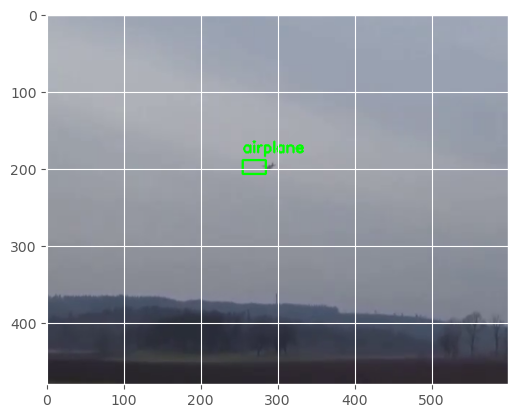

1/1 [==============================] - 0s 290ms/step


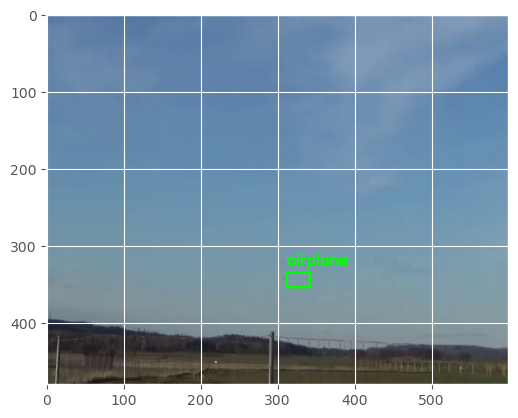

1/1 [==============================] - 0s 297ms/step


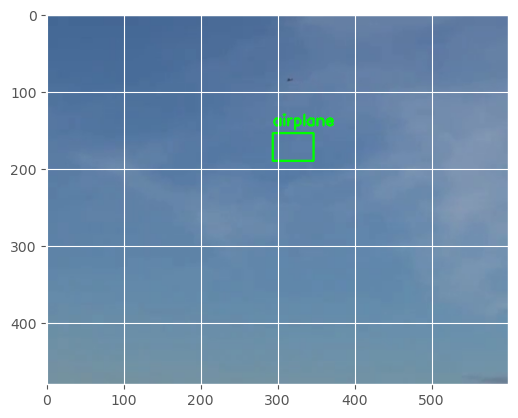

1/1 [==============================] - 0s 292ms/step


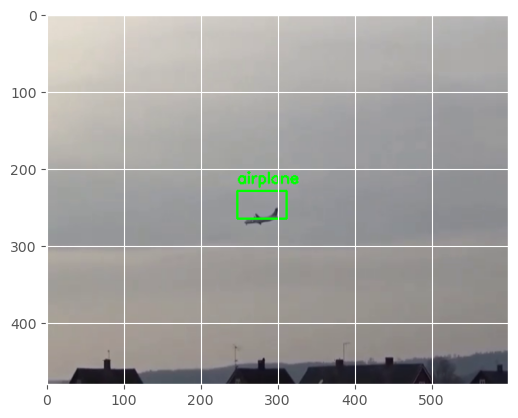

1/1 [==============================] - 0s 291ms/step


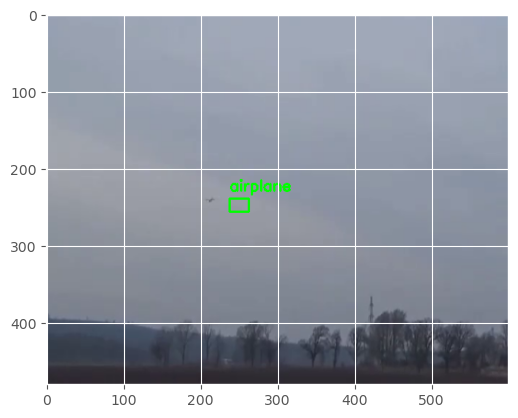

1/1 [==============================] - 0s 290ms/step


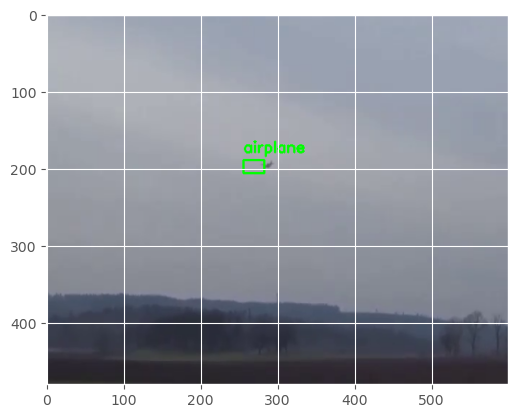

1/1 [==============================] - 0s 293ms/step


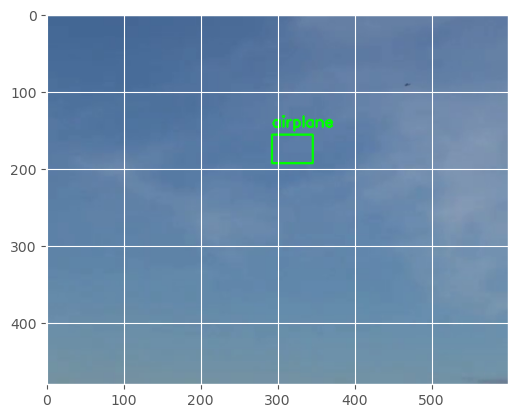

1/1 [==============================] - 0s 330ms/step


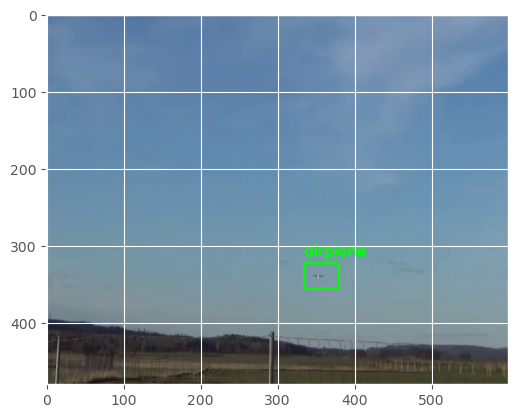

1/1 [==============================] - 0s 290ms/step


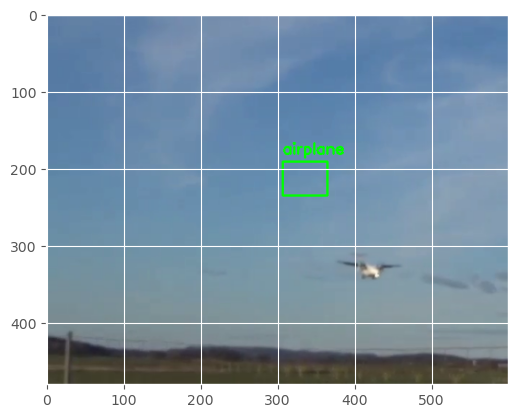

1/1 [==============================] - 0s 294ms/step


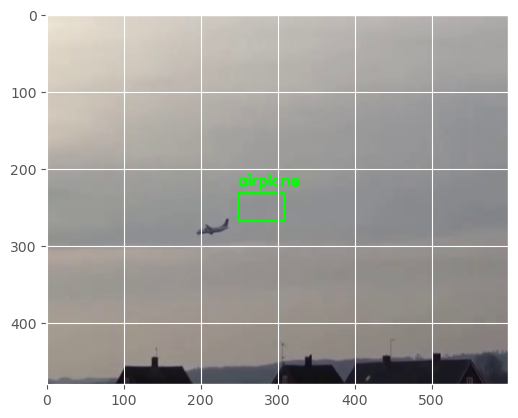

1/1 [==============================] - 0s 284ms/step


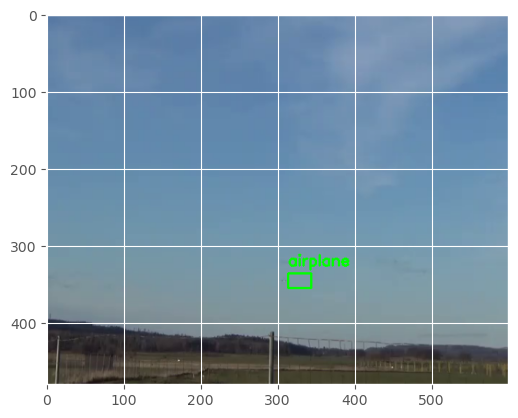

1/1 [==============================] - 0s 288ms/step


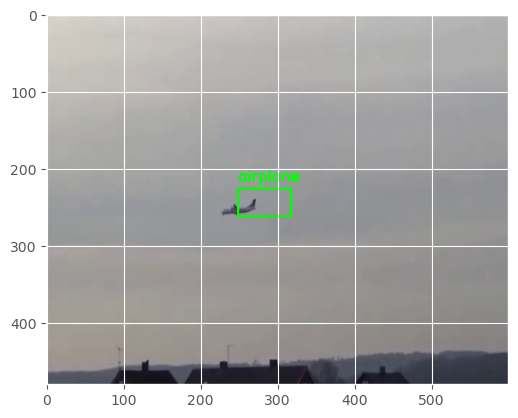

1/1 [==============================] - 0s 286ms/step


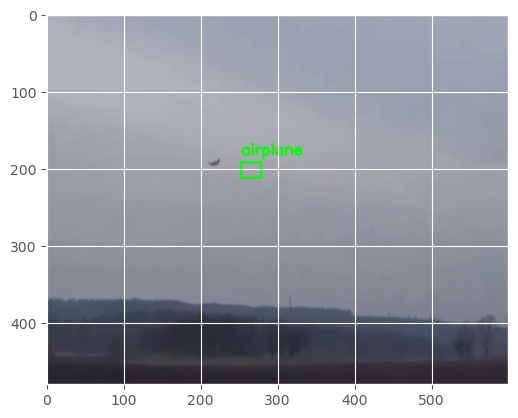

1/1 [==============================] - 0s 293ms/step


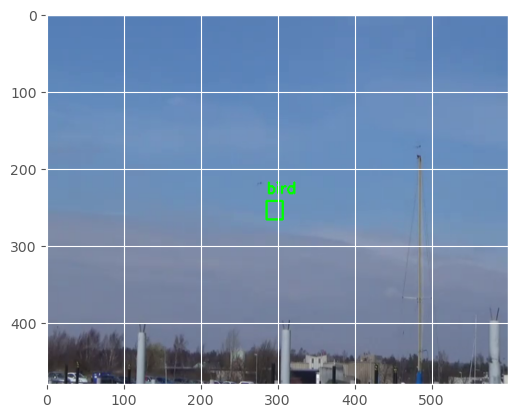

1/1 [==============================] - 0s 291ms/step


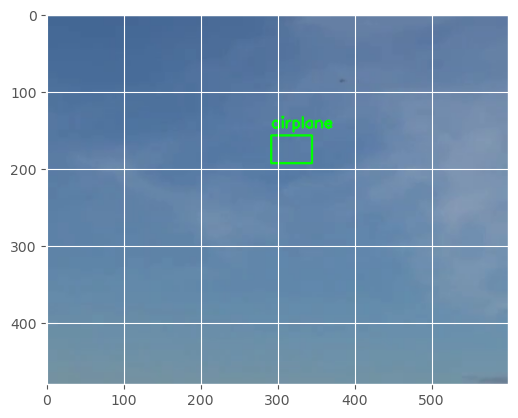

1/1 [==============================] - 0s 292ms/step


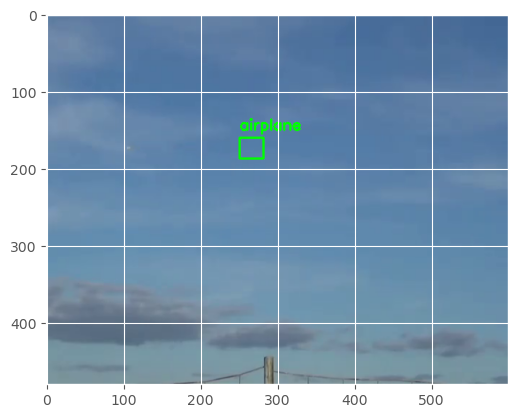

1/1 [==============================] - 0s 292ms/step


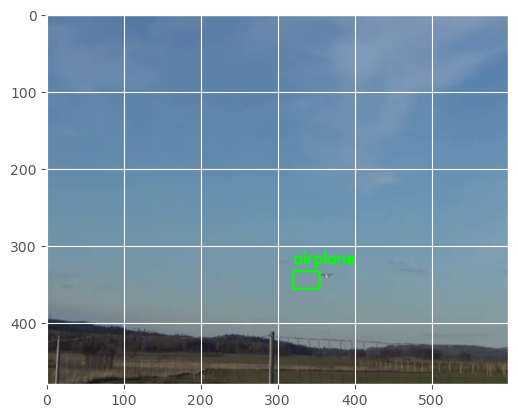

1/1 [==============================] - 0s 285ms/step


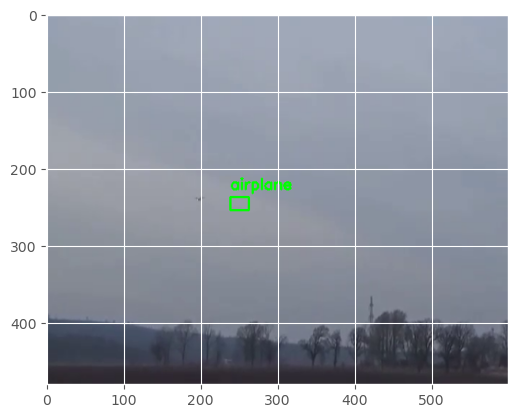

In [158]:
for imagePath in imagePaths:

    # load the input image
    image = load_img(imagePath, target_size=(224, 224))
    image = img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)

    # predict coordinates and classes
    (boxPreds, labelPreds) = model.predict(image)
    (startX, startY, endX, endY) = boxPreds[0]

    # determine the class label 
    # with the largest predicted
    # probability
    i = np.argmax(labelPreds, axis=1)
    label = lb.classes_[i][0]

    # load the input image (in OpenCV format)
    image = cv2.imread(imagePath)
    image = imutils.resize(image, width=600)
    (h, w) = image.shape[:2]

    # scale the predicted bounding box 
    # coordinates based on the image
    # dimensions
    startX = int(startX * w)
    startY = int(startY * h)
    endX = int(endX * w)
    endY = int(endY * h)


    # draw the predicted bounding 
    # box and class label on the image
    y = startY - 10 if startY - 10 > 10 else startY + 10

    cv2.putText(image,
                label,
                (startX, y),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.65,
                (0, 255, 0),
                2)

    cv2.rectangle(image,
                  (startX, startY),
                  (endX, endY),
                  (0, 255, 0),
                  2)


    # show the output image
    imgplot = plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype('uint8'))
    plt.show()

In [ ]:
from tensorflow.keras.models import load_model
import pickle
model = load_model("./model_bbox_regression_and_classification")
lb = pickle.loads(open("./lb.pickle", "rb").read())

In [ ]:
#For test data
test_path = "/kaggle/input/samplepesu/Test_data_images"
testpaths = []
for test_image in os.listdir(test_path):
    testpaths.append(test_path+'/'+test_image)
    
for imagePath in testpaths:

    # load the input image
    image = load_img(imagePath, target_size=(224, 224))
    image = img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)

    # predict coordinates and classes
    (boxPreds, labelPreds) = model.predict(image)
    (startX, startY, endX, endY) = boxPreds[0]

    # determine the class label 
    # with the largest predicted
    # probability
    i = np.argmax(labelPreds, axis=1)
    label = lb.classes_[i][0]

    # load the input image (in OpenCV format)
    image = cv2.imread(imagePath)
    image = imutils.resize(image, width=600)
    (h, w) = image.shape[:2]

    # scale the predicted bounding box 
    # coordinates based on the image
    # dimensions
    startX = int(startX * w)
    startY = int(startY * h)
    endX = int(endX * w)
    endY = int(endY * h)


    # draw the predicted bounding 
    # box and class label on the image
    y = startY - 10 if startY - 10 > 10 else startY + 10

    cv2.putText(image,
                label,
                (startX, y),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.65,
                (0, 255, 0),
                2)

    cv2.rectangle(image,
                  (startX, startY),
                  (endX, endY),
                  (0, 255, 0),
                  2)


    # show the output image
    imgplot = plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype('uint8'))
    plt.show()